This notebook contains all code used to make my thesis plots.

In [1238]:
from copy import deepcopy
from contextlib import contextmanager

import pandas as pd
import numpy as np
import matplotlib as mpl
from matplotlib.pyplot import cm
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.colors import LogNorm, Normalize
import matplotlib.gridspec as gridspec
from itertools import izip
from matplotlib.ticker import ScalarFormatter, FormatStrFormatter, MultipleLocator
from collections import namedtuple
from IPython.display import IFrame
import functools

%matplotlib inline

get_ipython().magic(u'load_ext autoreload')
get_ipython().magic(u'autoreload 2')


mpl.rcParams['font.size'] = 18
mpl.rcParams['figure.figsize'] = (7.0, 4.0)  # default size of plots
mpl.rcParams['axes.labelsize'] = 22
mpl.rcParams['xtick.labelsize'] = 16
mpl.rcParams['ytick.labelsize'] = 16
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['xtick.minor.size'] = 5
mpl.rcParams['ytick.minor.size'] = 5
mpl.rcParams['legend.framealpha'] = 0.6
mpl.rcParams['legend.scatterpoints'] = 1
mpl.rcParams['legend.numpoints'] = 1
# mpl.rcParams.update({'font.size': 24, 'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})
mpl.rcParams.update({'font.family': 'STIXGeneral', 'mathtext.fontset': 'stix'})
pd.set_option('display.max_colwidth', 120)
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 500)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [1493]:
from common_plots import *

In [1569]:
from common_strings import *

In [207]:
# Make subsets based on masses, and passing ALL NMSSMTools constraints (i.e. don't ignore g-2 and relic density)
from make_hdf5 import subset_var

In [4]:
# Here get your dataframes.
# Extract dataframes from binary
store = pd.HDFStore("points_500_MICRO_SCAN_NTv493_HBv431_HSv140_smallMa1_DMass2_fixAssignMass_07_Jul_16_1542.h5")
# df_orig = store.full12loop_all
df_pass_all_1 = store.full12loop_good_posMuMagMom_planckUpperOnly_ignorebctaunu_ignorechi2 #'relaxed' constraints - +ve g-2 and omegah^2

store.close()

In [5]:
# Here get your dataframes.
# Extract dataframes from binary
store = pd.HDFStore("points_500_MICRO_SCAN_NTv493_HBv431_HSv140_smallMa1_DMass2_fixAssignMass_09_Jul_16_0907.h5")
# df_orig = store.full12loop_all
df_pass_all_2 = store.full12loop_good_posMuMagMom_planckUpperOnly_ignorebctaunu_ignorechi2 #'relaxed' constraints - +ve g-2 and omegah^2

store.close()

In [6]:
df_pass_all = pd.concat([df_pass_all_1, df_pass_all_2])

Helper functions for saving plots with different backends easily:

In [7]:
def get_backend():
    return list(get_ipython().magic(u"config InlineBackend.figure_formats"))

def set_backend(fmt):
    print 'Setting backend', fmt
    get_ipython().magic(u"config InlineBackend.figure_formats = '%s', " % fmt)

@contextmanager
def backend(fmt):
    old_fmt = get_backend()[0]
    set_backend(fmt)
    yield
#     set_backend(old_fmt)
    set_backend('png')

def save_fig(func):
    """Decorator func for easily saving plots in jupyter notebook.
    
    Just add in a filename=XXX to your normal function arguments.
    It will auto switch backends correctly.
    """
    def wrapper(*args, **kwargs):
        filename = kwargs['filename']
        if filename == '':
            raise IOError('No filename')
        if '.' not in filename:
            raise IOError('No extension in filename: %s' % filename)
        fmt = os.path.splitext(filename)[1].lstrip('.') if SAVE_PLOTS else 'png'
        with backend(fmt):
            new_kwargs = deepcopy(kwargs)
            del new_kwargs['filename']
            func(*args, **new_kwargs)
            if SAVE_PLOTS: 
                save_plot(filename)
    return wrapper


In [8]:
SAVE_PLOTS = True

if SAVE_PLOTS:
    set_backend('png')
    mpl.rcParams['savefig.dpi'] = 100
else:
    set_backend('png')
    mpl.rcParams['savefig.dpi'] = 72

Setting backend png


In [9]:
df_pass_all_ma1 = subset_var(df_pass_all, 3.5, 10.5, 'ma1')

In [10]:
title = ''
SIZE = 15

Make it easier to choose optional constraints:

# Optional constraint flags 

In [ ]:
def add_constraint_flags(df):
    accept_constraints = {
            "pass_del_a_mu": r"Muon magn\. mom\. more than 2 sigma away",
            "pass_relic": r"Relic density too small \(Planck\)",
            "pass_bctaunu": r"b \-> c tau nu more than 2 sigma away \(as SM\)",
            "pass_chi2zz": r"chi2\(H\->ZZ\) > 6\.18",
            "pass_chi2bb": r"chi2\(H\->bb\) > 6\.18",
            "pass_chi2gg": r"chi2\(H\->gg\) > 6\.18"
    }

    for k, v in accept_constraints.iteritems():
        if k not in df.columns:
            df[k] = ~df.constraints.str.contains(v)

    df['pass_HSHB'] = (df.HSprob > 0.05) & (df.HBresult==1)
    df['pass_NT'] = (df.pass_chi2zz) & (df.pass_chi2bb) & (df.pass_chi2gg)
    df['pass_strict'] = (df.passHSHB) & (df.pass_NT) & (df.pass_del_a_mu) & (df.pass_relic)

In [ ]:
add_constraint_flags(df_pass_all)

In [ ]:
df_pass_all[accept_constraints.keys() + ['constraints', 'pass_strict']].head(10)

# Add new constraints

In [125]:
atlas = pd.read_csv('Exp_limits/ATLAS_HIGG_2014_02_full.csv')
atlas_dict = {k:v for k, v in zip(atlas.m_a.values, atlas.xsec_br_4tau.values)}

cms_tau_19 = pd.read_csv('Exp_limits/CMS_HIG_14_019_full.csv')
cms_19_dict = {k:v for k, v in zip(cms_tau_19.m_a.values, cms_tau_19.xsec_br_4tau.values)}

cms_tau_22 = pd.read_csv('Exp_limits/CMS_HIG_14_022_full.csv')
cms_22_dict = {k:v for k, v in zip(cms_tau_22.m_a.values, cms_tau_22.xsec_br_4tau.values)}

In [1631]:
def apply_new_constraints(df):
    df['pass_limits_xsec_8_ggf_h1_2a1_4tau'] = df.apply(lambda x: (pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, atlas_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, cms_19_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h1_2a1_4tau, cms_22_dict)), 
                                                        axis=1)
    df['pass_limits_xsec_8_ggf_h2_2a1_4tau'] = df.apply(lambda x: (pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, atlas_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, cms_19_dict) 
                                                                   and pass_limit(x.ma1, x.xsec_8_ggf_h2_2a1_4tau, cms_22_dict)), 
                                                        axis=1)

In [1632]:
apply_new_constraints(df_pass_all)

KeyboardInterrupt: 

# Higgs Masses vs Input Params

##  a1

In [1609]:
@save_fig
def plot_ma1_inputparams_multiple(df, title):
    dfs = [df, 
           df.query('HSprob>0.05 & HBresult==1'), 
           df[~df.constraints.str.contains('chi2')], 
           df[df.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
           df_pass_all_ma1[df_pass_all_ma1.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('pass_limits_xsec_8_ggf_h1_2a1_4tau')]

    plot_input_params_scatters_multiple(dfs, 'ma1', r'$m_{a_1}\ \mathrm{[GeV]}$', 
                                        yrange=[0, 20], title=title, cols=3,
                                        param_dict=nmssm_params_extended,
                                        kwargs=[
                                            {'color':'green', 's': SIZE, 'label': 'Relaxed'},
                                            {'color':'magenta', 'marker': 'v', 's': SIZE, 'label': 'Pass HS+HB'},
                                            {'alpha':0.75, 'color':'dodgerblue', 'marker': 'd', 's': SIZE, 'label': 'Pass NT Higgs '+r'$\chi^2$'},
                                            {'alpha':0.5, 'color':'red', 'marker':'s', 's': SIZE, 'label': 'All NT constraints'},
                                            {'alpha':0.5, 'color':'orange', 'marker':'o', 's': SIZE, 'label': 'All NT constraints + new'}])
    plt.gcf().axes[0].legend(loc='upper center', ncol=len(dfs), bbox_to_anchor=(1.75, 1.25))

Setting backend png
Setting backend png


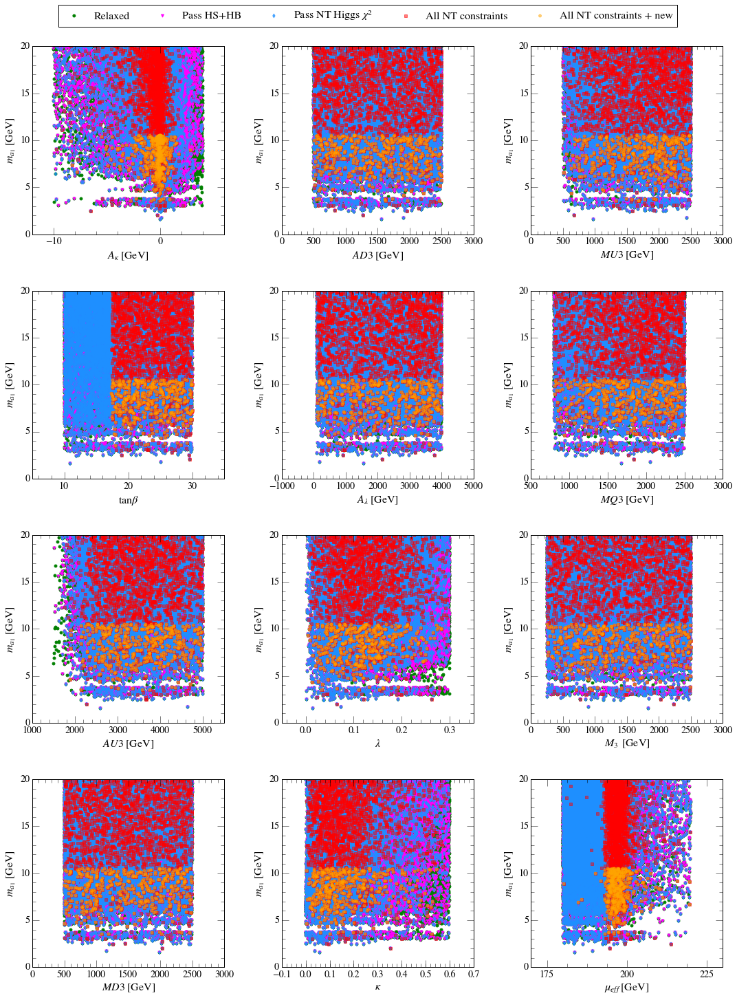

In [1610]:
plot_ma1_inputparams_multiple(df_pass_all, '', filename='Thesis_plots_4/Masses/ma1_inputparams_multiple.png')

In [784]:
@save_fig
def plot_ma1_inputparams(df, title):
    plot_input_params_scatters(df, 'ma1', r'$m_{a_1}\ \mathrm{[GeV]}$', 
                               yrange=[0, 20], title=title, cols=2, s=SIZE, alpha=0.5)

Setting backend png
Setting backend png


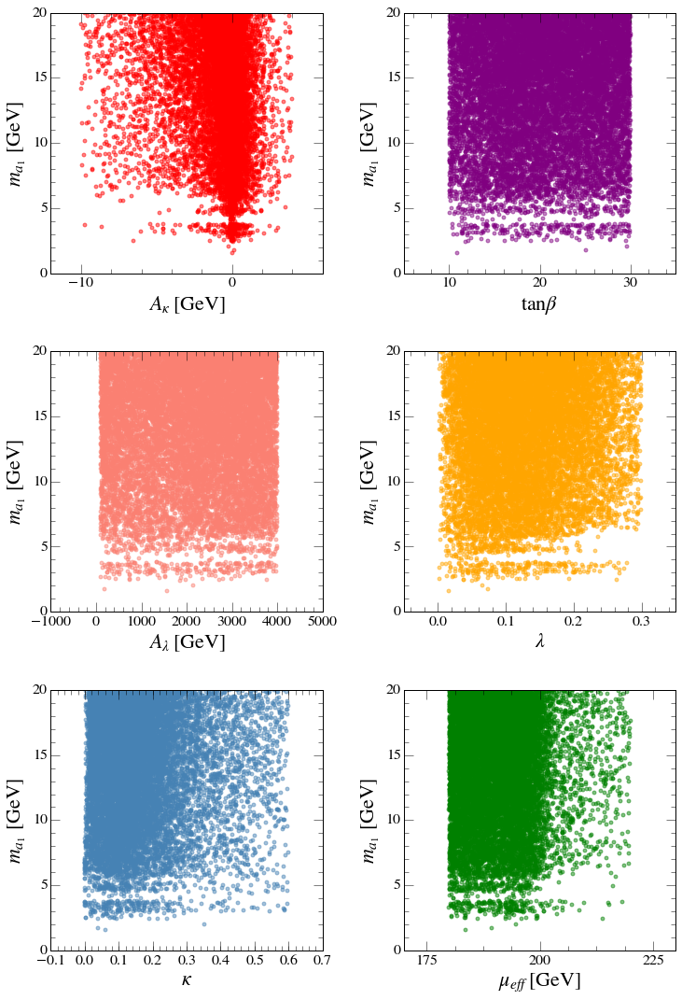

In [785]:
plot_ma1_inputparams(df_pass_all[~df_pass_all.constraints.str.contains('chi2')].query('HSprob>0.05 & HBresult==1'), 
                     title, filename='Thesis_plots_4/Masses/ma1_inputparams_relaxed.png')

Setting backend png
Setting backend png


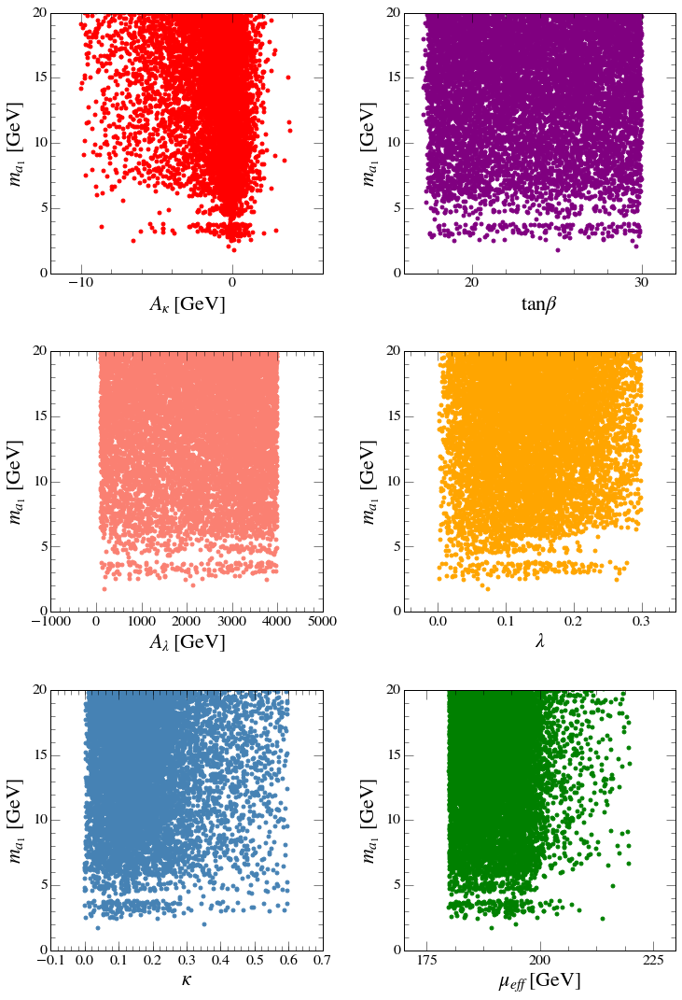

In [751]:
plot_ma1_inputparams(df_pass_all[(~df_pass_all.constraints.str.contains('chi2')) & (~df_pass_all.constraints.str.contains('Muon'))].query('HSprob>0.05 & HBresult==1'), 
                     title, filename='Thesis_plots_4/Masses/ma1_inputparams_relaxed_muon.png')

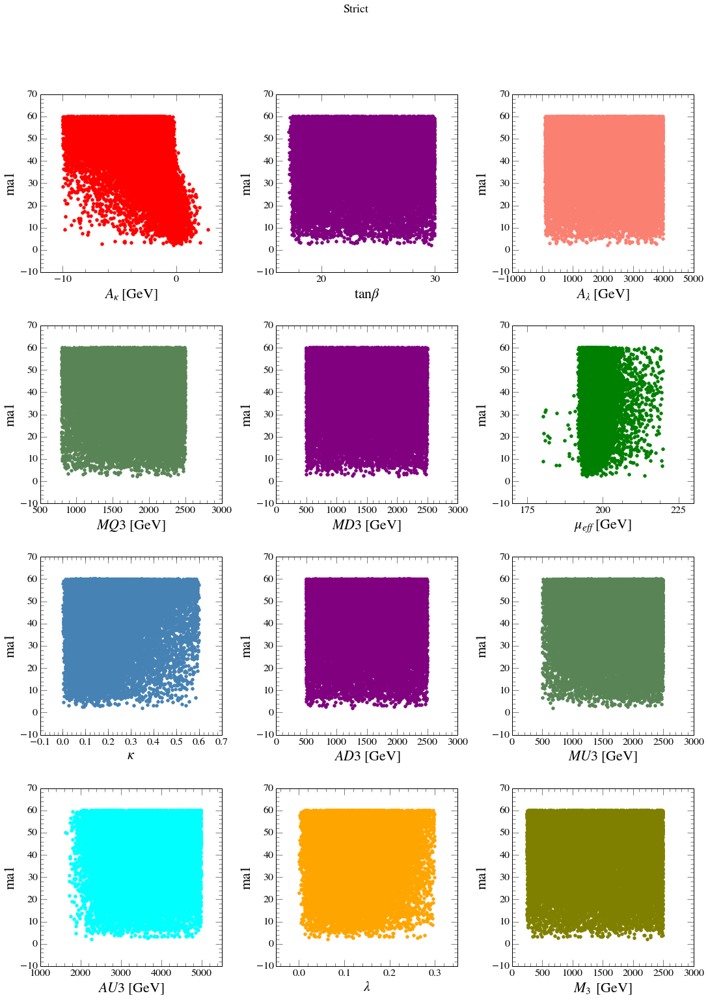

In [752]:
plot_input_params_scatters(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                           ylabel='ma1', title='Strict', yvar='ma1', param_dict=nmssm_params_extended)

Setting backend png
Setting backend png


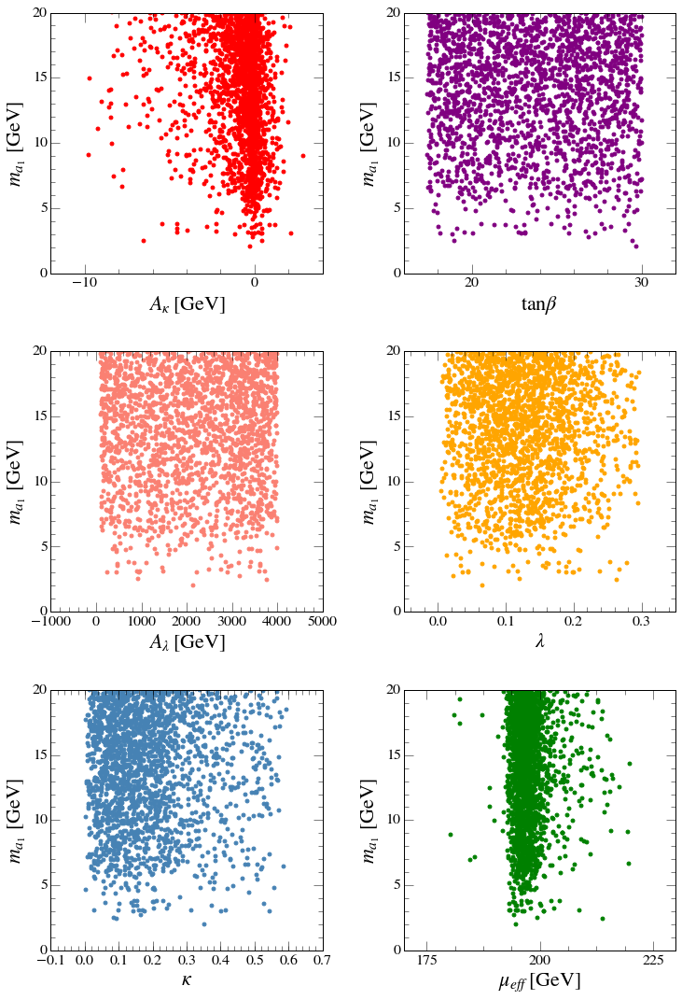

In [753]:
plot_ma1_inputparams(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                     title, filename='Thesis_plots_4/Masses/ma1_inputparams_strict.png')

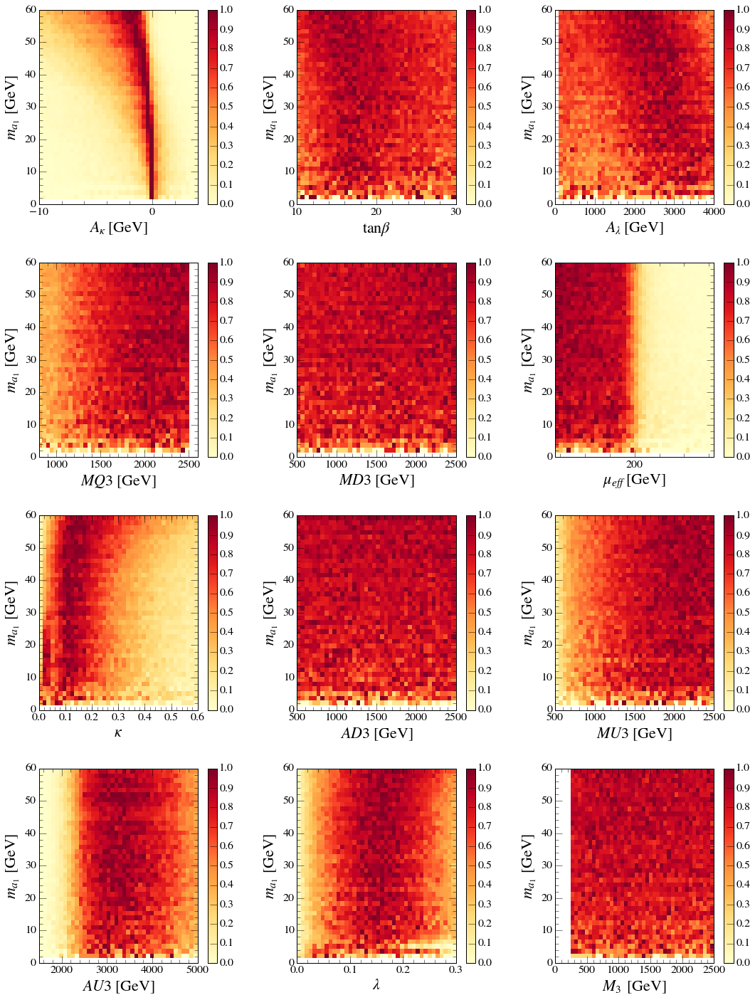

In [754]:
plot_input_params_hist2d(df=df_pass_all.query('HSprob>0.05 & HBresult==1'), 
# plot_input_params_hist2d(df=df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                         yvar='ma1',
                         ylabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                         param_dict=nmssm_params_extended,
                         cmap='YlOrRd', norm_axis='y',
#                          norm=LogNorm(vmin=1E-3), 
#                          norm=Normalize(vmin=0, vmax=1), 
                         bins=[40,40])


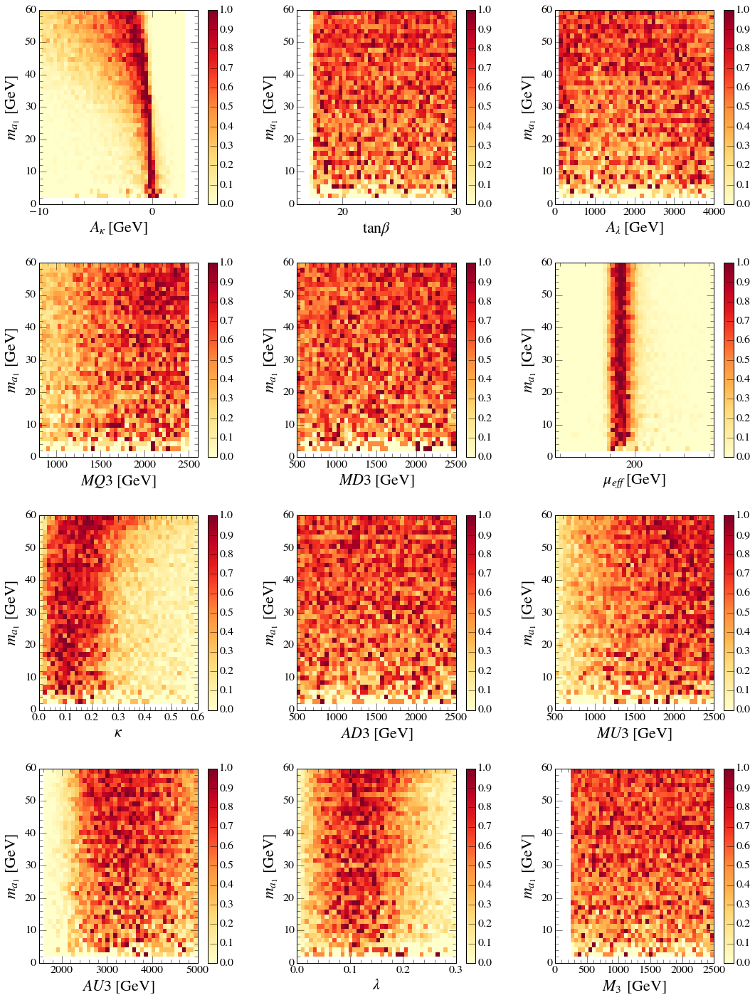

In [755]:
# plot_input_params_hist2d(df=df.query('HSprob>0.05 & HBresult==1'), 
plot_input_params_hist2d(df=df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                         yvar='ma1',
                         ylabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                         param_dict=nmssm_params_extended,
                         cmap='YlOrRd', norm_axis='y',
#                          norm=LogNorm(vmin=1E-3), 
#                          norm=Normalize(vmin=0, vmax=1), 
                         bins=[40,40])


In [772]:
@save_fig
def plot_ma1_akappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='akappa', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=r'$A_{\kappa}$', ylabel=M_A1_STR)

Setting backend png
Setting backend png


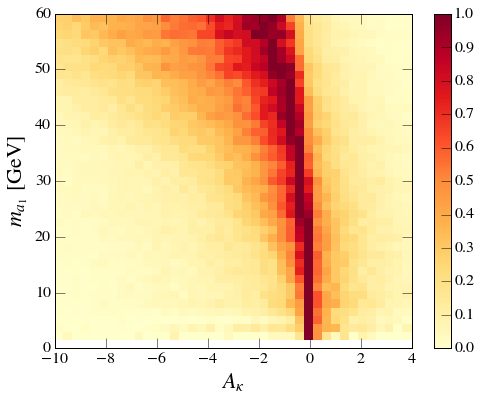

In [773]:
plot_ma1_akappa_hist2d(df_pass_all, filename='Thesis_plots_4/Masses/ma1_akappa_hist2d.png')

In [801]:
@save_fig
def plot_ma1_tgbeta_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='tgbeta', yvar='ma1', 
                         bins=[30, 30],  norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
#                          norm=LogNorm(),
                         xlabel=TGBETA_STR, ylabel=M_A1_STR, vmin=0)
    

Setting backend png
Setting backend png


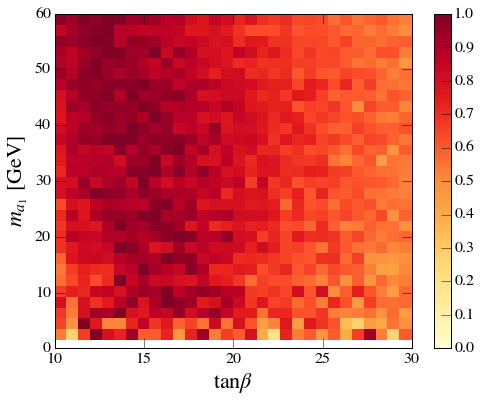

In [802]:
plot_ma1_tgbeta_hist2d(df_pass_all, filename='Thesis_plots_4/Masses/ma1_tgbeta_hist2d.png')

In [779]:
@save_fig
def plot_ma1_kappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='kappa', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=KAPPA_STR, ylabel=M_A1_STR)

Setting backend png
Setting backend png


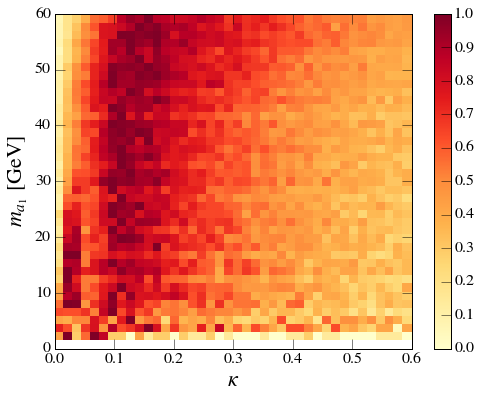

In [780]:
plot_ma1_kappa_hist2d(df_pass_all, filename='Thesis_plots_4/Masses/ma1_kappa_hist2d.png')

In [782]:
@save_fig
def plot_ma1_lambda_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='lambda_', yvar='ma1', 
                         bins=[40, 40], norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
    #                      norm=LogNorm(),
                         xlabel=LAMBDA_STR, ylabel=M_A1_STR)

Setting backend png
Setting backend png


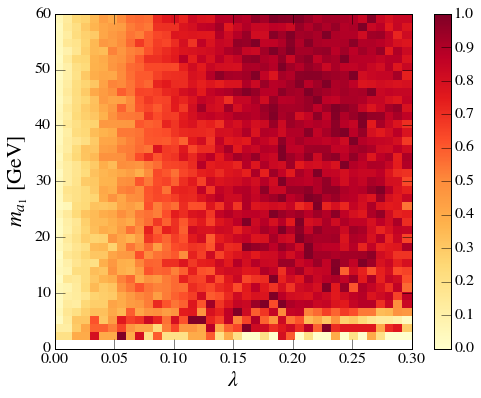

In [783]:
plot_ma1_lambda_hist2d(df_pass_all, filename='Thesis_plots_4/Masses/ma1_lambda_hist2d.png')

## h1

In [18]:
@save_fig
def plot_mh1_inputparams(df, title, yrange=[0, 150]):
    plot_input_params_scatters(df, 'mh1', r'$m_{h_1}\ \mathrm{[GeV]}$', 
                               yrange=yrange, 
                               title=title, cols=2, s=SIZE)

Setting backend png
Setting backend png


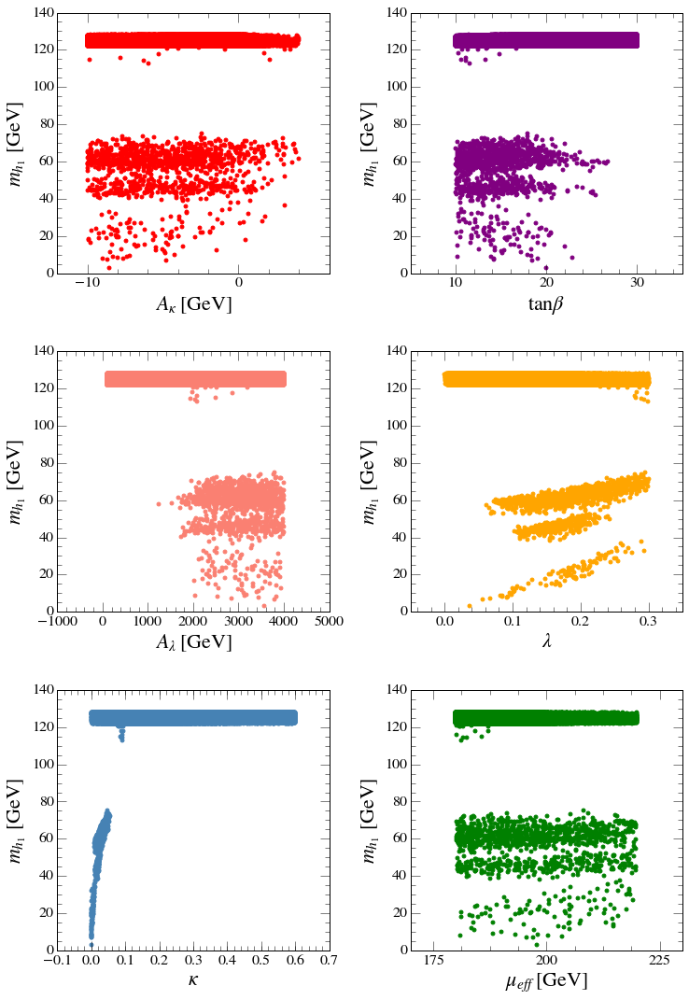

In [756]:
plot_mh1_inputparams(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], 
                     title, filename='Thesis_plots_4/Masses/mh1_inputparams_relaxed_h125.png', yrange=[0, 140])

Setting backend png
Setting backend png


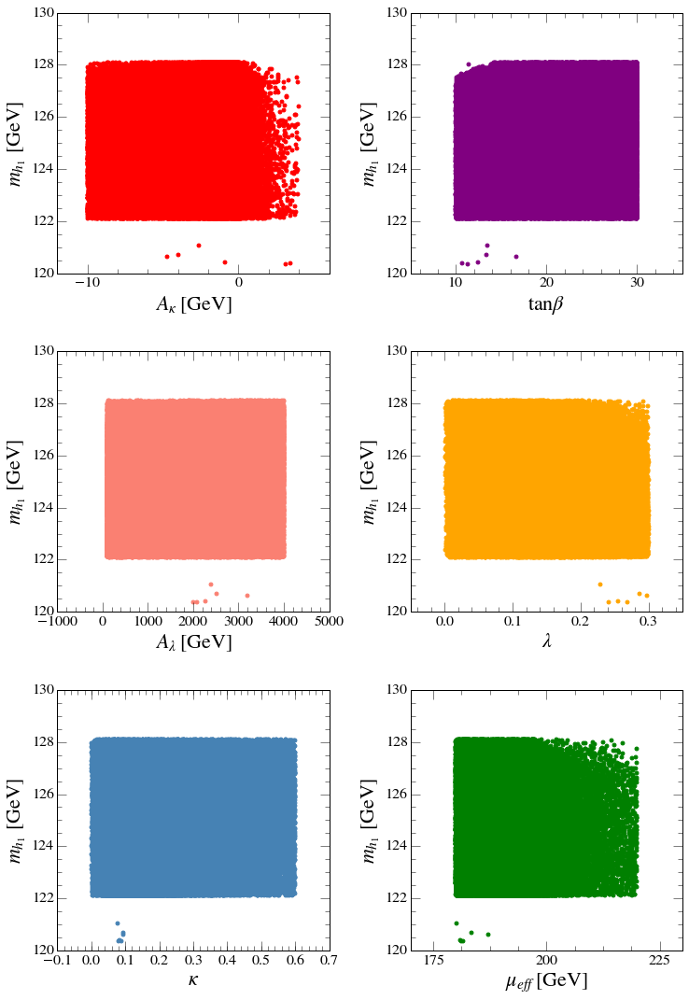

In [757]:
plot_mh1_inputparams(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], 
                     title, filename='Thesis_plots_4/Masses/mh1_inputparams_relaxed.png', yrange=[120,130])

In [895]:
@save_fig
def plot_mh1_input_hist2d(df, vars=None):
    plist = vars or nmssm_params_extended.keys()
    custom_dict = {k:v for k, v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_hist2d(df=df, 
                             yvar='mh1',
                             ylabel=M_H1_STR, 
                             param_dict=custom_dict,
                             norm_axis='y',
                             cmap='YlOrRd',
#                              norm=LogNorm(), 
                             bins=[30, 30])


Setting backend png
Setting backend png


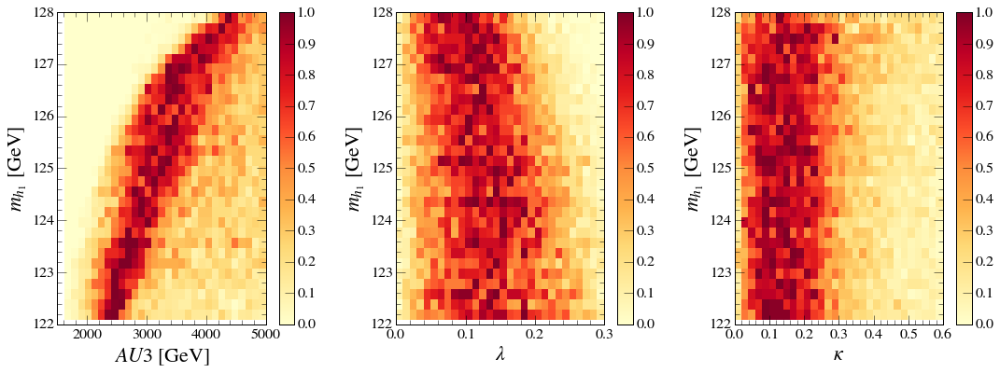

In [896]:
plot_mh1_input_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('122<mh1<128'),
# plot_mh1_input_hist2d(df_pass_all.query('122<mh1<128'),
                      vars=['au3', 'lambda_', 'kappa'],
                      filename='Thesis_plots_4/Masses/mh1_input_hist2d.png')

In [855]:
@save_fig
def plot_mh1_input_scatter(df, vars=None):
    plist = vars or nmssm_params_extended.keys()
    custom_dict = {k:v for k, v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_scatters(df=df, 
                             yvar='mh1',
                             ylabel=M_H1_STR, alpha=0.1,
                             param_dict=custom_dict)

Setting backend png
Setting backend png


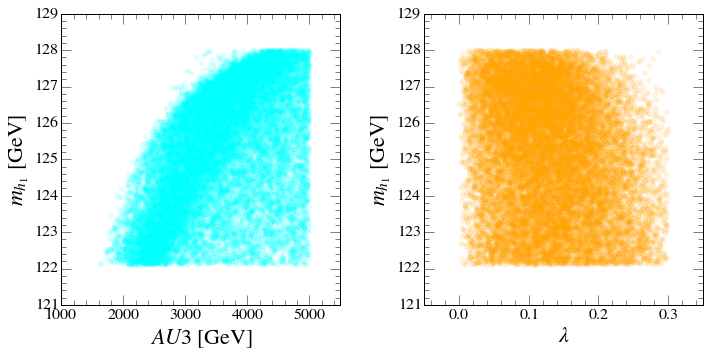

In [856]:
plot_mh1_input_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('122<mh1<128'),
# plot_mh1_input_hist2d(df_pass_all.query('122<mh1<128'),
                      vars=['au3', 'lambda_'],
                      filename='Thesis_plots_4/Masses/mh1_input_scatter.png')

## h2

In [21]:
@save_fig
def plot_mh2_inputparams(df, title):
    plot_input_params_scatters(df, 'mh2', r'$m_{h_2}\ \mathrm{[GeV]}$', 
                               yrange=[120, 140], 
                               title=title, cols=2, s=SIZE)

Setting backend png
Setting backend png


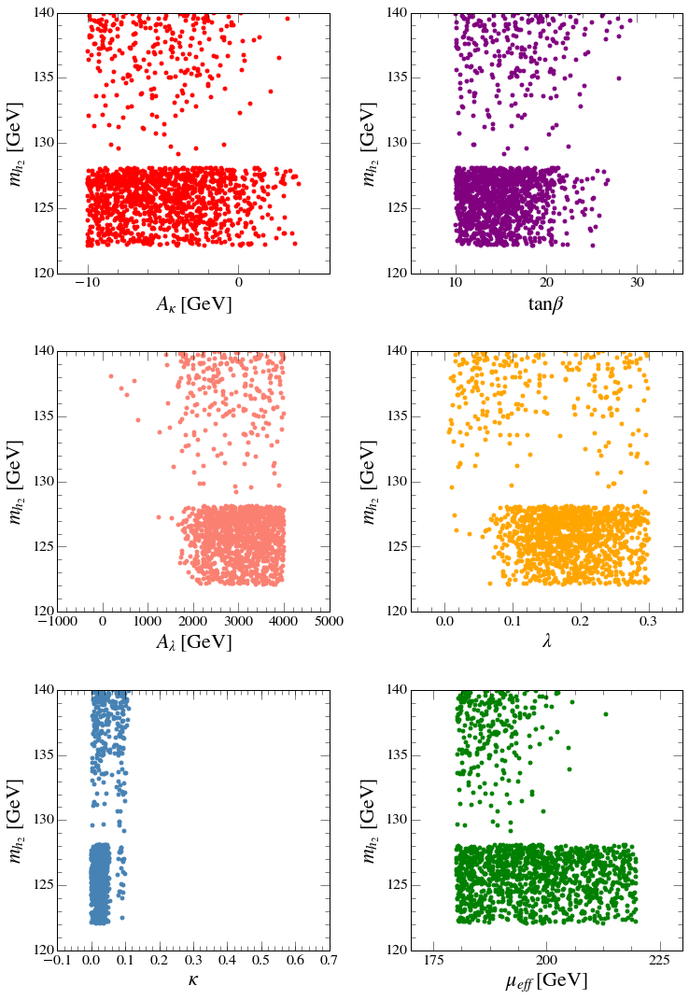

In [759]:
plot_mh2_inputparams(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], 
                     title, filename='Thesis_plots_4/Masses/mh2_inputparams_relaxed.png')

In [23]:
title = ''

In [24]:
@save_fig
def plot_mh1_ma1_scatter(df, title):
    plot_scatter(df=df, xvar='ma1', yvar='mh1', 
                 xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_1}\ \mathrm{[GeV]}$',
                 color='dodgerblue', s=SIZE)
    plt.xlim(0, 60)
    plt.ylim(0, 140)
    plt.title(title)
    
    xmin, xmax = plt.xlim()
    ymin, ymax = xmin, xmax
    plt.plot([xmin, xmax], [ymin, ymax], linestyle='dashed', 
             label=r'$m_{h_1} =\ m_{a_1}$', linewidth=2)

#     plt.plot([xmin, xmax], [2*ymin, 2*ymax], linestyle='dashed', color='red',
#              label=r'$m_{h_1} =\ 2m_{a_1}$', linewidth=2)

#     plt.plot([xmin, xmax], [62.5, 62.5], linestyle='dashed', color='purple',
#              label=r'$m_{h_1} =\ 62.5\ \mathrm{GeV}$', linewidth=2)

    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False,
                          label=r'$125 \pm 3\ \mathrm{GeV}$', hatch='xxx')
    
#     make_highlight_region(plt.gca(), [0, 62.5], 
#                           'Y', color='darkorchid', alpha=0.25, fill=True,
#                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$')

#     poly = patches.Polygon([[0, 0], [60, 0], [60, 62.5], [62.5/2, 62.5]], closed=True, 
    poly = patches.Polygon([[0, 0], [60, 0], [60, 62.5], [0, 62.5]], closed=True, 
                           color='darkorchid', fill=True, hatch='//', 
                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$', alpha=0.25)
    plt.gca().add_patch(poly)
    
    poly2 = patches.Polygon([[0, 0], [62.5/2, 62.5], [0, 62.5]], closed=True, 
                           fill=True, color='red', hatch=r"\\",
                           label=r'$h_2 \to 2h_1 \to 4a_1\ \mathrm{allowed}$', alpha=0.25)
    plt.gca().add_patch(poly2)

#     make_highlight_region(plt.gca(), [0, 62.5], 
#                           'Y', color='purple', alpha=0.2,
#                           label=r'$h_2 \to 2h_1\ \mathrm{allowed}$')

    plt.legend(loc='lower right', frameon=True, bbox_to_anchor=(1,0), framealpha=0.8, fontsize=14)
    plt.tight_layout()


Setting backend png
Setting backend png


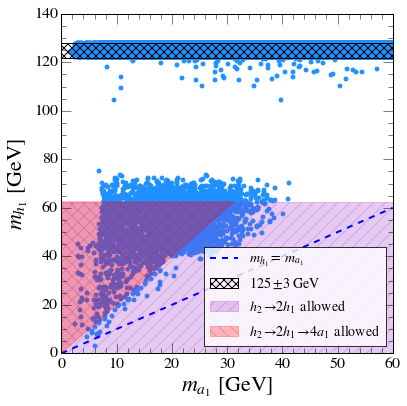

In [911]:
plot_mh1_ma1_scatter(df_pass_all, title, filename='Thesis_plots_4/Masses/mh1_ma1_relaxed.png')

Setting backend png
Setting backend png


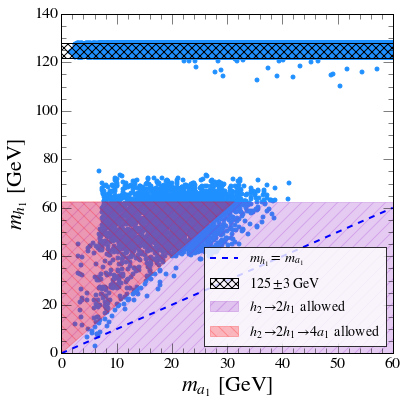

In [904]:
plot_mh1_ma1_scatter(df_pass_all.query('HSprob>0.05 & HBresult==1'), 
                     title, filename='Thesis_plots_4/Masses/mh1_ma1_HSHB.png')

Setting backend png
Setting backend png


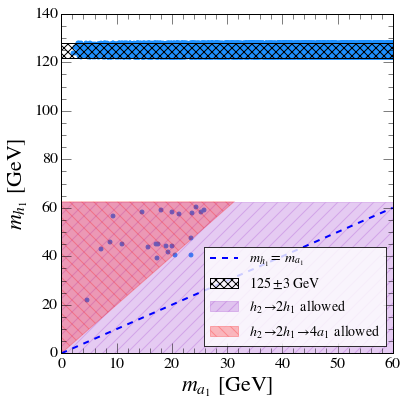

In [910]:
plot_mh1_ma1_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                     title, filename='Thesis_plots_4/Masses/mh1_ma1_strict.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x1332481d0>,
 array([   0.,    0.,    0.,    2.,    7.,   30.,  228.,  151.,   30.,
         205.,  146.,  254.,  417.,  490.,  557.,  586.,  629.,  618.,
         714.,  710.]),
 array([  0. ,   0.5,   1. ,   1.5,   2. ,   2.5,   3. ,   3.5,   4. ,
          4.5,   5. ,   5.5,   6. ,   6.5,   7. ,   7.5,   8. ,   8.5,
          9. ,   9.5,  10. ]),
 <a list of 20 Patch objects>)

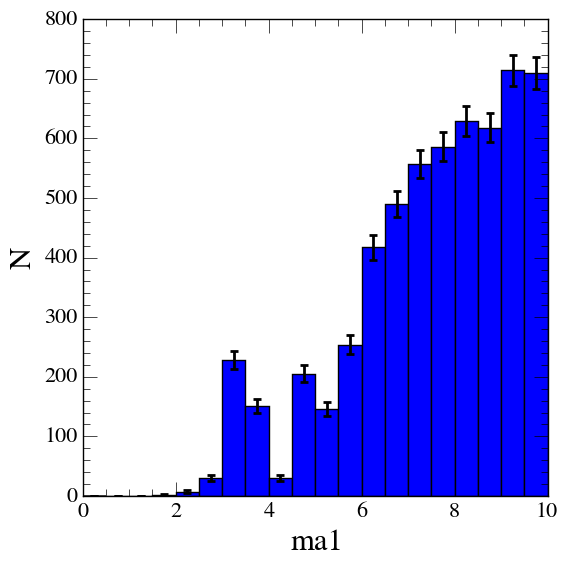

In [27]:
plot_histogram(df=df_pass_all.query('122.1<mh1<128.1'), var='ma1', bins=20, range=[0,10])

In [898]:
dff = df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('mh2<128.1')
nu_tautau =  dff['xsec_8_ggf_h2_2h1_4b'] * dff['Brh1a1a1'] * dff['Brh1a1a1'] * dff['Bra1tautau'] * dff['Bra1tautau'] / (dff['Brh1bb'] * dff['Brh1bb'])
nu_tautau = nu_tautau.dropna()

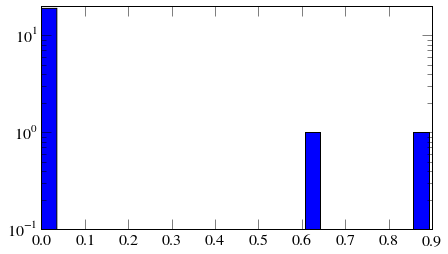

In [899]:
plt.hist(nu_tautau.values, bins=25)
plt.ylim(bottom=0.1)
plt.yscale('log')

In [900]:
dff = df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('mh2<128.1')
nu_bb =  dff['xsec_8_ggf_h2_2h1_4b'] * dff['Brh1a1a1'] * dff['Brh1a1a1'] * dff['Bra1bb'] * dff['Bra1bb'] / (dff['Brh1bb'] * dff['Brh1bb'])
nu_bb = nu_bb.dropna()

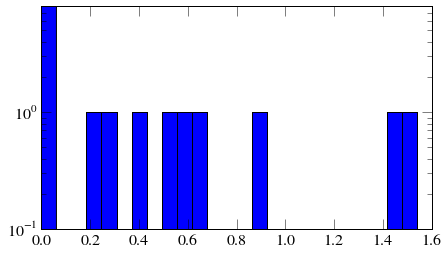

In [901]:
plt.hist(nu_bb.values, bins=25)
plt.ylim(bottom=0.1)
plt.yscale('log')

In [668]:
@save_fig
def plot_mh2_ma1_scatter(df, title):
    plot_scatter(df=df, xvar='ma1', yvar='mh2', 
                 xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$', 
                 color='green', s=SIZE)
    plt.xlim(0, 60)
    plt.ylim(80, 220)
#     plt.yscale('log')
    plt.title(title)
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False, hatch="xxx", 
                          label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='lower right', frameon=False)
    plt.tight_layout()


Setting backend png
Setting backend png


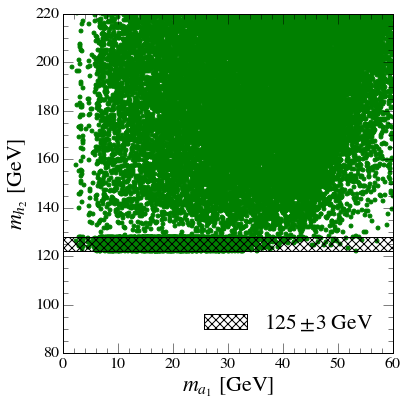

In [912]:
plot_mh2_ma1_scatter(df_pass_all, title, filename='Thesis_plots_4/Masses/mh2_ma1_relaxed.png')

In [928]:
@save_fig
def plot_mh2_ma1_hist2d(df, title):
    plot_histogram2d(df=df.query('120 < mh2<220'), 
                     xvar='ma1', yvar='mh2', 
                     xlabel=r'$m_{a_1}\ \mathrm{[GeV]}$', 
                     ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$', 
                     bins=[40,40],
                     norm_axis='x',
                     cmap='YlOrRd')
    plt.xlim(0, 60)
    plt.ylim(120, 220)
#     plt.yscale('log')
    plt.title(title)
#     make_highlight_region(plt.gca(), [125-3, 125+3], 
#                           'Y', color='k', alpha=1, fill=False, hatch="xxx", 
#                           label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='lower right', frameon=False)
    plt.tight_layout()


Setting backend png
Setting backend png


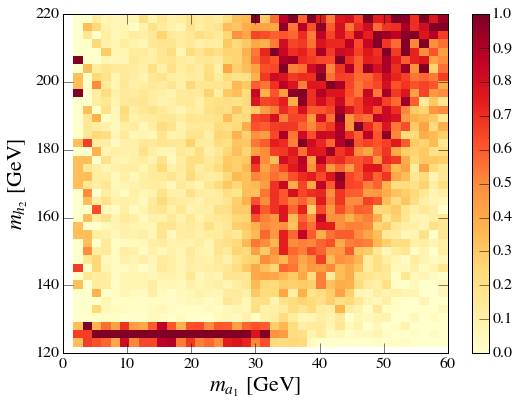

In [929]:
plot_mh2_ma1_hist2d(df_pass_all, title, filename='Thesis_plots_4/Masses/mh2_ma1_hist2d.png')

In [913]:
@save_fig
def plot_mh2_mh1_scatter(df, title):
    plot_scatter(df=df, xvar='mh1', yvar='mh2', 
                 xlabel=r'$m_{h_1}\ \mathrm{[GeV]}$', 
                 ylabel=r'$m_{h_2}\ \mathrm{[GeV]}$',
                 color='red', s=SIZE)
    plt.xlim(0, 140)
    plt.ylim(80, 220)
    
    xmin, xmax = plt.xlim()
    ymin, ymax = xmin, xmax
    plt.plot([xmin, xmax], [ymin, ymax], linestyle='dashed', 
             label=r'$m_{h_2} =\ m_{h_1}$', linewidth=2)

    plt.title(title)
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'X', color='k', alpha=1, fill=False, hatch='xxx')
    make_highlight_region(plt.gca(), [125-3, 125+3], 
                          'Y', color='k', alpha=1, fill=False, hatch='xxx', 
                          label=r'$125 \pm 3\ \mathrm{GeV}$')
    plt.legend(loc='upper left', frameon=False)
    plt.tight_layout()

Setting backend png
Setting backend png


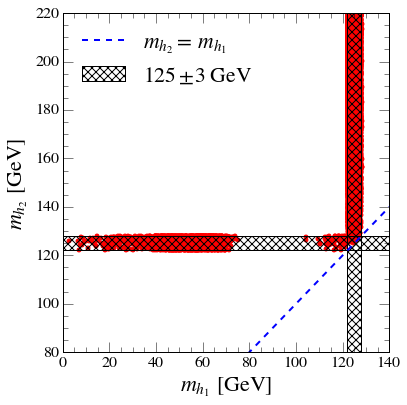

In [914]:
plot_mh2_mh1_scatter(df_pass_all, title, filename='Thesis_plots_4/Masses/mh2_mh1_relaxed.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x133afdb90>,
 <matplotlib.collections.PathCollection at 0x135707dd0>)

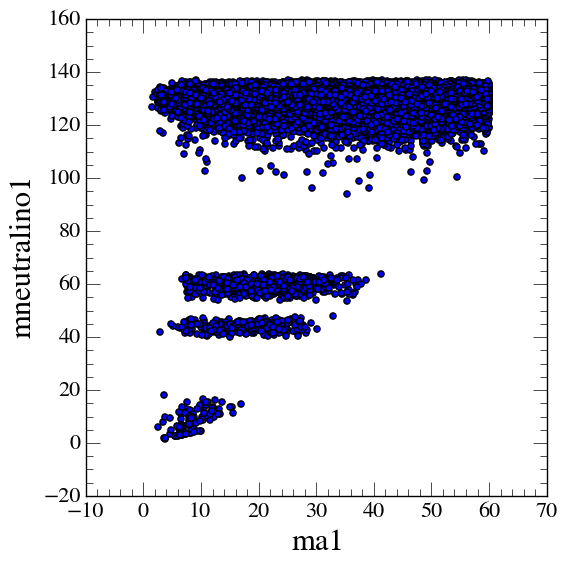

In [74]:
plot_scatter(df=df_pass_all[~df_pass_all.constraints.str.contains('chi2')], xvar='ma1', yvar='mneutralino1')

(<matplotlib.axes._subplots.AxesSubplot at 0x1356fbd10>,
 <matplotlib.collections.PathCollection at 0x12ed5bdd0>)

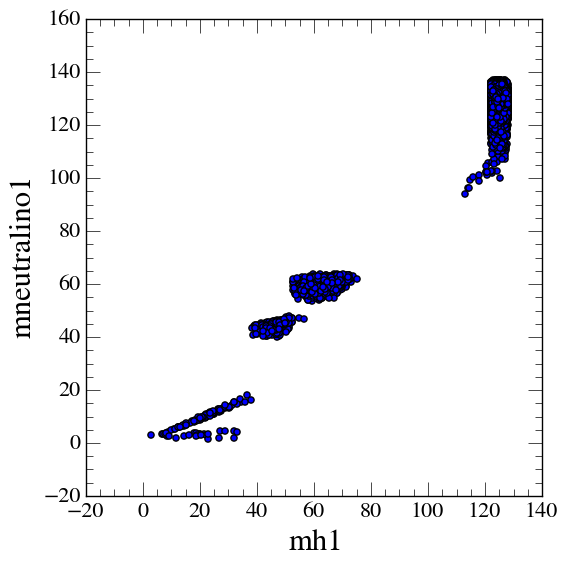

In [75]:
plot_scatter(df=df_pass_all[~df_pass_all.constraints.str.contains('chi2')], xvar='mh1', yvar='mneutralino1')

(<matplotlib.axes._subplots.AxesSubplot at 0x15f8541d0>,
 <matplotlib.collections.PathCollection at 0x1303e5410>)

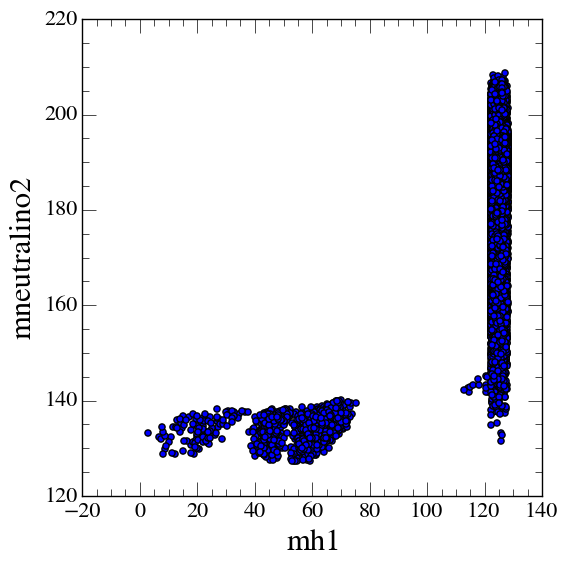

In [76]:
plot_scatter(df=df_pass_all[~df_pass_all.constraints.str.contains('chi2')], xvar='mh1', yvar='mneutralino2')

(<matplotlib.axes._subplots.AxesSubplot at 0x15f883e10>,
 <matplotlib.collections.PathCollection at 0x133344390>)

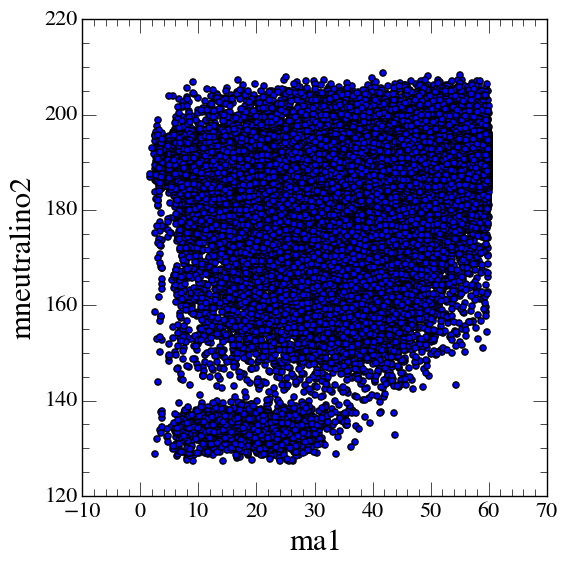

In [77]:
plot_scatter(df=df_pass_all[~df_pass_all.constraints.str.contains('chi2')], xvar='ma1', yvar='mneutralino2')

In [78]:
@save_fig
def plot_mass_corrs(df, title):
    cols = ['mh1', 'mh2', 'mh3', 'mhc', 'ma1', 'ma2', 'mneutralino1', 'mneutralino2', 'mstop1', 'mstop2', 'msbottom1', 'msbottom2', 'mgluino']
    df = df[cols]
    pd.tools.plotting.scatter_matrix(df, figsize=[20, 20], alpha=0.7, grid=True, hist_kwds={'bins': 25}, color='red')
    plt.suptitle(title, y=0.93)

Setting backend png
Setting backend png


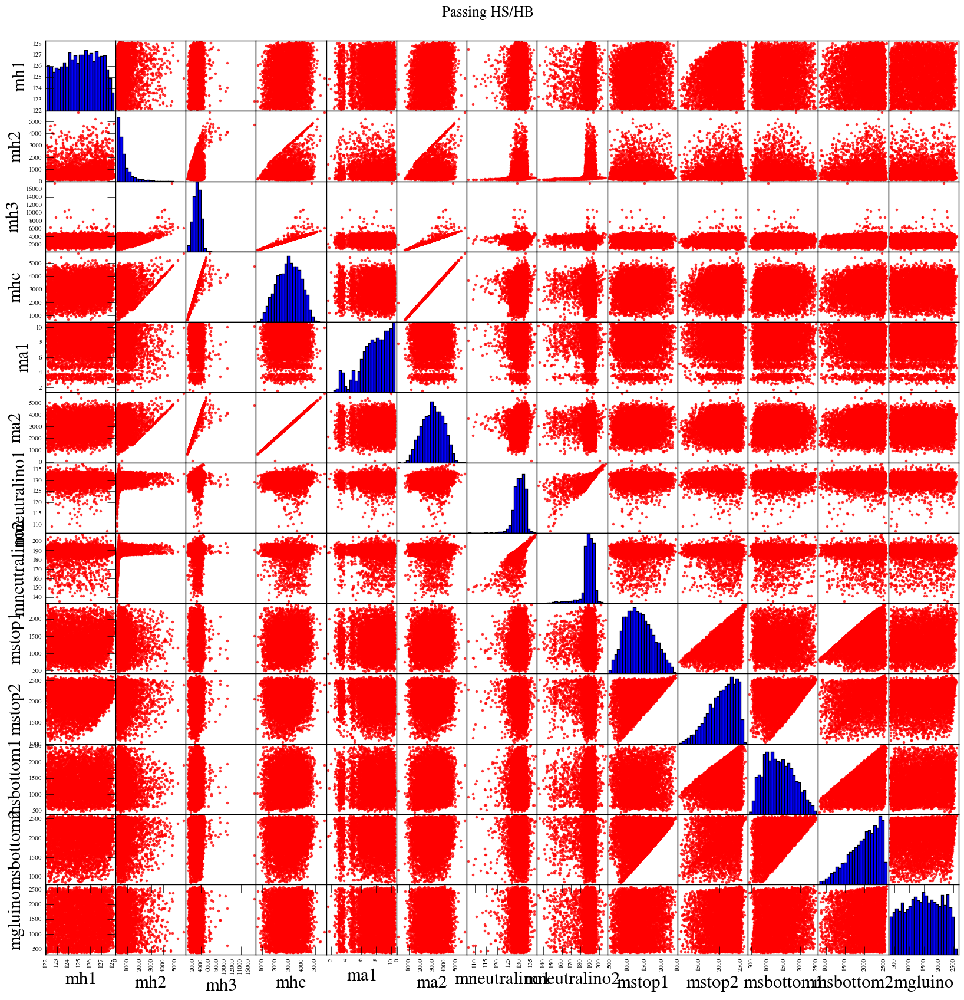

In [79]:
plot_mass_corrs(df_pass_all.query('122.1<mh1<128.1 & mh2>128.1 & ma1<10.5 & HSprob>0.05 & HBresult==1'), 
                'Passing HS/HB', filename='Thesis_plots_4/Masses/mass_corr_HSHB_h1.png')

Setting backend png
Setting backend png


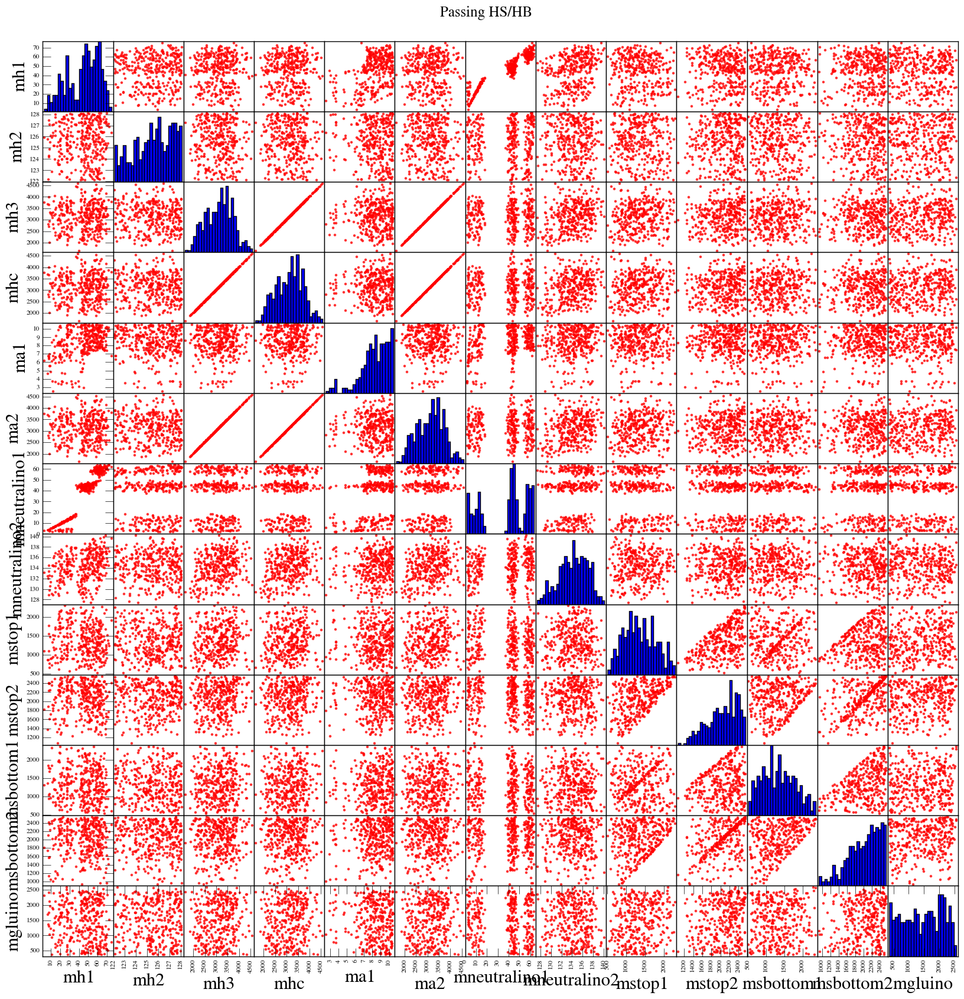

In [80]:
plot_mass_corrs(df_pass_all.query('122.1<mh2<128.1 & mh1<122.1 & ma1<10.5 & HSprob>0.05 & HBresult==1'), 
                'Passing HS/HB', filename='Thesis_plots_4/Masses/mass_corr_HSHB_h2.png')

ERROR! Session/line number was not unique in database. History logging moved to new session 673


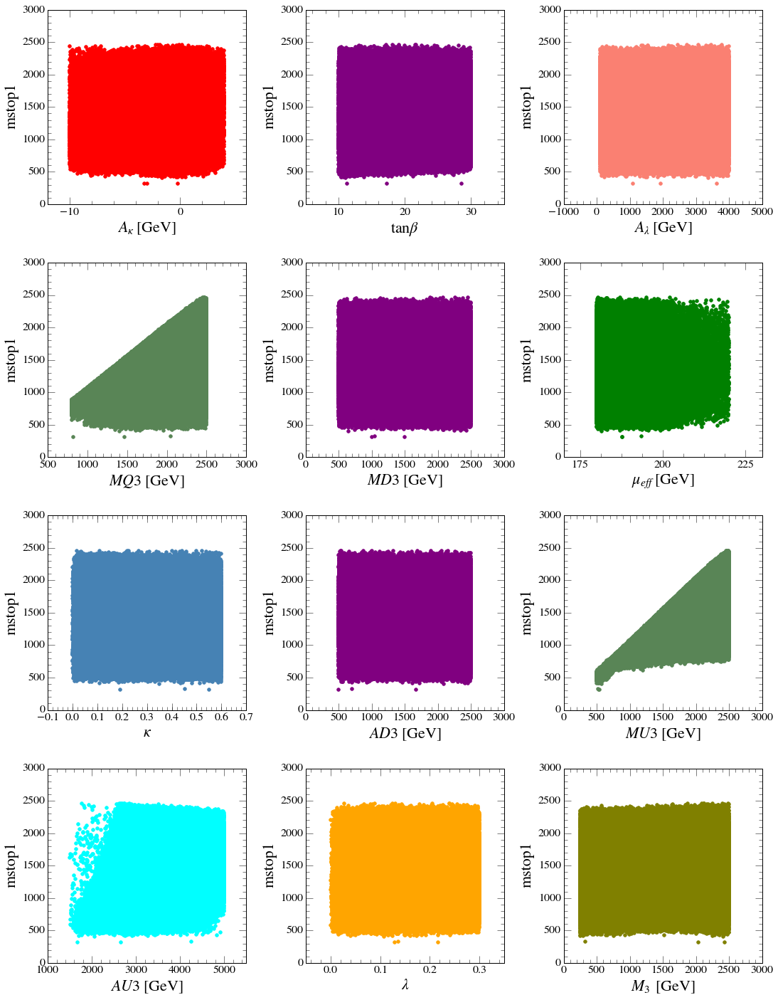

In [940]:
plot_input_params_scatters(df_pass_all, yvar='mstop1', ylabel='mstop1', param_dict=nmssm_params_extended)

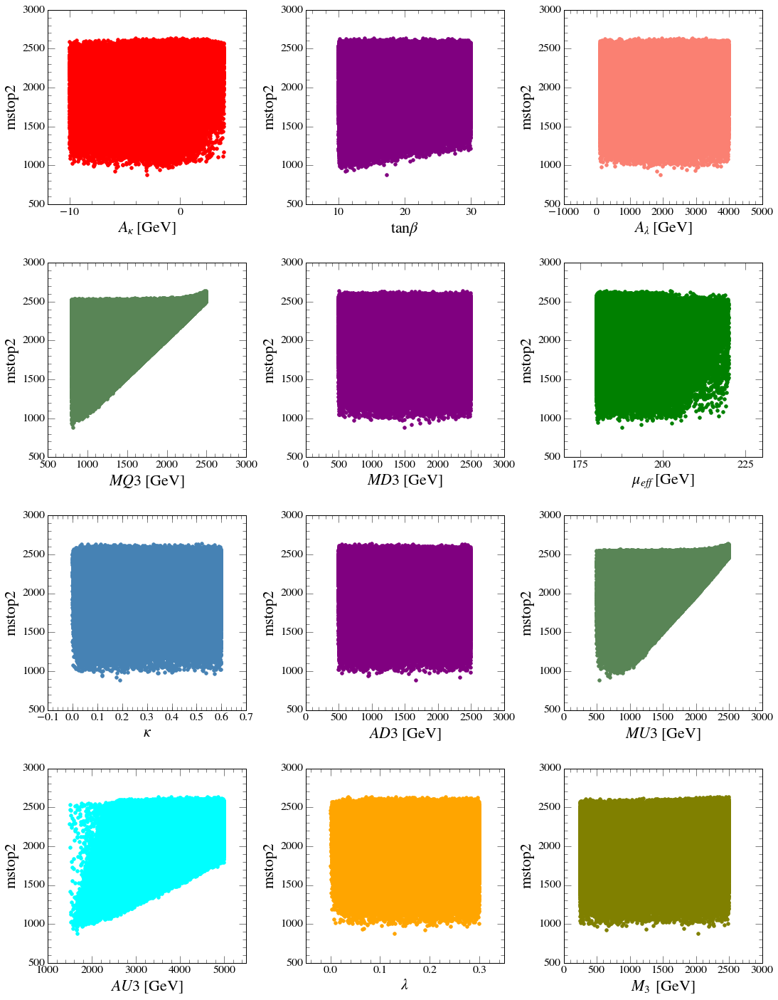

In [944]:
plot_input_params_scatters(df_pass_all, yvar='mstop2', ylabel='mstop2', param_dict=nmssm_params_extended)

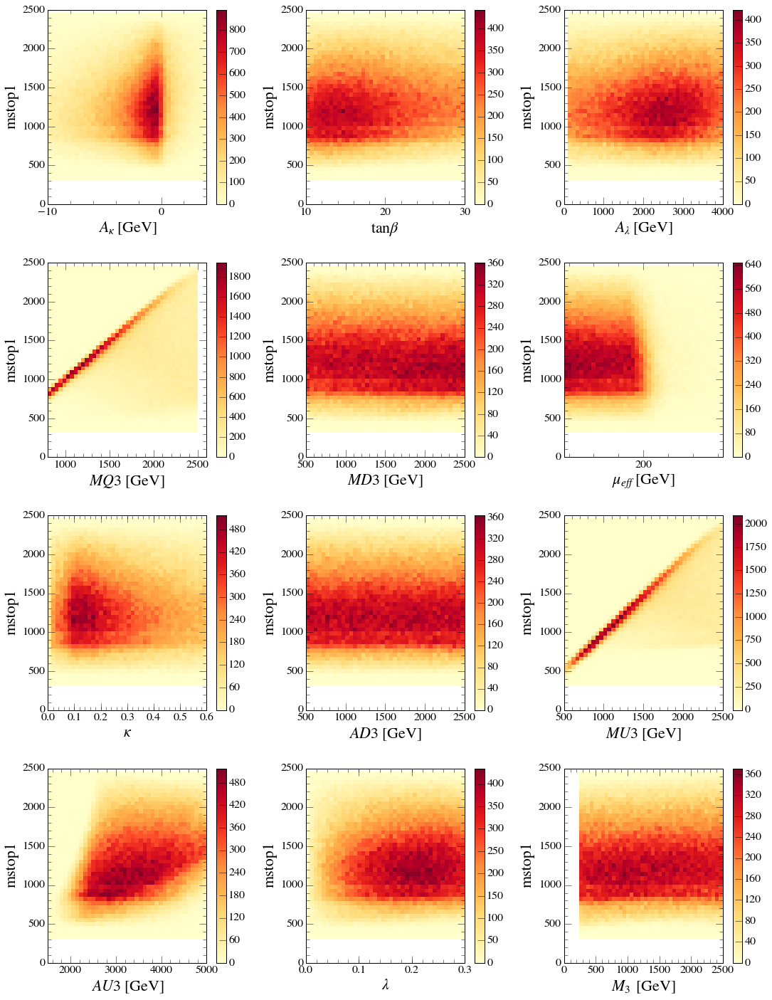

In [942]:
plot_input_params_hist2d(df_pass_all, yvar='mstop1', ylabel='mstop1', 
                         param_dict=nmssm_params_extended, 
                         bins=[40,40], cmap='YlOrRd')

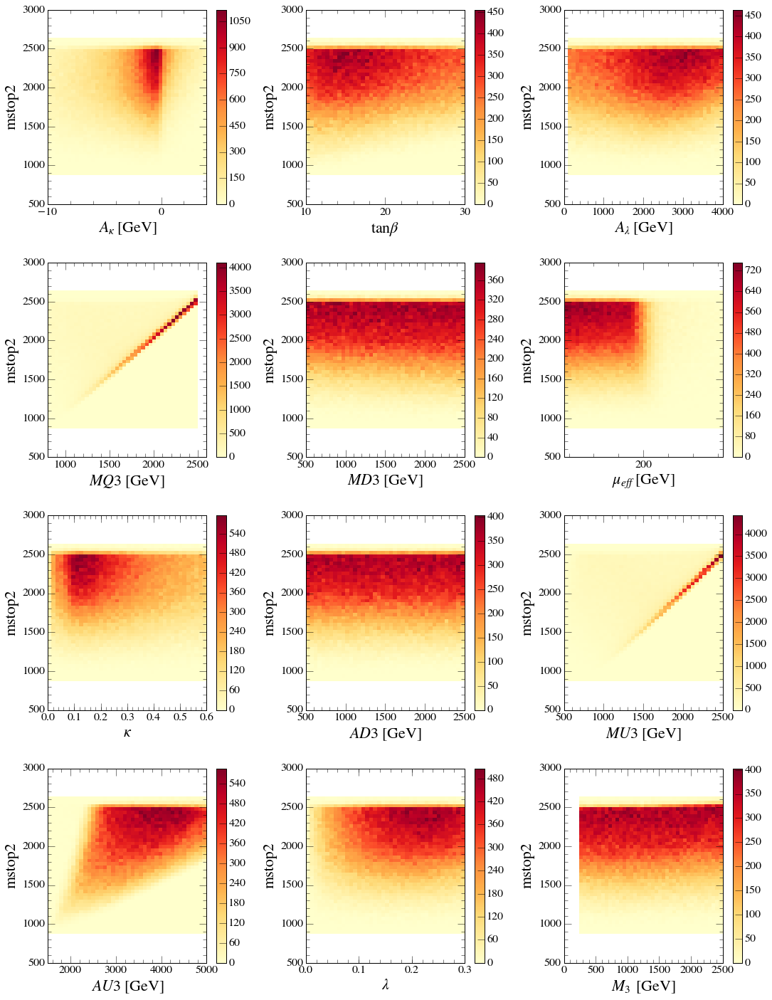

In [943]:
plot_input_params_hist2d(df_pass_all, yvar='mstop2', ylabel='mstop2', 
                         param_dict=nmssm_params_extended, 
                         bins=[40,40], cmap='YlOrRd')

#  Reduced couplings, BR

Setting backend png
Setting backend png


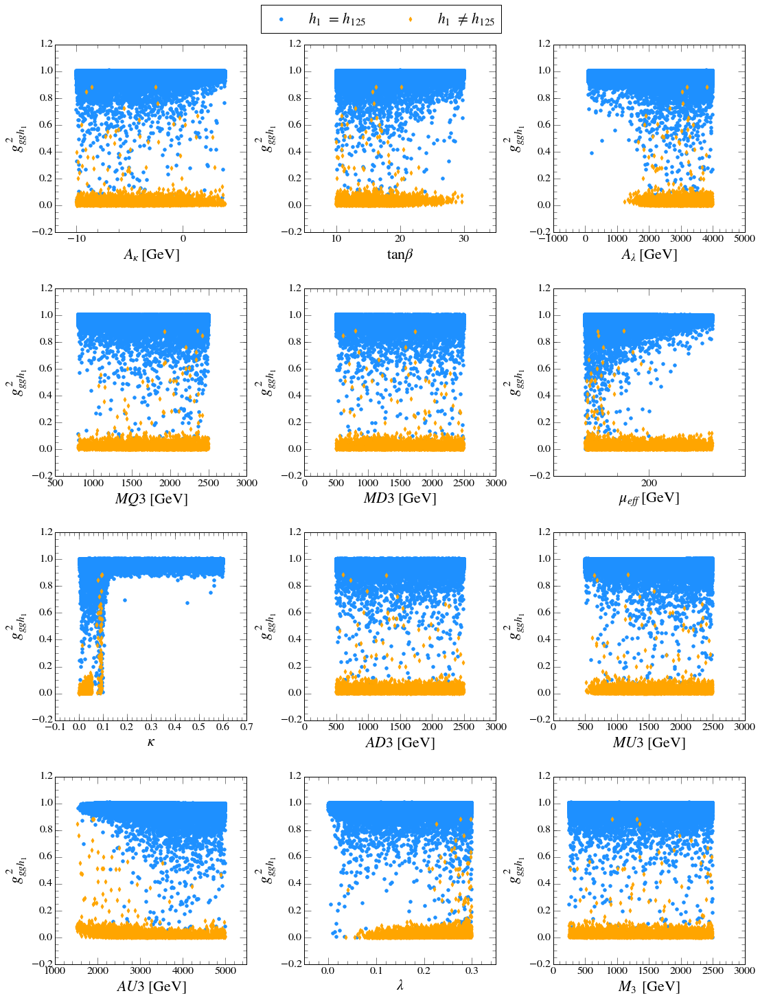

In [670]:
@save_fig
def plot_h1ggrc2_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh1<128.1'), df.query('mh1<122.1')], 
                                        yvar='h1ggrc2', ylabel=r"$g_{ggh_1}^2$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[{'color':'dodgerblue', 'label':r'$h_1\ =\ h_{125}$'}, 
                                                {'color':'orange', 'marker': 'd', 'label': r'$h_1\ \neq\ h_{125}$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_h1ggrc2_scatter(df_pass_all, filename='Thesis_plots_4/Couplings_BR/h1ggrc2_scatter.png')

Setting backend png
Setting backend png


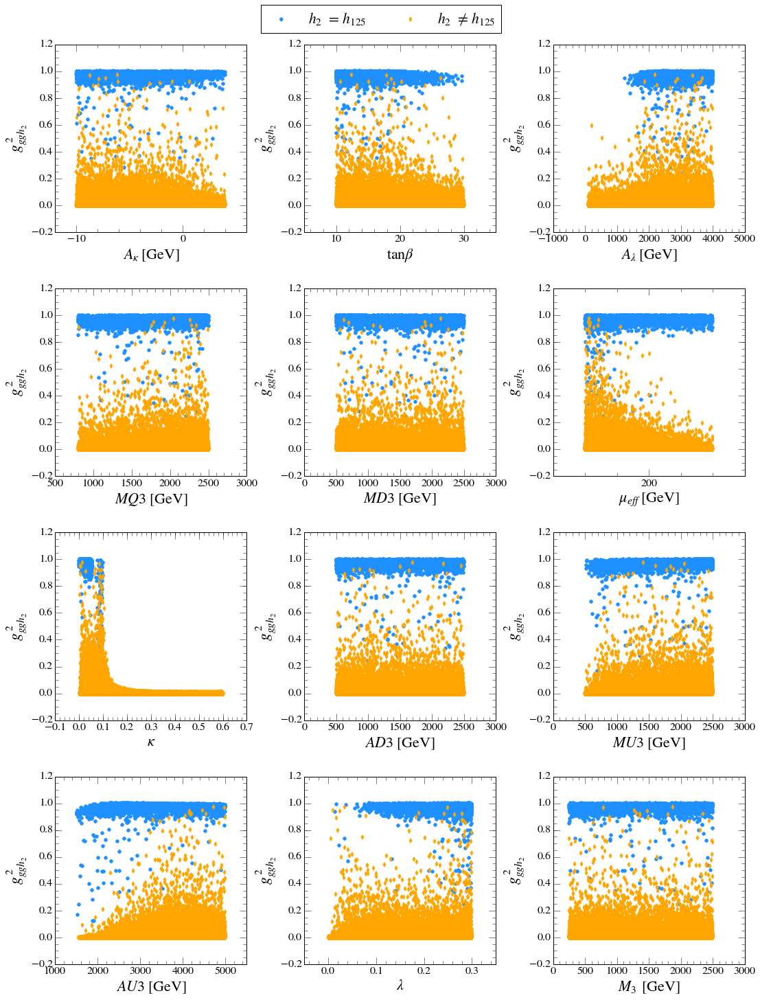

In [671]:
@save_fig
def plot_h2ggrc2_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh2<128.1'), df.query('mh2>128.1')], 
                                        yvar='h2ggrc2', ylabel=r"$g_{ggh_2}^2$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[{'color':'dodgerblue', 'label':r'$h_2\ =\ h_{125}$'}, 
                                                {'color':'orange', 'marker': 'd', 'label': r'$h_2\ \neq\ h_{125}$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_h2ggrc2_scatter(df_pass_all, filename='Thesis_plots_4/Couplings_BR/h2ggrc2_scatter.png')

Setting backend png
Setting backend png


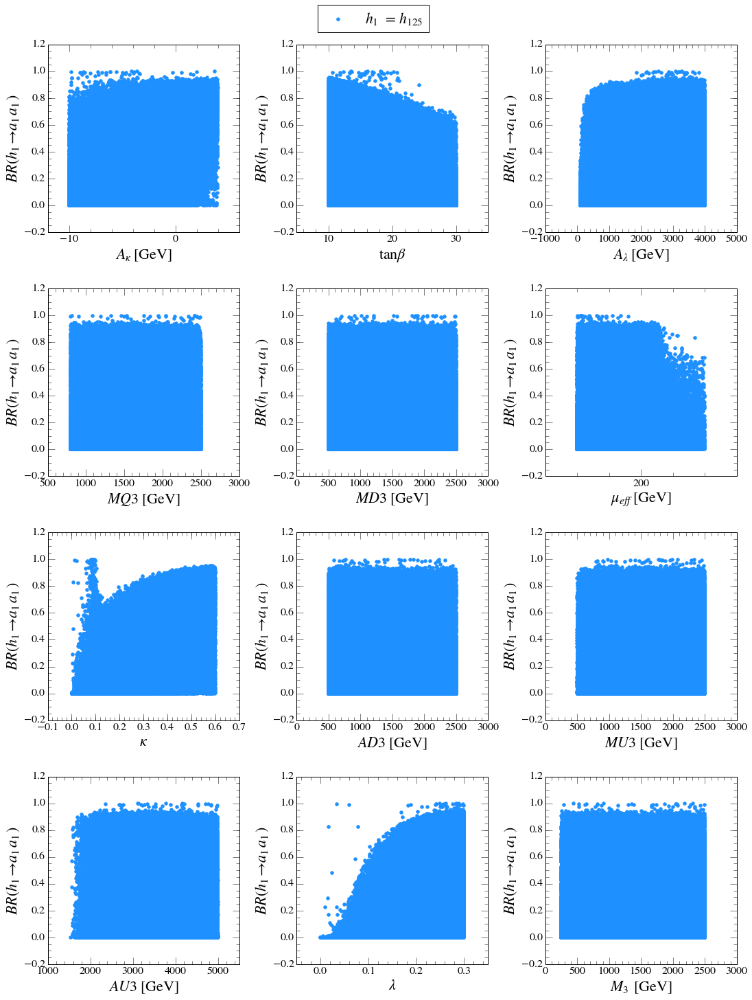

In [690]:
@save_fig
def plot_brh1a1a1_scatter(df):
    plot_input_params_scatters_multiple(dfs=[df.query('122.1<mh1<128.1')],
#                                              , df[~df.constraints.str.contains('chi2')].query('122.1<mh1<128.1')], 
                                        yvar='Brh1a1a1', ylabel=r"$BR(h_1\to a_1a_1)$", 
                                        param_dict=nmssm_params_extended,
                                        kwargs=[
                                            {'color':'dodgerblue', 'label':r'$h_1\ =\ h_{125}$'}])
#                                             {'color':'green', 'label': 'Pass NT '+r'$\chi^2$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh1a1a1_scatter(df_pass_all, filename='Thesis_plots_4/Couplings_BR/Brh1a1a1_scatter.png')

Setting backend png
Setting backend png


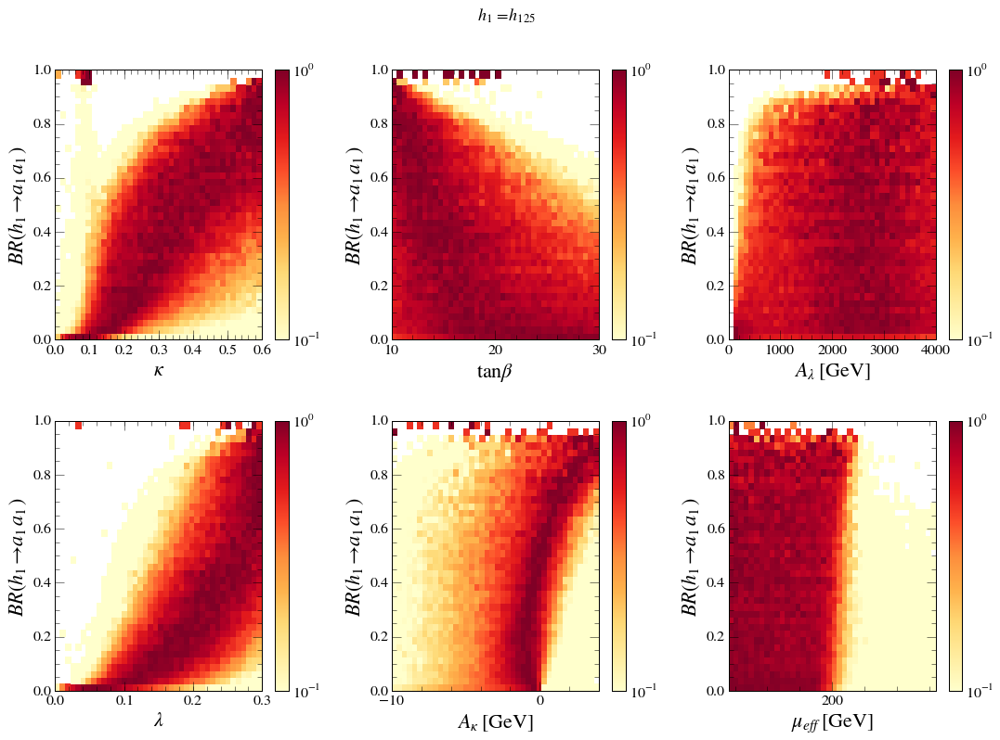

In [947]:
@save_fig
def plot_brh1a1a1_hist2d(df):
    plist = ['akappa', 'tgbeta', 'alambda', 'kappa', 'lambda_', 'mueff']
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_hist2d(df=df.query('122.1<mh1<128.1 & mh2>128.1 & Brh1a1a1>0'), 
                             yvar='Brh1a1a1', ylabel=r"$BR(h_1\to a_1a_1)$", 
                             param_dict=custom_params,
                             norm=LogNorm(vmin=1E-1),
                             bins=[40,40],
                             norm_axis='y',
                             cmap='YlOrRd',
                             label=r'$h_1\ =\ h_{125}$')
    plt.suptitle(r'$h_1 = h_{125}$')
    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh1a1a1_hist2d(df_pass_all, filename='Thesis_plots_4/Couplings_BR/Brh1a1a1_hist2d.png')

Setting backend png
Setting backend png


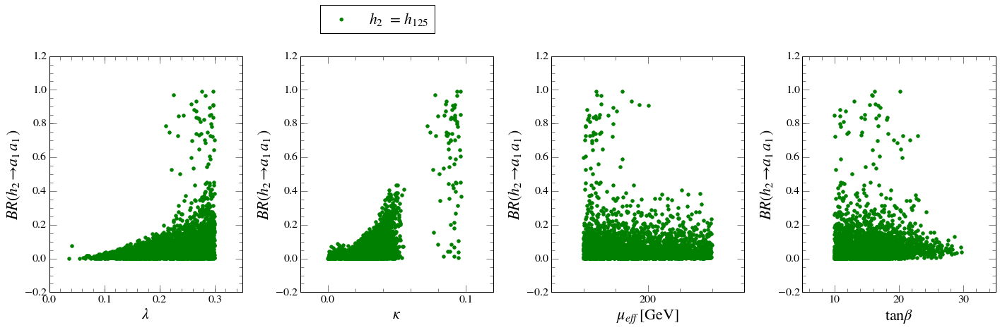

In [700]:
@save_fig
def plot_brh2a1a1_scatter(df):
    plist = ['tgbeta', 'kappa', 'lambda_', 'mueff']
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}
    plot_input_params_scatters_multiple(dfs=[df.query('mh1<122.1 & 122.1<mh2<128.1')], 
                                        yvar='Brh2a1a1', ylabel=r"$BR(h_2\to a_1a_1)$", 
                                        param_dict=custom_params,
                                        cols=4,
                                        kwargs=[{'color':'green', 'label':r'$h_2\ =\ h_{125}$'}])

    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh2a1a1_scatter(df_pass_all, filename='Thesis_plots_4/Couplings_BR/Brh2a1a1_scatter.png')

Setting backend png
Setting backend png


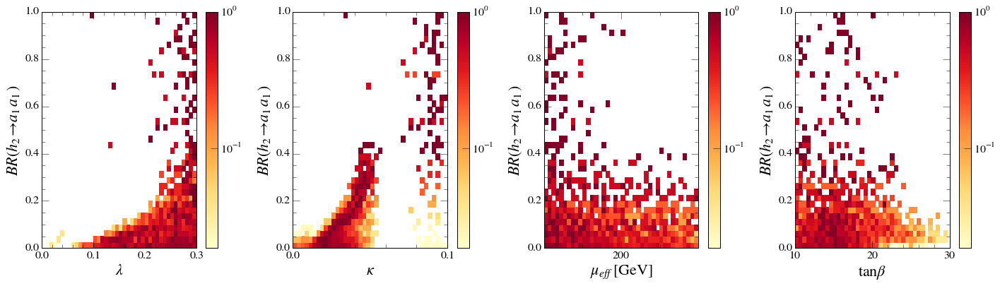

In [711]:
@save_fig
def plot_brh2a1a1_hist2d(df):
    plist = ['tgbeta', 'kappa', 'lambda_', 'mueff']
    custom_params = {k:v for k,v in nmssm_params_extended.iteritems() if k in plist}

    plot_input_params_hist2d(df=df.query('122.1<mh2<128.1 & Brh1a1a1>0'), 
                             yvar='Brh2a1a1', ylabel=r"$BR(h_2\to a_1a_1)$", 
                             param_dict=custom_params,
                             norm=LogNorm(),
                             bins=[40,40],
                             norm_axis='y',
                             cmap='YlOrRd',
                             cols=4,
                             label=r'$h_2\ =\ h_{125}$')
 
    plt.gcf().axes[0].legend(loc='upper center', framealpha=1, ncol=2, bbox_to_anchor=(1.7, 1.25))

plot_brh2a1a1_hist2d(df_pass_all, filename='Thesis_plots_4/Couplings_BR/Brh2a1a1_hist2d.png')

In [38]:
import math

def plot_contours(ax, xlim=[0, 1], ylim=[0, 1], n_div=15, log_steps=False):
    """For contours of constant BR * ggh^2"""
    delta = min(xlim[1], ylim[1])/40.
    # generate a grid of x and y values
    x = np.arange(xlim[0], xlim[1]+delta, delta)
    y = np.arange(ylim[0], ylim[1]+delta, delta)
    X, Y = np.meshgrid(x, y)
    # generate a grid of the product of these values
    Z = X * Y

    if log_steps:
        max_v = xlim[1] * ylim[1]
        min_v = xlim[0] * ylim[0]
        print math.log(max_v, 10)-5, math.log(max_v, 10)+1
        n_div = np.logspace( math.log(max_v, 10)-5, math.log(max_v, 10)+1, num=7)

    manual_locations = [(math.sqrt(x), math.sqrt(x)) for x in n_div]
    manual_locations[-1] = (0.55, n_div[-1]/0.55)
    CS = ax.contour(X, Y, Z, n_div, colors='k')
    ax.clabel(CS, inline=1, fontsize=16, fmt='%g', manual=manual_locations)


@save_fig    
def plot_grc2_br(df, mass_range, title):
    fig, ax = generate_fig_axes(size=(8,7))

    n_div = [1E-2, 2E-2, 5E-2, 1E-1, 2E-1, 5E-1]
    plot_contours(plt.gca(), n_div=n_div)

    F = 3

    df = df.query('%f<ma1<%f' % (mass_range[0], mass_range[1]))
    plot_scatter(ax=ax, df=df.query('122.1 < mh1 < 128.1 & mh2>128.1'), 
                 xvar='h1ggrc2', yvar='Brh1a1a1', color='blue', 
                 label=r'$h_{125} = h_1,\ h_i = h_1,\ X = a_1$',
                 marker='s', s=F*SIZE, alpha=0.75)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh2 < 128.1'), 
                 xvar='h2ggrc2', yvar='Brh2a1a1', color='red', 
                 label=r'$h_{125} = h_2,\ h_i = h_2,\ X = a_1$',
                 marker='o', s=F*SIZE, alpha=0.95)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh1 < 128.1 & mh2>128.1'), 
                 label=r'$h_{125} = h_1,\ h_i = h_2,\ X = a_1$',
                 xvar='h2ggrc2', yvar='Brh2a1a1', color='purple', 
                 marker='s', s=F*SIZE, alpha=0.75)
    plot_scatter(ax=plt.gca(), df=df.query('122.1 < mh2 < 128.1'), 
                 label=r'$h_{125} = h_2,\ h_i = h_1,\ X = a_1$',
                 xvar='h1ggrc2', yvar='Brh1a1a1', color='green', 
                 marker='o', s=F*SIZE, alpha=0.95)

    plot_scatter(ax=plt.gca(), df=df.query('%f<mh1<%f & 122.1 < mh2 < 128.1' % (mass_range[0], mass_range[1])), 
                 label=r'$h_{125} = h_2,\ h_i = h_2,\ X = h_1$',
                 xvar='h2ggrc2', yvar='Brh2h1h1', color='orange', 
                 marker='^', s=F*SIZE, alpha=0.95)

    plt.xlim(-0.1, 1.1)
    plt.ylim(-0.1, 1.1)


    plt.xlabel(r'$g_{ggh_i}^2$')
    plt.ylabel(r'$BR(h_i \to XX)$')

    plt.legend(loc='upper right', fontsize=15, framealpha=0.85, frameon=False)

    plt.title(title)
    plt.tight_layout()

In [39]:
low_mass_title = r'$m_{X} < 10.5\ \mathrm{GeV}$'
hi_mass_title = r'$12 < m_{X} < 62\ \mathrm{GeV}$'

Setting backend pdf


/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/text.py:52: UnicodeWarning: Unicode equal comparison failed to convert both arguments to Unicode - interpreting them as being unequal
  if rotation in ('horizontal', None):
/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/matplotlib/text.py:54: UnicodeWarning: Unicode equal comparison failed to convert both arguments to Unicode - interpreting them as being unequal
  elif rotation == 'vertical':


Setting backend png


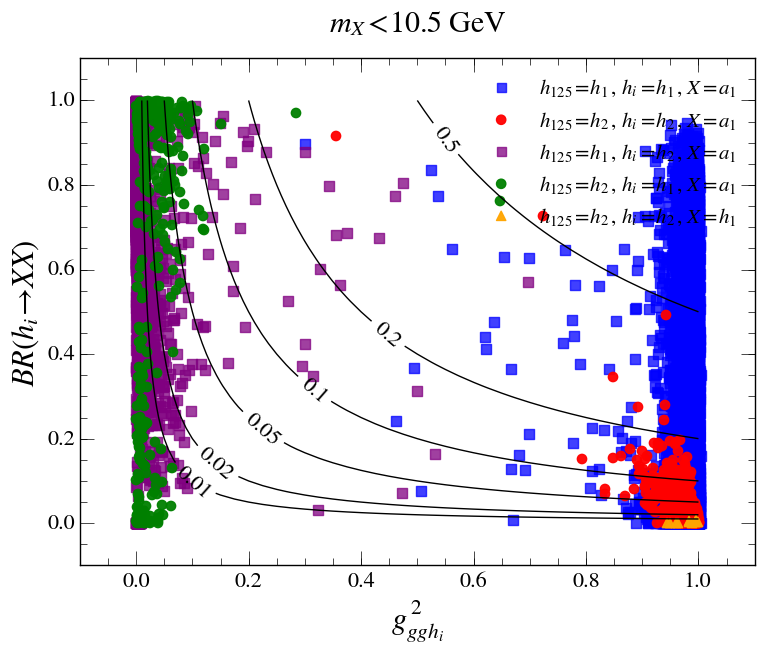

In [40]:
plot_grc2_br(df_pass_all, [0, 10.5], low_mass_title, filename='Thesis_plots_4/Couplings_BR/rc2_br_ma1Lt10p5.pdf')

Setting backend pdf
Setting backend png


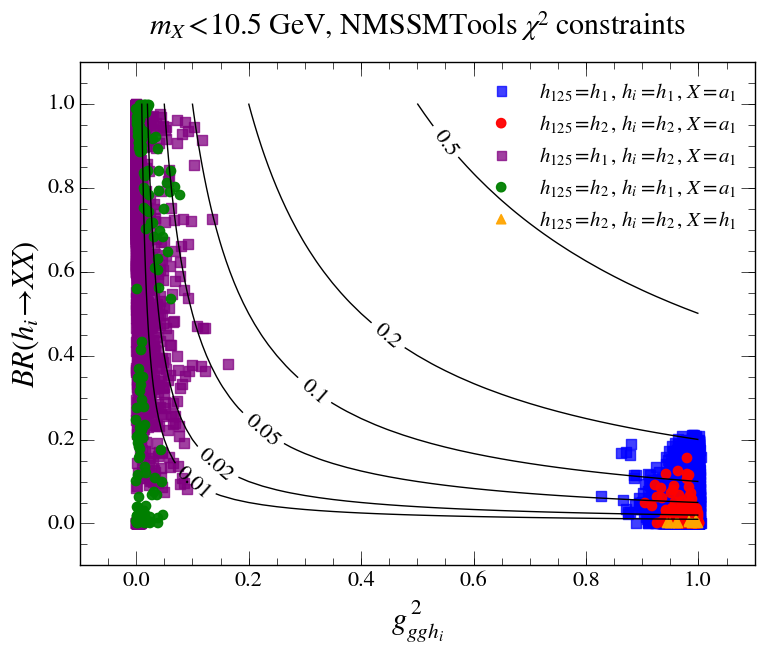

In [41]:
plot_grc2_br(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], [0, 10.5], 
             low_mass_title + ", NMSSMTools " + r'$\chi^2$' + 'constraints', 
             filename='Thesis_plots_4/Couplings_BR/rc2_br_ma1Lt10p5_NT.pdf')

Setting backend pdf
Setting backend png


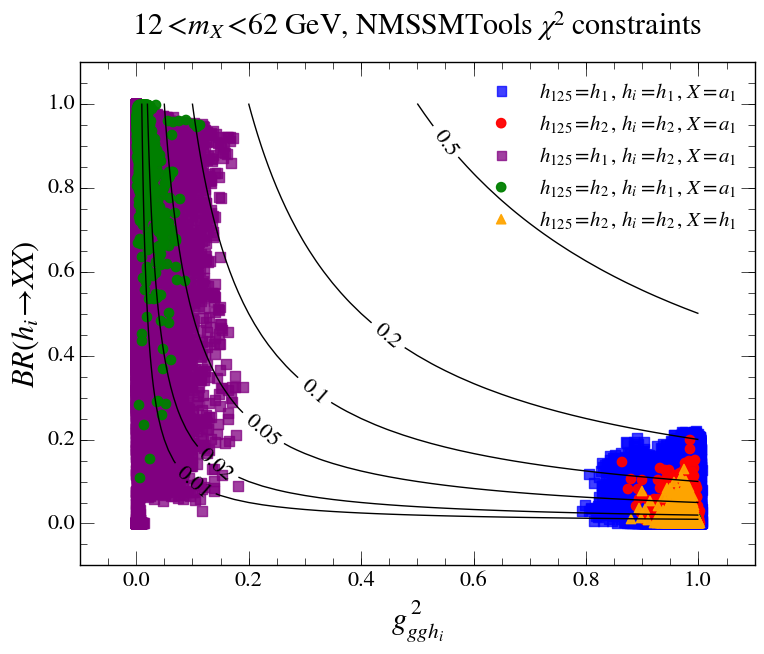

In [42]:
plot_grc2_br(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], [12, 62], 
             hi_mass_title + ", NMSSMTools " + r'$\chi^2$' + 'constraints', 
             filename='Thesis_plots_4/Couplings_BR/rc2_br_ma1Gt12_NT.pdf')

Setting backend pdf
Setting backend png


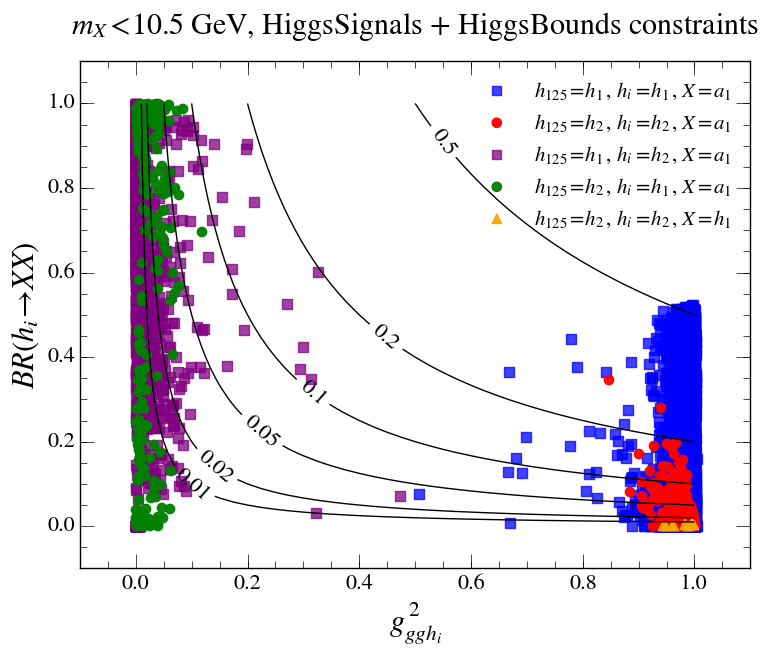

In [43]:
plot_grc2_br(df_pass_all.query('HSprob>0.05 & HBresult==1'), [0, 10.5],
             low_mass_title + ', HiggsSignals + HiggsBounds constraints', 
             filename='Thesis_plots_4/Couplings_BR/rc2_br_ma1Lt10p5_HSHB.pdf')

Setting backend pdf
Setting backend png


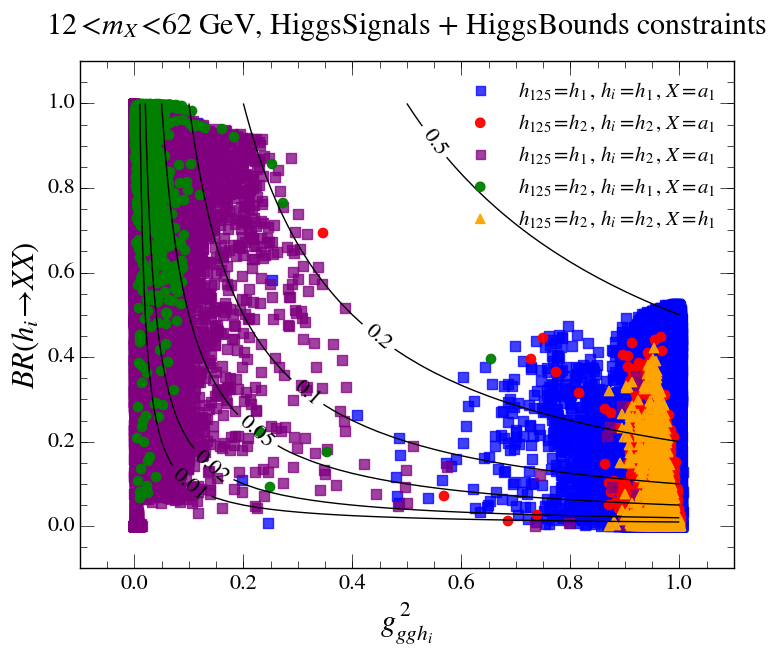

In [44]:
plot_grc2_br(df_pass_all.query('HSprob>0.05 & HBresult==1'), [12, 62],
             hi_mass_title + ', HiggsSignals + HiggsBounds constraints', 
             filename='Thesis_plots_4/Couplings_BR/rc2_br_ma1Gt12_HSHB.pdf')

In [45]:
@save_fig
def plot_h1BR_NT_HSHB(df, title, var, xlim, xlabel):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    nbins = 50
    lw = 1
    norm = False
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')

    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw,
                   errorbars=False, normed=norm)

    plt.xlabel(xlabel)
    plt.xlim(*xlim)
#     plt.ylim(1, 5E4)
    plt.yscale('log')
    plt.legend(loc='best', fontsize=16, frameon=False)

Setting backend pdf
Setting backend png


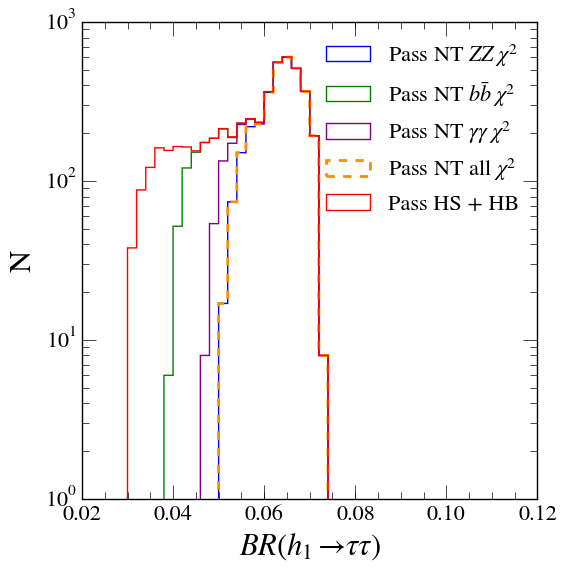

In [46]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1tautau', 
                  xlim=[0.02, .12], xlabel=r'$BR(h_1 \to \tau\tau)$', 
                  filename='Thesis_plots_4/Couplings_BR/h1tautau_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


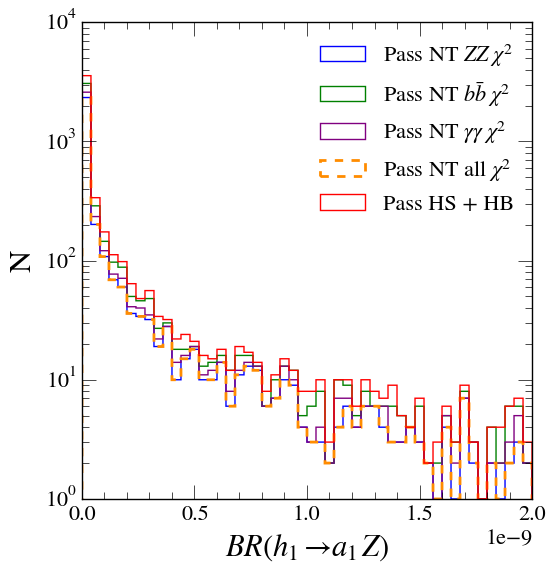

In [47]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1a1z', 
                  xlim=[0, 2E-9], xlabel=r'$BR(h_1 \to a_1Z)$', 
                  filename='Thesis_plots_4/Couplings_BR/h1a1z_NT_HSHB.pdf')

Setting backend pdf
Setting backend png


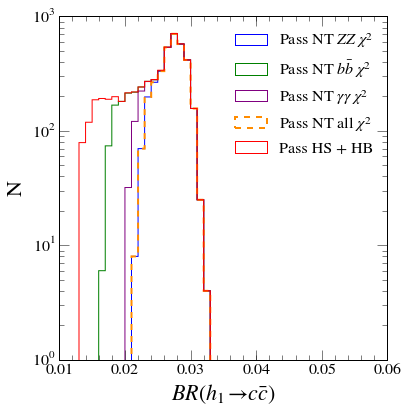

In [434]:
plot_h1BR_NT_HSHB(df_pass_all, title='', var='Brh1cc', 
                  xlim=[0.01, 6E-2], xlabel=r'$BR(h_1 \to c\bar{c})$', 
                  filename='Thesis_plots_4/Couplings_BR/h1cc_NT_HSHB.pdf')

In [49]:
@save_fig
def plot_h1zz_NT_HSHB(df, title):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    var = 'Brh1zz'
    nbins = 30
    xlim = [0, 6E-2]
    lw = 1
    norm = False
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')

    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw,
                   errorbars=False, normed=norm)
    
    plt.xlabel(r'$BR(h_1 \to ZZ)$')
    plt.xlim(*xlim)
    plt.legend(loc='best', fontsize=16, frameon=False)
#     plt.ylim(1, 2E3)
    plt.yscale('log')

Setting backend pdf
Setting backend png


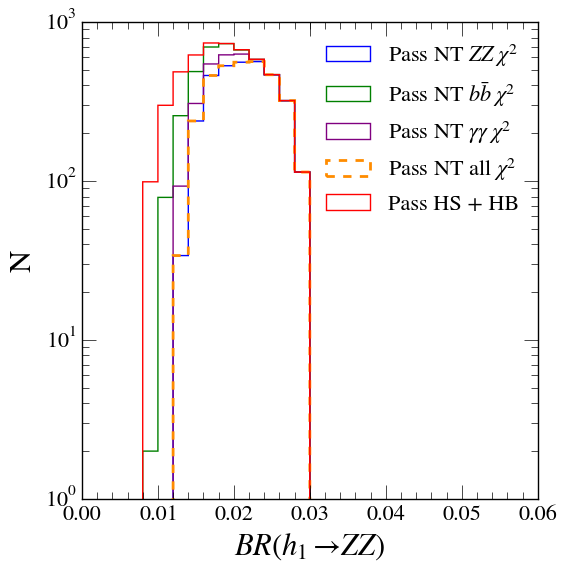

In [50]:
plot_h1zz_NT_HSHB(df_pass_all, '', filename='Thesis_plots_4/Couplings_BR/h1zz_NT_HSHB.pdf')

In [51]:
@save_fig
def plot_h1bb_NT_HSHB(df, title):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    var = 'Brh1bb'
    xlim = [0.2, 0.7]
    nbins = 25
    lw = 1
    norm = False
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')

    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, #linestyle='dashed',
                   errorbars=False, normed=norm)
    
    plt.xlabel(r'$BR(h_1 \to b\bar{b})$')
    plt.xlim(*xlim)
    plt.legend(loc='upper left', fontsize=16, frameon=False)
#     plt.ylim(1, 7.5E4)
    plt.yscale('log')

Setting backend pdf
Setting backend png


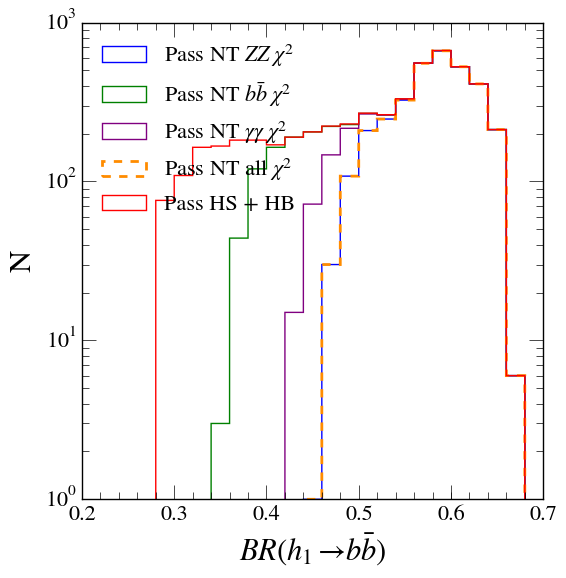

In [52]:
plot_h1bb_NT_HSHB(df_pass_all, '', filename='Thesis_plots_4/Couplings_BR/h1bb_NT_HSHB.pdf')

In [53]:
@save_fig
def plot_h1gluglu_NT_HSHB(df, title):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    var = 'Brh1gg'
    xlim = [0.02, 0.12]
    nbins = 25
    lw = 1
    norm = False
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')

    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, #linestyle='dashed',
                   errorbars=False, normed=norm)
    
    plt.xlim(*xlim)
    plt.xlabel(r'$BR(h_1 \to gg)$')
    plt.legend(loc='upper right', fontsize=16, frameon=False)
#     plt.ylim(1, 5E3)
    plt.yscale('log')

Setting backend pdf
Setting backend png


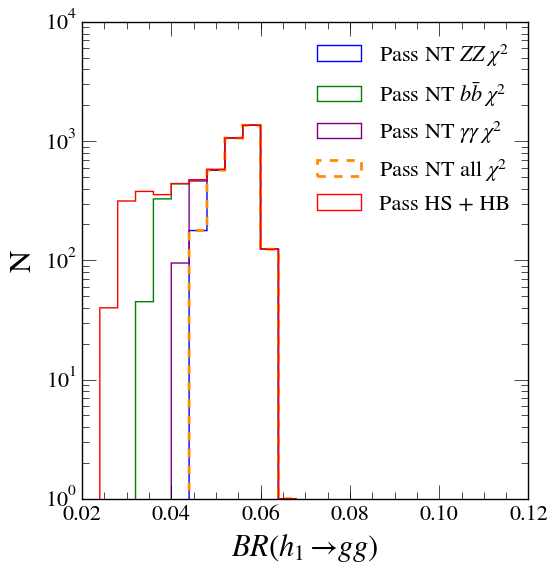

In [54]:
plot_h1gluglu_NT_HSHB(df_pass_all, '', filename='Thesis_plots_4/Couplings_BR/h1gluglu_NT_HSHB.pdf')

In [55]:
@save_fig
def plot_h1gammagamma_NT_HSHB(df, title):
    df = df.query('122.2 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')

    var = 'Brh1gammagamma'
    xlim = [0, 0.005]
    nbins = 25
    lw = 1
    norm = False
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')

    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, #linestyle='dashed',
                   errorbars=False, normed=norm)
    
    plt.xlim(*xlim)
    plt.xlabel(r'$BR(h_1 \to \gamma\gamma)$')
    plt.legend(loc='upper right', fontsize=16, frameon=False)
#     plt.ylim(1, 5E4)
    plt.yscale('log')

Setting backend pdf
Setting backend png


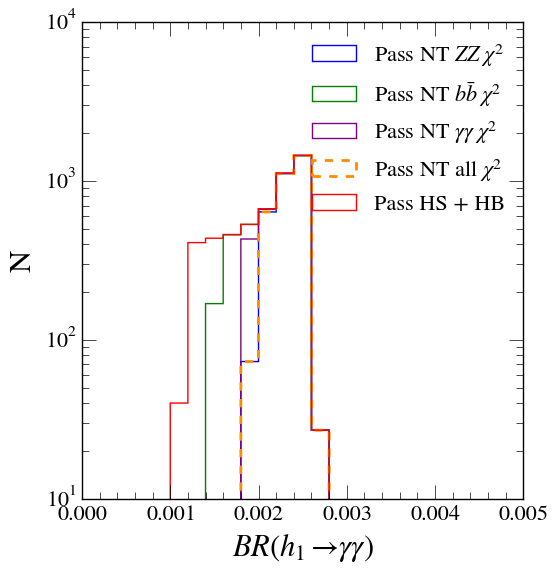

In [56]:
plot_h1gammagamma_NT_HSHB(df_pass_all, '', filename='Thesis_plots_4/Couplings_BR/h1gammagamma_NT_HSHB.pdf')

In [57]:
@save_fig
def plot_h1a1a1_NT_HSHB(df, title):
    
    df = df.query('122.1 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')
    
    var = 'Brh1a1a1'
    nbins = 25
    xlim = [0, 0.75]
    norm = False
    lw = 1
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')
    
    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, #linestyle='dashed',
                   errorbars=err, normed=norm, color='red')

    plt.xlim(*xlim)
    plt.xlabel(r'$BR(h_1 \to a_1a_1)$')
    plt.legend(loc='upper right', fontsize=16, frameon=False)
#     plt.ylim(1E-3, 1)
    plt.yscale('log')

Setting backend pdf
Setting backend png


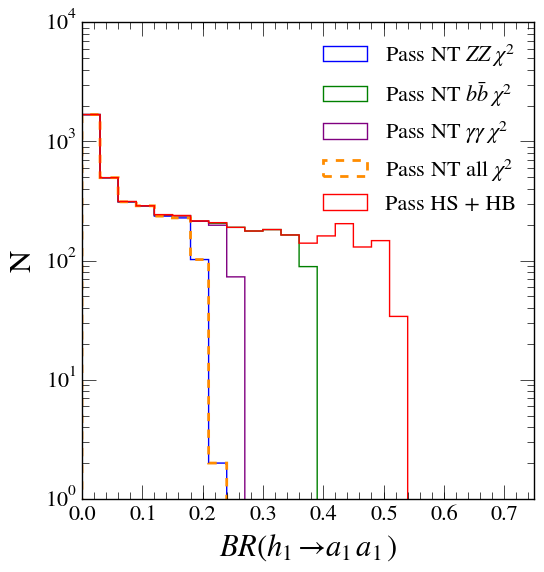

In [58]:
plot_h1a1a1_NT_HSHB(df_pass_all, '', filename='Thesis_plots_4/Couplings_BR/h1a1a1_NT_HSHB.pdf')

In [59]:
@save_fig
def plot_h1ww_NT_HSHB(df, title):
    
    df = df.query('122.1 < mh1 < 128.1 & mh2>128.1 & ma1<10.5')
    
    var = 'Brh1ww'
    nbins = 30
    xlim = [0, 0.3]
    norm = False
    lw = 1
    err = False
    
    pass_zz = ~df.constraints.str.contains('ZZ')
    plot_histogram(df=df[pass_zz], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$ZZ\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_bb = ~df.constraints.str.contains('bb')
    plot_histogram(ax=plt.gca(), df=df[pass_bb], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$b\bar{b}\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm)
    
    pass_gg = ~df.constraints.str.contains('gg')
    plot_histogram(ax=plt.gca(), df=df[pass_gg], var=var, bins=nbins, range=xlim, 
                   label='Pass NT '+r'$\gamma\gamma\ \chi^2$', histtype='step', linewidth=lw, 
                   errorbars=err, normed=norm, color='purple')

    pass_nt = ~df.constraints.str.contains('chi2')
    plot_histogram(ax=plt.gca(), df=df[pass_nt], var=var, bins=nbins, range=xlim, 
                   label='Pass NT all '+r'$\chi^2$', histtype='step', linewidth=2*lw, 
                   errorbars=err, normed=norm, color='darkorange', linestyle='dashed')
    
    pass_HBHS = (df.HBresult==1) & (df.HSprob>0.05)
    plot_histogram(ax=plt.gca(), df=df[pass_HBHS], var=var, bins=nbins, range=xlim, 
                   label='Pass HS + HB', histtype='step', linewidth=lw, #linestyle='dashed',
                   errorbars=err, normed=norm, color='red')

    plt.xlim(*xlim)
    plt.xlabel(r'$BR(h_1 \to WW)$')
    plt.legend(loc='upper left', fontsize=16, frameon=False)
#     plt.ylim(1E-3, 1)
    plt.yscale('log')

Setting backend pdf
Setting backend png


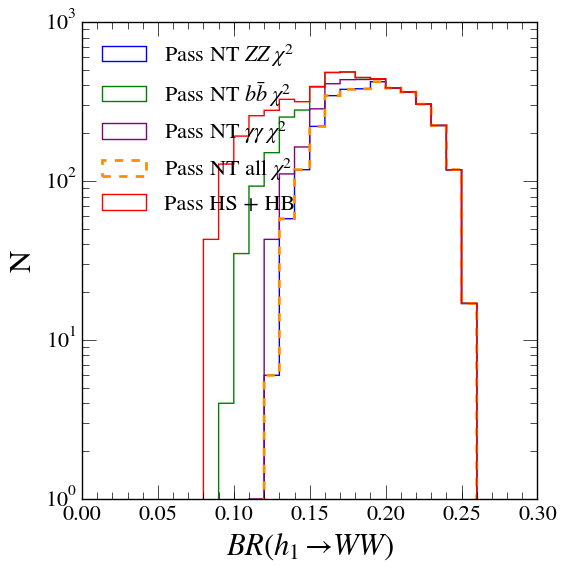

In [60]:
plot_h1ww_NT_HSHB(df_pass_all.query('ma1<10.5'), '', filename='Thesis_plots_4/Couplings_BR/h1ww_NT_HSHB.pdf')

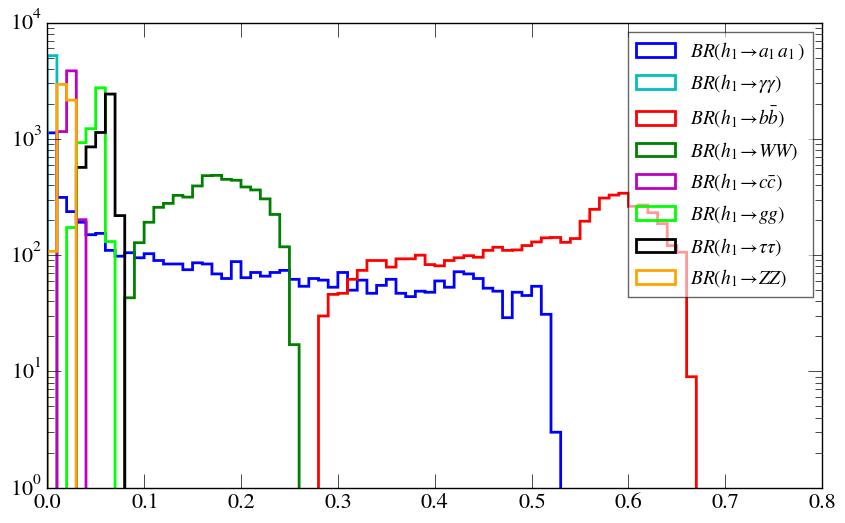

In [62]:
df = df_pass_all
cols = ['Brh1a1a1','Brh1gammagamma', 'Brh1bb', 'Brh1ww', 'Brh1cc', 'Brh1gg', 'Brh1tautau', 'Brh1zz']
df = df.query('HSprob>0.05 & HBresult==1 & 122.1<mh1<128.1 & mh2>128.1 & ma1<10.5')[cols]
cols_tex = [r'$BR(h_1\to a_1a_1)$', r'$BR(h_1\to \gamma\gamma)$', 
            r'$BR(h_1\to b\bar{b})$', r'$BR(h_1\to WW)$', r'$BR(h_1\to c\bar{c})$', 
            r'$BR(h_1\to gg)$', r'$BR(h_1\to \tau\tau)$', r'$BR(h_1\to ZZ)$']
df.columns = cols_tex
fig, ax = generate_fig_axes(size=[10,6])
colors = ["b","c","r","g","m","lime","k","orange"]
for i, v in enumerate(cols_tex):
    ax.hist(df[v].values, bins=75, range=[0,0.75], label=v, histtype='step', 
            color=colors[i], linestyle='solid', linewidth=2)
plt.legend(fontsize=14)
plt.yscale('log')

In [63]:
@save_fig
def plot_h1BR_corrs(df, title):
    cols = ['Brh1a1a1', 'Brh1zz', 'Brh1gammagamma', 'Brh1bb', 'Brh1ww', 'Brh1cc', 'Brh1gg', 'Brh1tautau']
    df = df.query('122.1<mh1<128.1 & mh2>128.1 & ma1<10.5')[cols]
    cols_tex = [r'$BR(h_1\to a_1a_1)$', r'$BR(h_1\to ZZ)$', r'$BR(h_1\to \gamma\gamma)$', 
                r'$BR(h_1\to b\bar{b})$', r'$BR(h_1\to WW)$', r'$BR(h_1\to c\bar{c})$', 
                r'$BR(h_1\to gg)$', r'$BR(h_1\to \tau\tau)$']
    df.columns = cols_tex
    pd.tools.plotting.scatter_matrix(df, figsize=[22, 22], alpha=0.7, grid=True, hist_kwds={'bins': 25}, color='red')
    plt.suptitle(title, y=0.93)

Setting backend png
Setting backend png


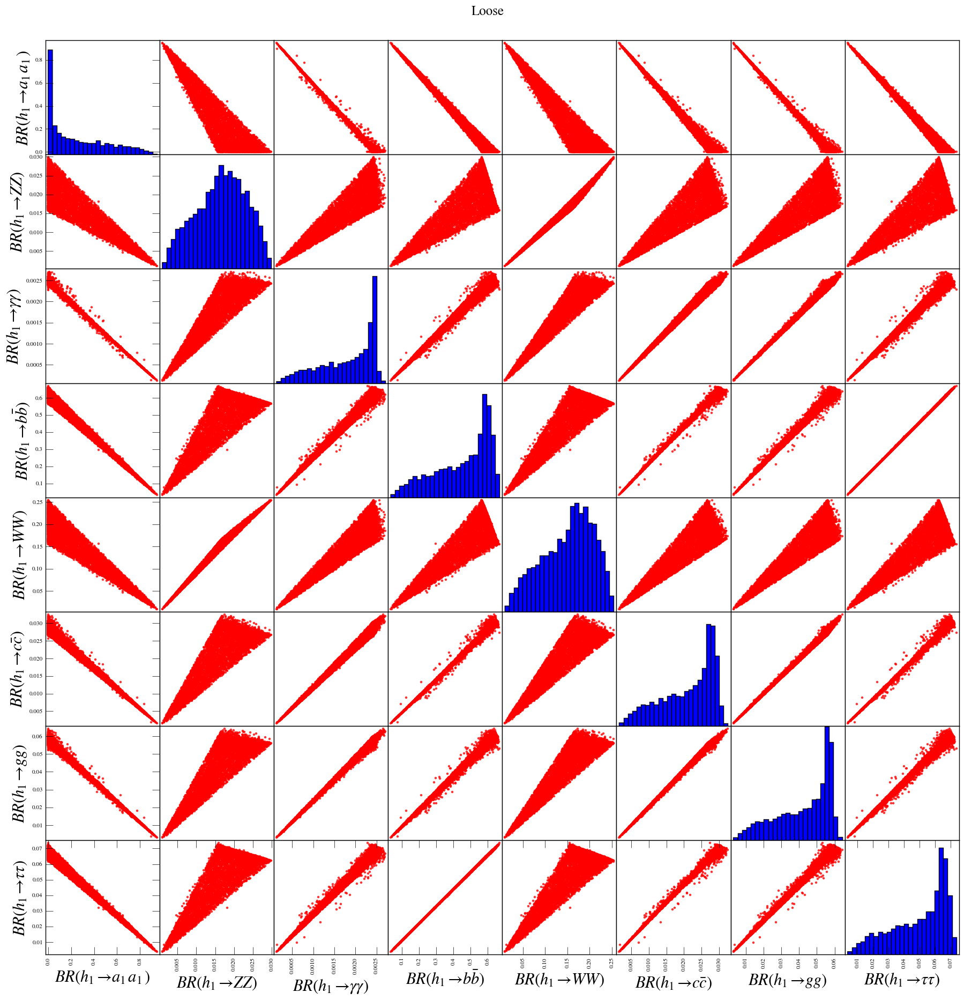

In [64]:
plot_h1BR_corrs(df_pass_all, 'Loose', filename='Thesis_plots_4/Couplings_BR/h1br_corr_loose.png')

Setting backend png
Setting backend png


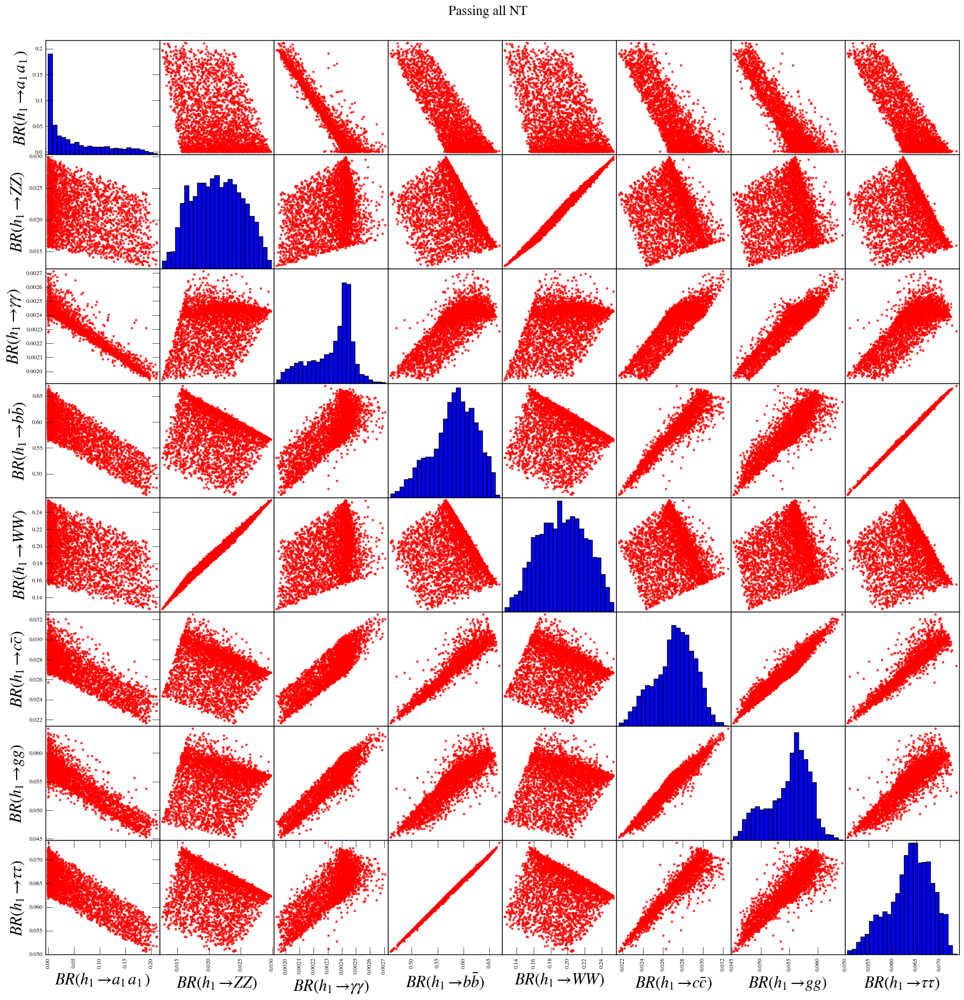

In [65]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], 
                'Passing all NT', filename='Thesis_plots_4/Couplings_BR/h1br_corr_NT.png')

Setting backend png
Setting backend png


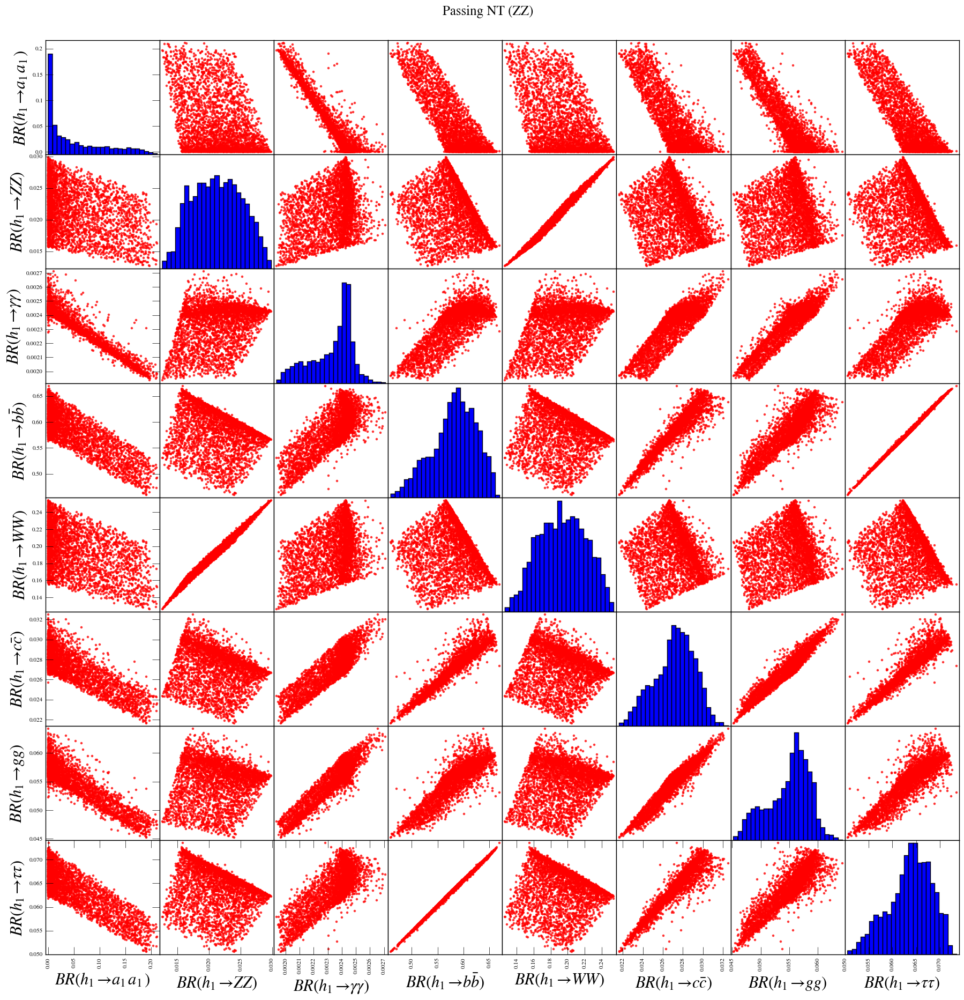

In [66]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('ZZ')], 
                'Passing NT (ZZ)', filename='Thesis_plots_4/Couplings_BR/h1br_corr_NT_ZZ.png')

Setting backend png
Setting backend png


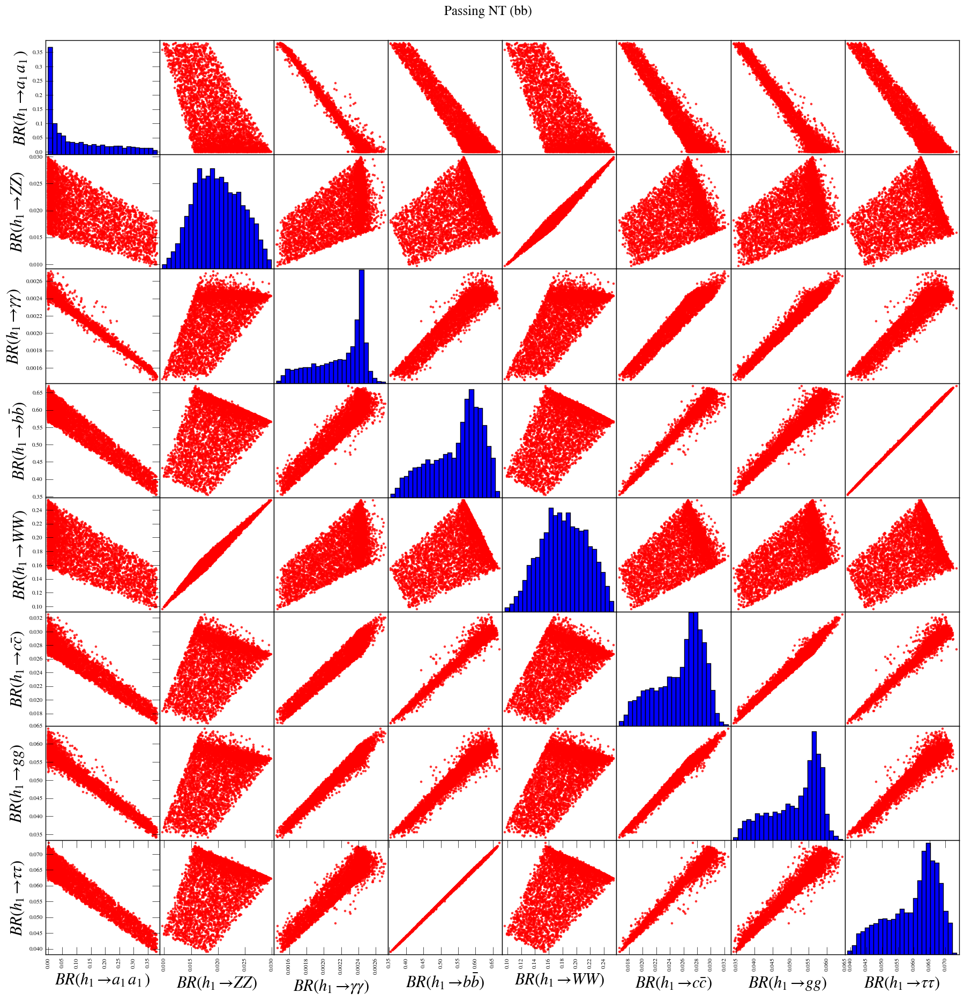

In [67]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('bb')], 
                'Passing NT (bb)', filename='Thesis_plots_4/Couplings_BR/h1br_corr_NT_bb.png')

Setting backend png
Setting backend png


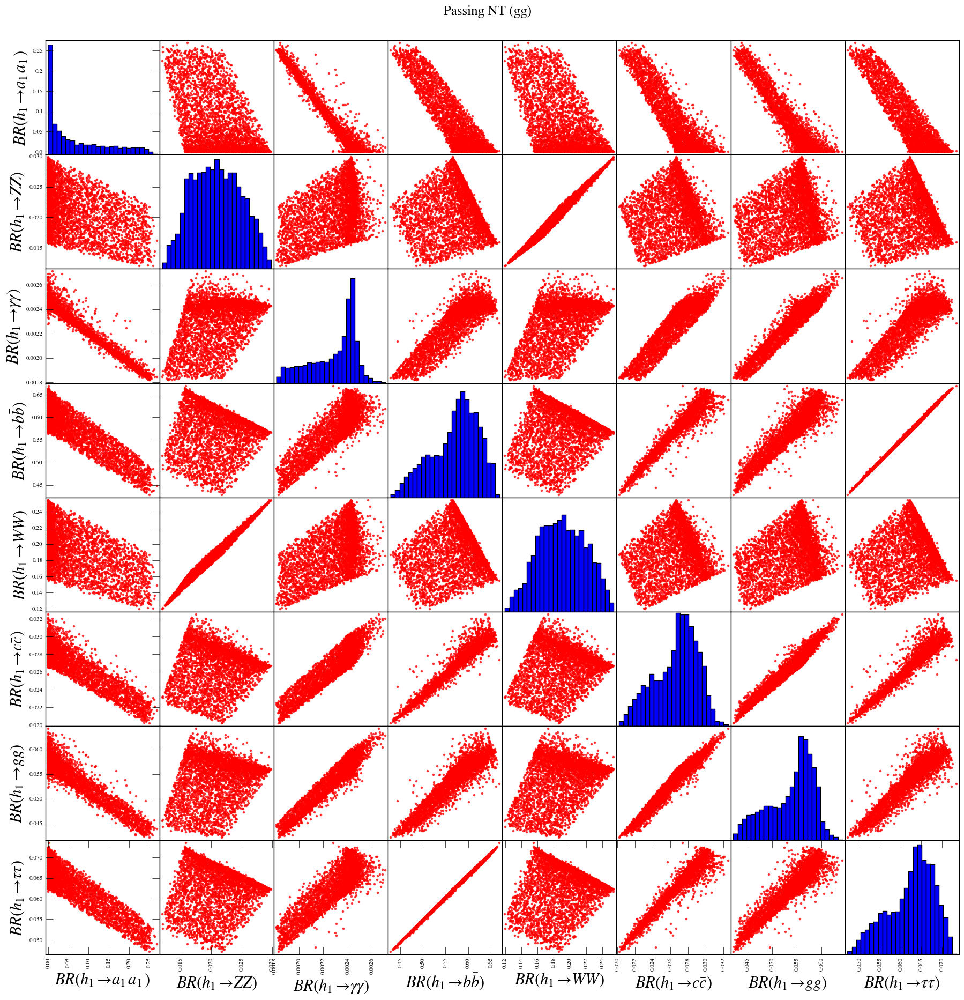

In [68]:
plot_h1BR_corrs(df_pass_all[~df_pass_all.constraints.str.contains('gg')], 
                'Passing NT (gg)', filename='Thesis_plots_4/Couplings_BR/h1br_corr_NT_gg.png')

In [69]:
@save_fig
def plot_bra1_ma1(df, title):
    fig, ax = generate_fig_axes()
    plot_scatter(ax = ax, df=df, xvar='ma1', yvar='Bra1tautau', color='green', label=r'$\tau\tau$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1mumu', color='red', label=r'$\mu\mu$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1bb', color='blue', label=r'$b\bar{b}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1cc', color='orange', label=r'$c\bar{c}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1ss', color='fuchsia', label=r'$s\bar{s}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='ma1', yvar='Bra1gg', color='purple', label=r'$gg$', s=SIZE)
    plt.xlim(0, 25)
    plt.ylim(1E-3, 1.2)
    plt.yscale('log')
    plt.legend(loc='lower right', fontsize=16, framealpha=0.85)
    plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
    plt.ylabel(r'$BR(a_1 \to XX)$')
    plt.tight_layout()

Setting backend png
Setting backend png


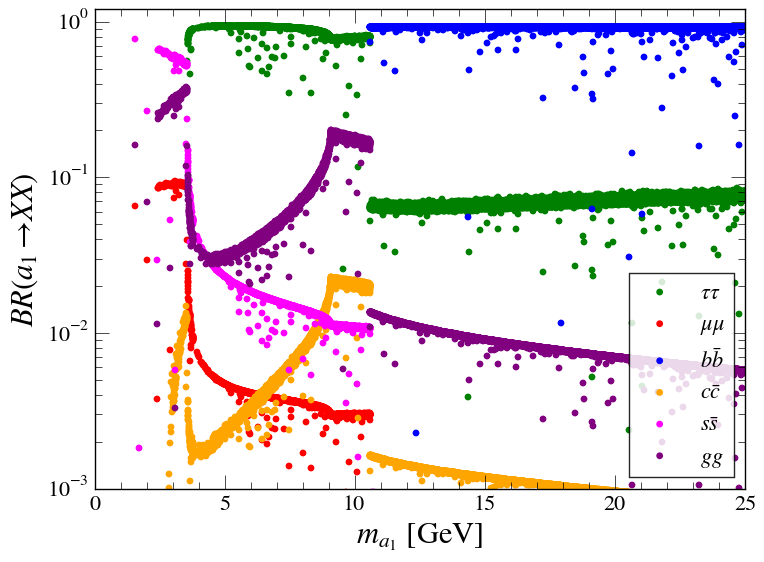

In [70]:
plot_bra1_ma1(df_pass_all[~df_pass_all.constraints.str.contains('chi2')], title, filename='Thesis_plots_4/Couplings_BR/bra1_ma1.png')

Setting backend png
Setting backend png


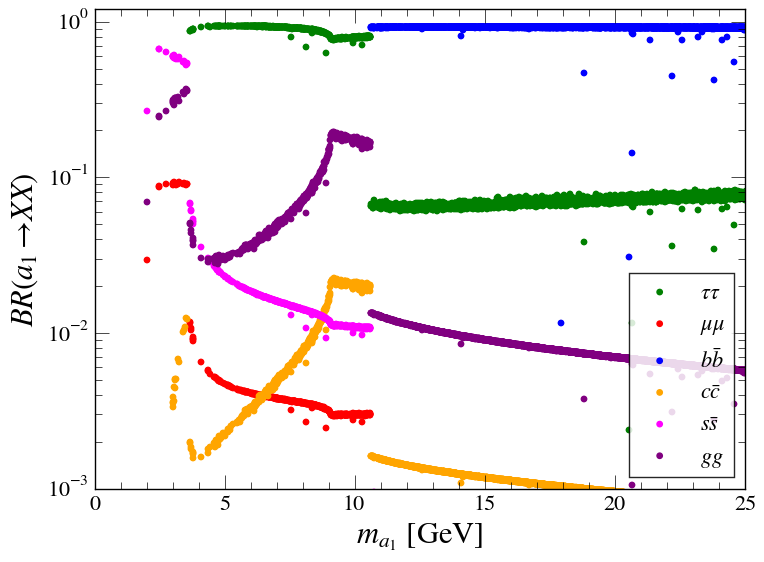

In [71]:
plot_bra1_ma1(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
              title, filename='Thesis_plots_4/Couplings_BR/bra1_ma1_strict.png')

In [72]:
@save_fig
def plot_brh1_mh1(df, title):
    fig, ax = generate_fig_axes()
    plot_scatter(ax = ax, df=df, xvar='mh1', yvar='Brh1tautau', color='green', label=r'$\tau\tau$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1mumu', color='red', label=r'$\mu\mu$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1bb', color='blue', label=r'$b\bar{b}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1cc', color='orange', label=r'$c\bar{c}$', s=SIZE)
#     plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1ss', color='fuchsia', label=r'$s\bar{s}$', s=SIZE)
    plot_scatter(ax=plt.gca(), df=df, xvar='mh1', yvar='Brh1gg', color='purple', label=r'$gg$', s=SIZE)
    plt.xlim(0, 25)
    plt.ylim(1E-3, 1.2)
    plt.yscale('log')
    plt.legend(loc='best', fontsize=16, framealpha=0.85)
    plt.xlabel(r'$m_{h_1}\ \mathrm{[GeV]}$')
    plt.ylabel(r'$BR(h_1 \to XX)$')

Setting backend png
Setting backend png


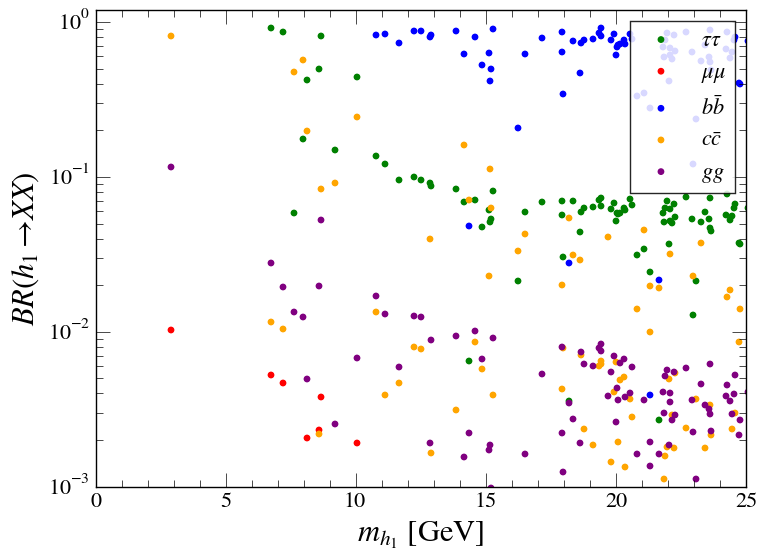

In [73]:
plot_brh1_mh1(df_pass_all, title, filename='Thesis_plots_4/Couplings_BR/brh1_mh1.png')

# Cross-sections 

<matplotlib.colorbar.Colorbar instance at 0x16ad453f8>

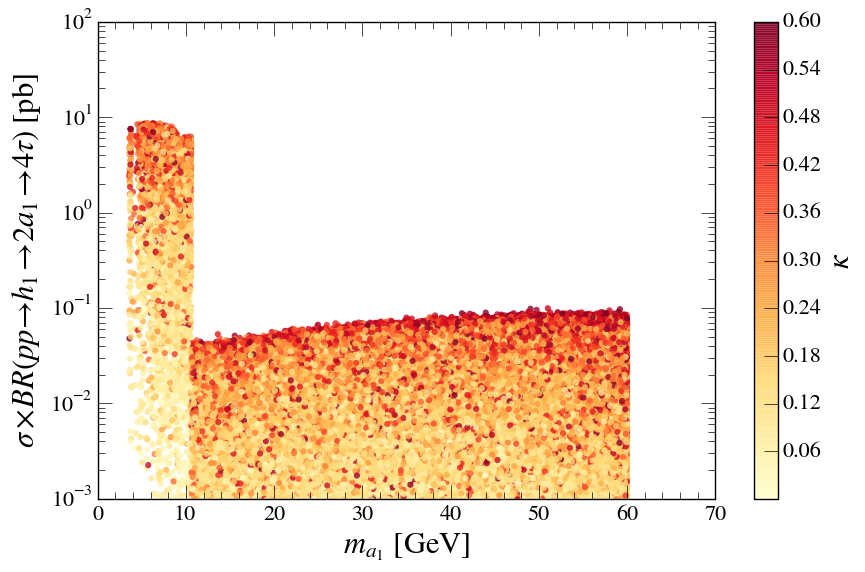

In [187]:
fig, ax = generate_fig_axes(size=[9,6])
q_str = '122.1<mh1<128.1 & HSprob>0.05 & HBresult==1 & 0.<omega<0.16'
_, s = plot_scatter(ax=ax, df=df_pass_all.query(q_str),
                    xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', marker='o', 
                    c=df_pass_all.query(q_str)['kappa'].values, 
                    cmap=plt.get_cmap('YlOrRd'), alpha=0.8, linewidths=0)
plt.ylim(1E-3, 100)
plt.yscale('log')
plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
plt.ylabel(r'$\sigma\times BR (pp \to h_1 \to 2a_1 \to 4\tau)\ \mathrm{[pb]}$')
fig.colorbar(s, label=r'$\kappa$')

<matplotlib.colorbar.Colorbar instance at 0x16d36fcf8>

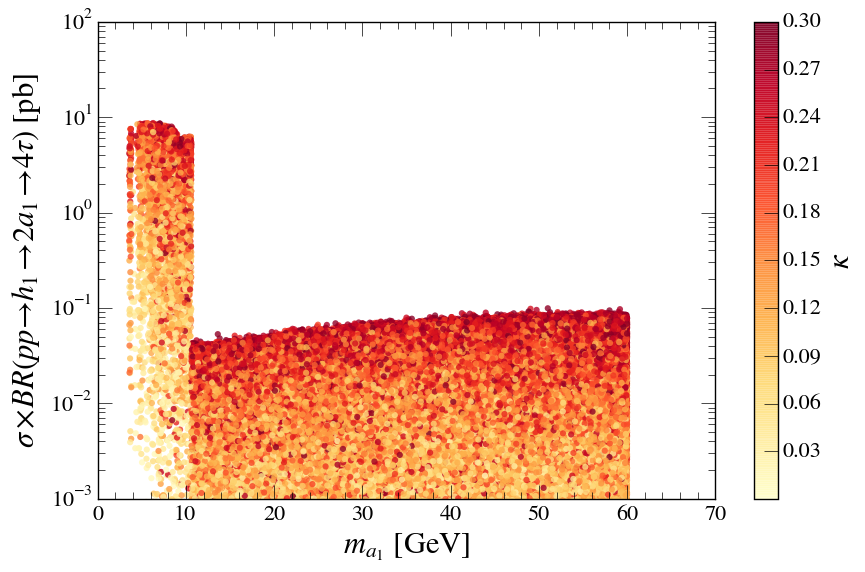

In [191]:
fig, ax = generate_fig_axes(size=[9,6])
q_str = '122.1<mh1<128.1 & HSprob>0.05 & HBresult==1 & 0.<omega<0.16'
_, s = plot_scatter(ax=ax, df=df_pass_all.query(q_str),
                    xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', marker='o', 
                    c=df_pass_all.query(q_str)['lambda_'].values, 
                    cmap=plt.get_cmap('YlOrRd'), alpha=0.8, linewidths=0)
plt.ylim(1E-3, 100)
plt.yscale('log')
plt.xlabel(r'$m_{a_1}\ \mathrm{[GeV]}$')
plt.ylabel(r'$\sigma\times BR (pp \to h_1 \to 2a_1 \to 4\tau)\ \mathrm{[pb]}$')
fig.colorbar(s, label=r'$\kappa$')

1.07 1.23


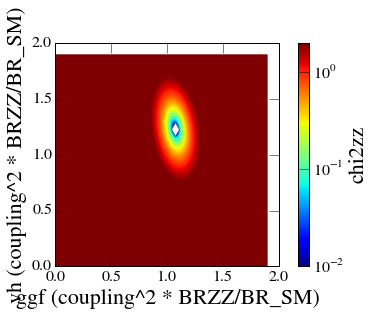

In [946]:
azz=43.29
bzz=4.91
czz=9.61
mugcenzz=1.07
muvcenzz=1.23

def chi2zz(ggf_vv, vh_vv):
    return azz*(ggf_vv-mugcenzz)**2+czz*(vh_vv-muvcenzz)**2+2*bzz*(ggf_vv-mugcenzz)*(vh_vv-muvcenzz)

ggf_vv = np.arange(0, 1.9, 0.01)
vh_vv = np.arange(0, 1.9, 0.01)

chi2 = np.empty([len(ggf_vv), len(vh_vv)])
for i, x in enumerate(ggf_vv):
    for j, y in enumerate(vh_vv):
        chi2[i,j] = chi2zz(x, y)

plt.imshow(chi2.T, interpolation=None, origin='lower', 
#            cmap=plt.get_cmap('summer'), 
           norm=mpl.colors.LogNorm(vmin=0.01, vmax=100),
           extent=[ggf_vv.min(), ggf_vv.max(), vh_vv.min(), vh_vv.max()],
           vmin=0.01, vmax=2)
plt.colorbar(label='chi2zz')

plt.xlabel('ggf (coupling^2 * BRZZ/BR_SM)')
plt.ylabel('vh (coupling^2 * BRZZ/BR_SM)')
min_x_ind, min_y_ind = np.unravel_index(chi2.argmin(), chi2.shape)
print ggf_vv[min_x_ind], vh_vv[min_y_ind]
plt.plot(ggf_vv[min_x_ind], vh_vv[min_y_ind], 'd', c='white', markersize=10)
# print plt.xticks
# plt.gca().set_xticks(ggf_vv)

In [95]:
def plot_xsec_4tau_inputparams(df, title):
    plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$', 
                               yrange=[0.01,10], param_dict=nmssm_params_extended)
#     plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel='\sigma \times BR()')
    plt.suptitle(title)
    fig = plt.gcf()
    for ax in fig.axes:
        ax.set_yscale('log')

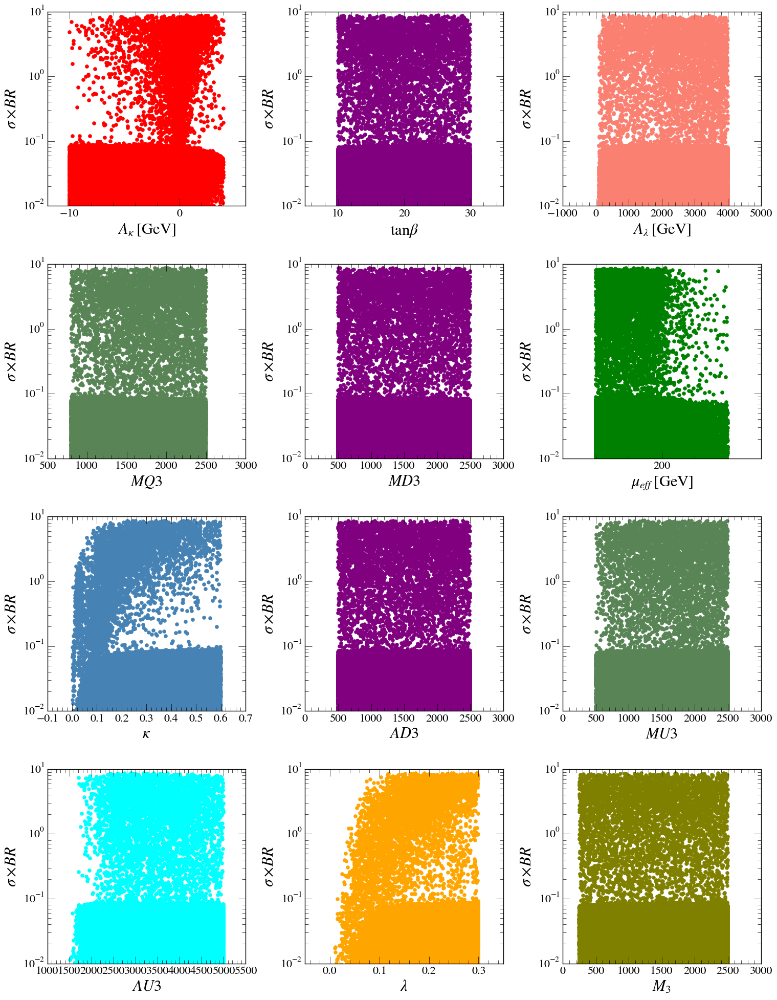

In [96]:
plot_xsec_4tau_inputparams(df_pass_all.query('HSprob>0.05 & HBresult==1'), title='')
# df = df_pass_all.query('HSprob>0.05 & HBresult==1')
# plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$')
# fig = plt.gcf()

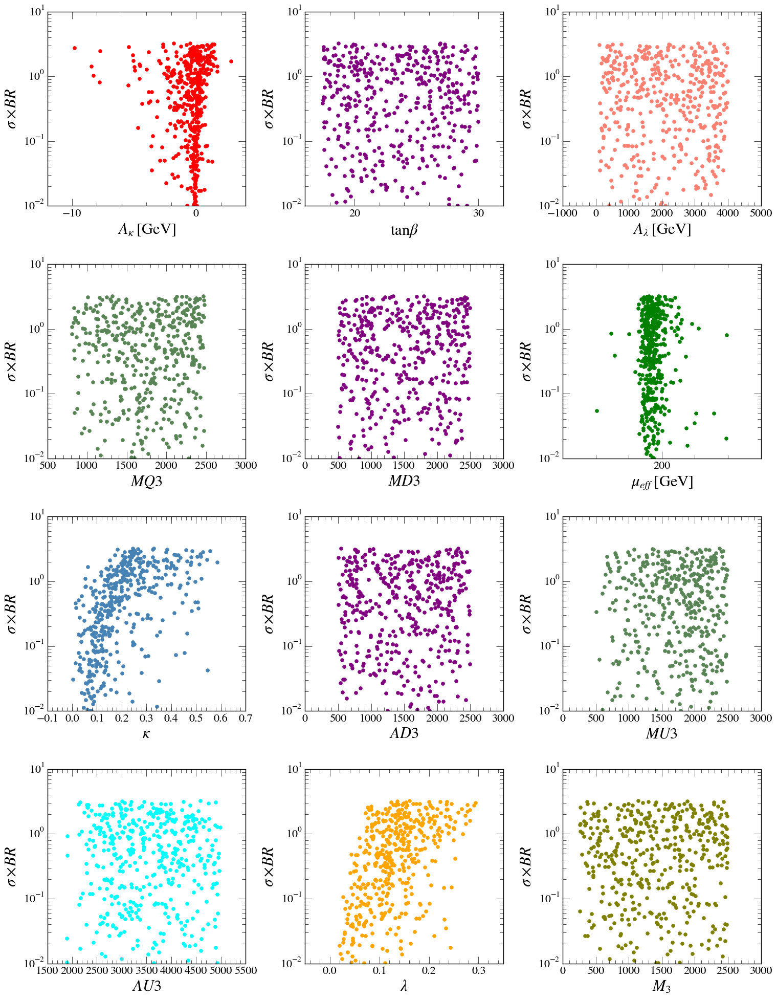

In [97]:
plot_xsec_4tau_inputparams(df_pass_all[df_pass_all.constraints=='b -> c tau nu more than 2 sigma away (as SM)'].query('ma1<10.5'), title='')
# df = df_pass_all.query('HSprob>0.05 & HBresult==1')
# plot_input_params_scatters(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', ylabel=r'$\sigma \times BR$')
# fig = plt.gcf()

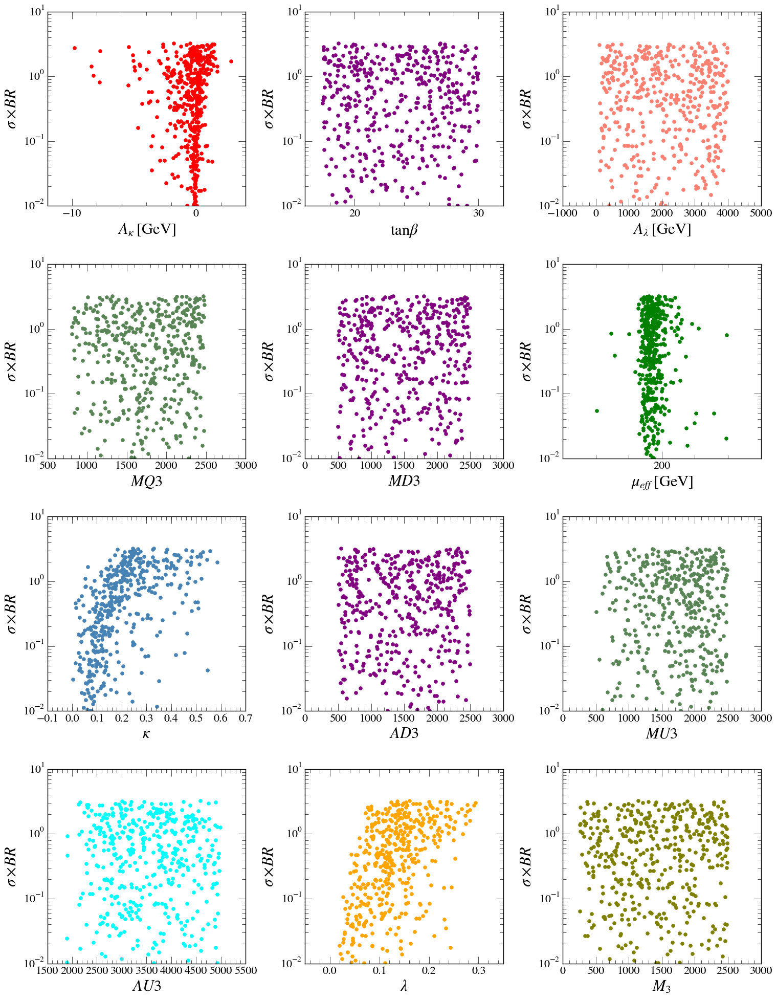

In [97]:
plot_xsec_4tau_inputparams(df_pass_all[df_pass_all.constraints=='b -> c tau nu more than 2 sigma away (as SM)'].query('ma1<10.5'), 
                           title='')

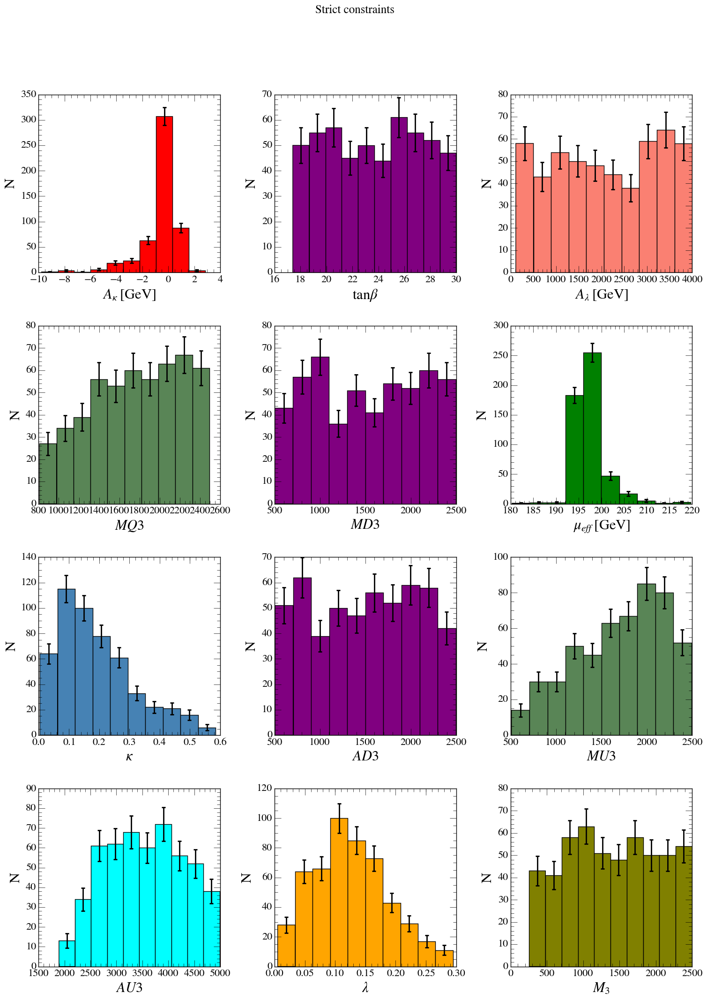

In [194]:
plot_input_params_hists(df_pass_all[df_pass_all.constraints=='b -> c tau nu more than 2 sigma away (as SM)'].query('ma1<10.5'),
                        ylabel='N', title='Strict constraints', param_dict=nmssm_params_extended)


In [119]:
from pandas.tools.plotting import parallel_coordinates

In [190]:
cols = ['HS_%d_chi2' % x for x in range(1, 86)]

df_HS = df_pass_all.query('ma1<10.5')[cols]

df_HS['passHS'] = (df_pass_all.HSprob>0.05) & (df_pass_all.HBresult==1)

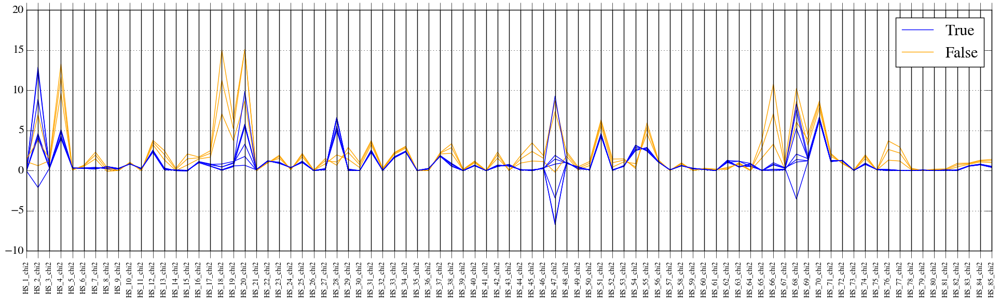

In [194]:
fig = plt.figure(figsize=[24, 6])
ax = parallel_coordinates(df_HS.iloc[0:10], 'passHS', color=['blue', 'orange'])
ax.tick_params(axis='x', which='major', labelsize=10, direction=90)
plt.legend(framealpha=1)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_rotation(90)

# With New Higgs Constraints

In [1486]:
atlas.columns

Index([u'Unnamed: 0', u'm_a', u'br_4tau', u'xsec_br_4tau', u'xsec_br_2tau2mu',
       u'xsec_br_4mu', u'br_2tau2mu', u'br_4mu'],
      dtype='object')

In [1479]:
experiments = [
    {'df': cms_tau_19, 'label': 'CMS HIG-14-019 ' + r'$(4\tau)$', 'color': 'blue'},
    {'df': cms_tau_22, 'label': 'CMS HIG-14-022 ' + r'$(4\tau)$', 'color': 'green'},
    {'df': atlas, 'label': 'ATLAS HIGG-2014-02 ' + r'$(2\tau2\mu)$', 'color': 'red'},
]

In [1558]:
import Exp_limits.commonPlot as plotr

In [1591]:
len(df_pass_all['h1ggrc2'] * df_pass_all['Brh1a1a1'] * df['Bra1tautau'] * df['Bra1tautau'] )

259021

In [1596]:
df_pass_all.reset_index(inplace=True)

In [1597]:
# df_pass_all.drop('xsec_scaled_ggf_h1_2a1_4tau', axis=1, inplace=True)
# df_pass_all.drop('xsec_scaled_ggf_h2_2a1_4tau', axis=1, inplace=True)
# df_pass_all.drop('xsec_scaled_ggf_h2_2h1_4tau', axis=1, inplace=True)


df_pass_all['xsec_scaled_ggf_h1_2a1_4tau'] = df_pass_all['h1ggrc2'] * df_pass_all['Brh1a1a1'] * df['Bra1tautau'] * df['Bra1tautau'] 
df_pass_all['xsec_scaled_ggf_h2_2a1_4tau'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2a1a1'] * df['Bra1tautau'] * df['Bra1tautau']
df_pass_all['xsec_scaled_ggf_h2_2h1_4tau'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2h1h1'] * df['Brh1tautau'] * df['Brh1tautau']

ValueError: cannot reindex from a duplicate axis

In [ ]:
df_pass_all['xsec_scaled_ggf_h1_2a1_4mu'] = df_pass_all['h1ggrc2'] * df_pass_all['Brh1a1a1'] * df['Bra1mumu'] * df['Bra1mumu']
df_pass_all['xsec_scaled_ggf_h2_2a1_4mu'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2a1a1'] * df['Bra1mumu'] * df['Bra1mumu']
df_pass_all['xsec_scaled_ggf_h2_2h1_4mu'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2h1h1'] * df['Brh1mumu'] * df['Brh1mumu']

In [ ]:
df_pass_all['xsec_scaled_ggf_h1_2a1_2tau2mu'] = df_pass_all['h1ggrc2'] * df_pass_all['Brh1a1a1'] * df['Bra1tautau'] * df['Bra1mumu'] * 2.
df_pass_all['xsec_scaled_ggf_h2_2a1_2tau2mu'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2a1a1'] * df['Bra1tautau'] * df['Bra1mumu'] * 2.
df_pass_all['xsec_scaled_ggf_h2_2h1_2tau2mu'] = df_pass_all['h2ggrc2'] * df_pass_all['Brh2h1h1'] * df['Brh1tautau'] * df['Brh1mumu'] * 2.

In [1571]:
scan_dict_h1 = [
    {'df': df_pass_all.query('HSprob>0.05 & HBresult==1'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_1$)", 'color': 'dodgerblue', 'shape': '^'},
    {'df': df_pass_all[~df_pass_all.constraints.str.contains('chi2')].query('HSprob>0.05 & HBresult==1'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_1$)", 'color': 'darkorange', 'shape': '^'},
]

In [1572]:
scan_dict_h2 = [
    {'df': df_pass_all.query('HSprob>0.05 & HBresult==1'), 
     'label': "HiggsSignals/Bounds only ($h_i\ =\ h_2$)", 'color': 'blue', 'shape': 'v'},
    {'df': df_pass_all[~df_pass_all.constraints.str.contains('chi2')].query('HSprob>0.05 & HBresult==1'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_2$)", 'color': 'red', 'shape': 'v'},
]

In [1545]:
scan_dict_h2_h1 = [
    {'df': df_pass_all.query('HSprob>0.05 & HBresult==1'), 
     'label': "HiggsSignals|Bounds only ($h_i\ =\ h_2$)", 'color': 'green', 'shape': 's'},
    {'df': df_pass_all[~df_pass_all.constraints.str.contains('chi2')].query('HSprob>0.05 & HBresult==1'), 
     'label': "+ NMSSMTools ($h_i\ =\ h_2$)", 'color': 'fuchsia', 'shape': 's'},
]

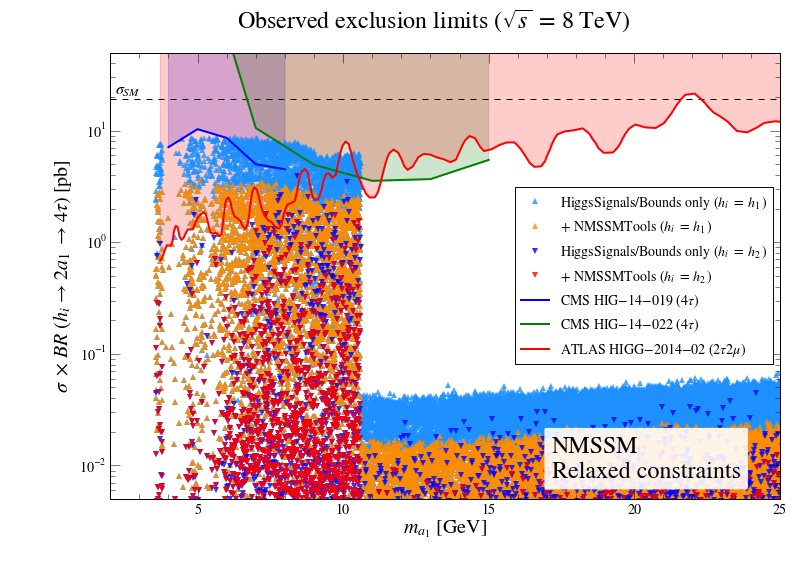

In [1573]:
ylim = [5E-3, 50]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', x_var='mh1',
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='xsec_br_4tau', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.66, 0.05], leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(12, 8)

In [1579]:
df.columns.values

array(['Bra1bb', 'Bra1cc', 'Bra1gg', 'Bra1mumu', 'Bra1ss', 'Bra1tautau',
       'Brh1a1a1', 'Brh1a1z', 'Brh1bb', 'Brh1cc', 'Brh1gammagamma',
       'Brh1gg', 'Brh1mumu', 'Brh1tautau', 'Brh1ww', 'Brh1zgamma',
       'Brh1zz', 'Brh2a1a1', 'Brh2a1z', 'Brh2bb', 'Brh2gammagamma',
       'Brh2gg', 'Brh2h1h1', 'Brh2tautau', 'Brh2ww', 'Brh2zgamma',
       'Brh2zz', 'Del_a_mu', 'HBchannel', 'HBobsratio', 'HBresult',
       'HS_10_chi2', 'HS_10_muPred', 'HS_11_chi2', 'HS_11_muPred',
       'HS_12_chi2', 'HS_12_muPred', 'HS_13_chi2', 'HS_13_muPred',
       'HS_14_chi2', 'HS_14_muPred', 'HS_15_chi2', 'HS_15_muPred',
       'HS_16_chi2', 'HS_16_muPred', 'HS_17_chi2', 'HS_17_muPred',
       'HS_18_chi2', 'HS_18_muPred', 'HS_19_chi2', 'HS_19_muPred',
       'HS_1_chi2', 'HS_1_muPred', 'HS_20_chi2', 'HS_20_muPred',
       'HS_21_chi2', 'HS_21_muPred', 'HS_22_chi2', 'HS_22_muPred',
       'HS_23_chi2', 'HS_23_muPred', 'HS_24_chi2', 'HS_24_muPred',
       'HS_25_chi2', 'HS_25_muPred', 'HS_26_chi2', 'HS_

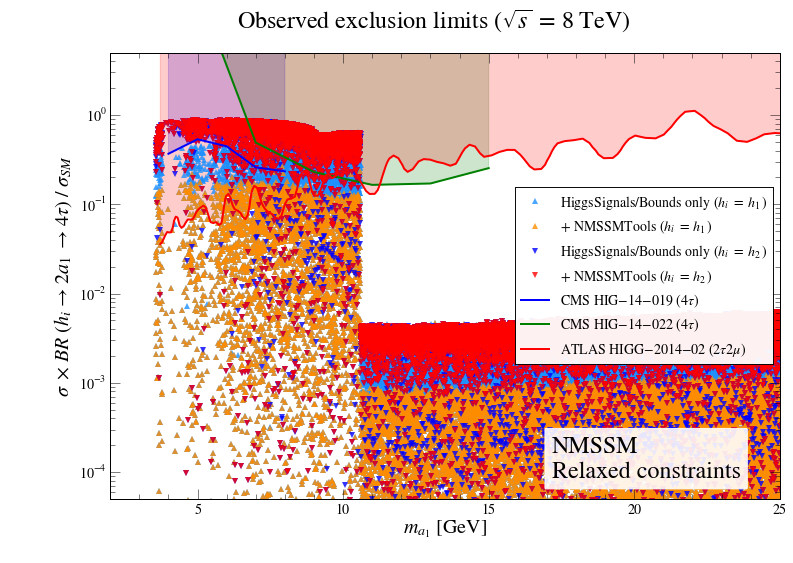

In [1578]:
ylim = [5E-5, 5]
xlim = [2, 25]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_scaled_ggf_h1_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_scaled_ggf_h2_2a1_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', x_var='mh1',
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='br_4tau', 
                           x_label=M_A1_STR, y_label=BR_Hi_2A1_4TAU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.66, 0.05], leg_loc='center right')

plt.gcf().set_size_inches(12, 8)

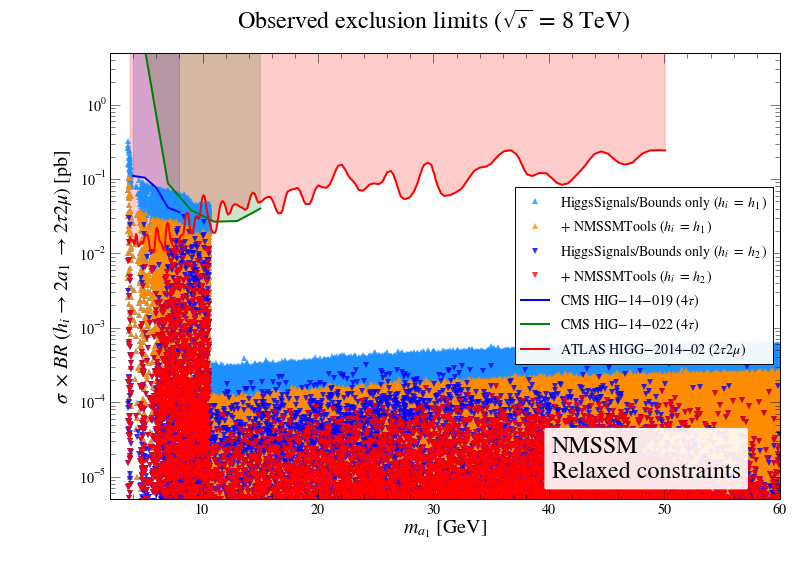

In [1575]:
ylim = [5E-6, 5]
xlim = [2, 60]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', x_var='mh1',
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='xsec_br_2tau2mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_2TAU2MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.66, 0.05], leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(12, 8)

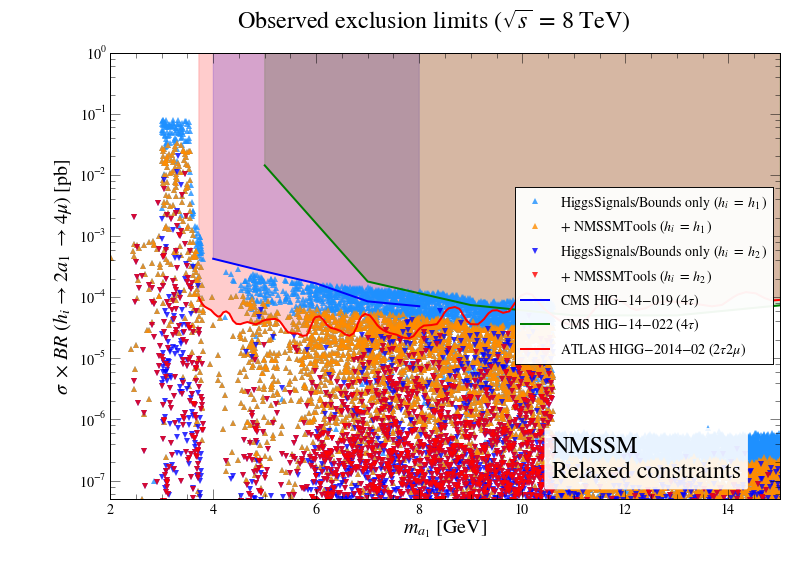

In [1576]:
ylim = [5E-8, 1]
xlim = [2, 15]
title = 'Observed exclusion limits ' + r'$( \sqrt{s}\ =\ 8\ \mathrm{TeV})$'
common_text = 'NMSSM\nRelaxed constraints'
plotr.plot_scan_exclusions(scan_dict_h1, experimental_dicts=None, y_var='xsec_8_ggf_h1_2a1_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(scan_dict_h2, experimental_dicts=None, y_var='xsec_8_ggf_h2_2a1_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, shade=False, 
                           y_range=ylim, x_range=xlim)
# plotr.plot_scan_exclusions(scan_dict_h2_h1, experimental_dicts=None, y_var='xsec_8_ggf_h2_2h1_4tau', x_var='mh1',
#                            x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4TAU_STR, shade=False, 
#                            y_range=ylim, x_range=xlim)
plotr.plot_scan_exclusions(None, experiments, y_var='xsec_br_4mu', 
                           x_label=M_A1_STR, y_label=XSEC_BR_Hi_2A1_4MU_STR, 
                           y_range=ylim, x_range=xlim, 
                           title=title, text=common_text, text_coords=[0.66, 0.05], leg_loc='center right')
if plt.ylim()[1] > plotr.XSEC_SM:
    plotr.draw_xsec_sm()
plt.gcf().set_size_inches(12, 8)

In [952]:
df = df_pass_all_ma1.query('HSprob>0.05 & HBresult==1')

(0, 5)

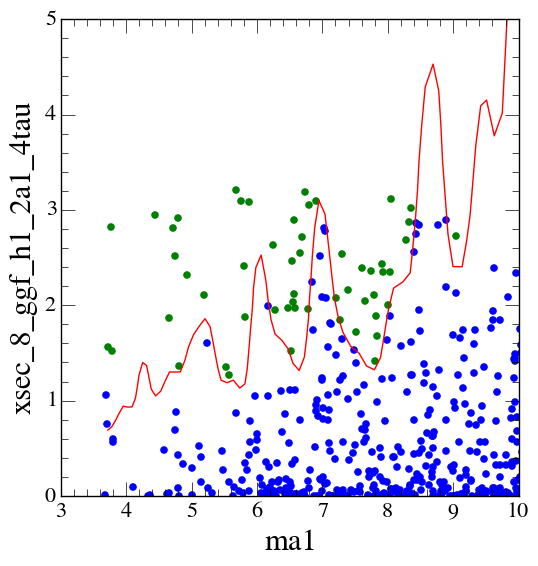

In [167]:
plot_scatter(df=df[df.constraints=='b -> c tau nu more than 2 sigma away (as SM)'].query('pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
             xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', color='blue')
plot_scatter(ax=plt.gca(), df=df[df.constraints=='b -> c tau nu more than 2 sigma away (as SM)'].query('not pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
             xvar='ma1', yvar='xsec_8_ggf_h1_2a1_4tau', color='green')
plt.plot(atlas.m_a.values, atlas.xsec_br_4tau.values, 'r')
# plt.yscale('log')
# plt.ylim(1E-3, 10)
plt.xlim(3, 10)
plt.ylim(0, 5)

In [996]:
df['kap_lam_sq'] = df.kappa*df.kappa + df.lambda_*df.lambda_

/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [1022]:
df['kap_lam'] = df.kappa + df.lambda_

/Users/robina/.virtualenvs/NMSSMScan/lib/python2.7/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


(0.001, 10)

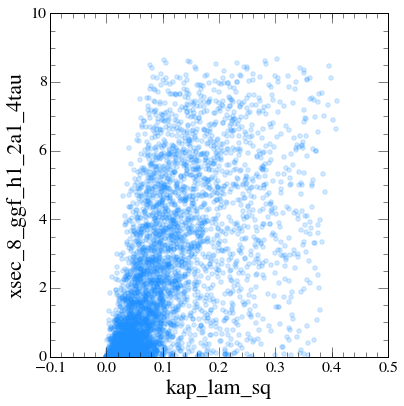

In [1033]:
plot_scatter(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam_sq', alpha=0.2, color='dodgerblue')
# plt.yscale('log')
plt.ylim(1E-3, 10)

(2, 10)

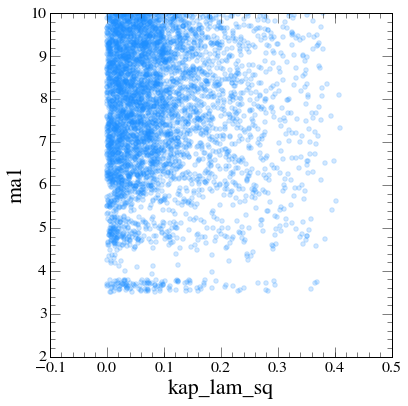

In [1045]:
plot_scatter(df=df, yvar='ma1', xvar='kap_lam_sq', alpha=0.2, color='dodgerblue')
# plt.yscale('log')
plt.ylim(2, 10)

(0.001, 8)

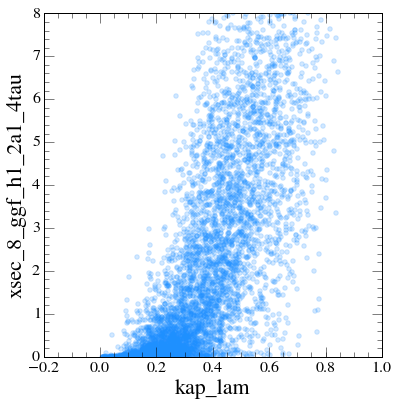

In [1037]:
plot_scatter(df=df, yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam', alpha=0.2, color='dodgerblue')
# plt.yscale('log')
plt.ylim(1E-3, 8)

(2, 10)

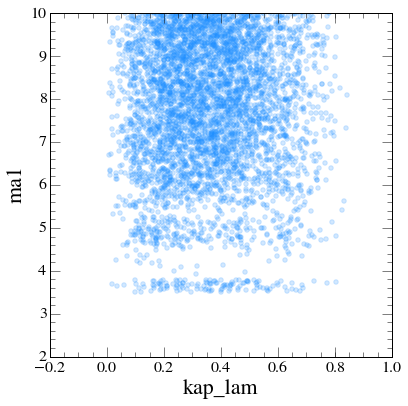

In [1046]:
plot_scatter(df=df, yvar='ma1', xvar='kap_lam', alpha=0.2, color='dodgerblue')
# plt.yscale('log')
plt.ylim(2, 10)

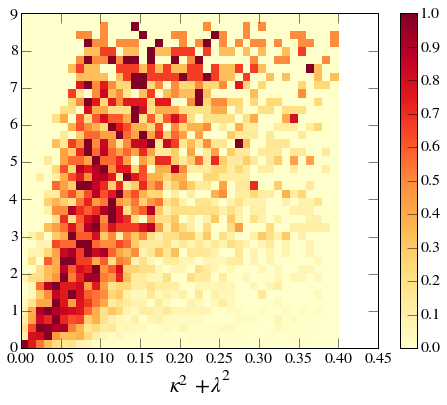

In [1042]:
_ = plot_histogram2d(df=df.dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam_sq', 
                     range=[[0, 0.4],[0, 9]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')
plt.xlabel(r'$\kappa^2 + \lambda^2$')

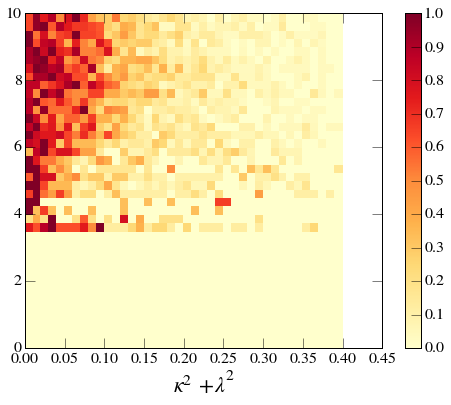

In [1048]:
_ = plot_histogram2d(df=df.dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='ma1', xvar='kap_lam_sq', 
                     range=[[0, 0.4],[0, 10]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')
plt.xlabel(r'$\kappa^2 + \lambda^2$')

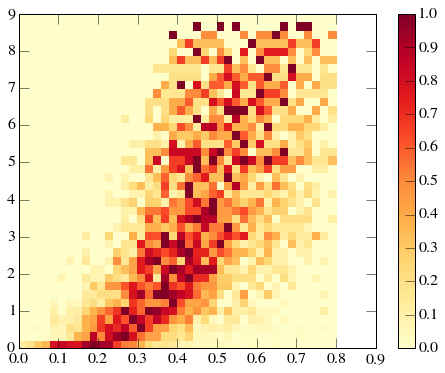

In [1040]:
_ = plot_histogram2d(df=df.dropna(subset=['xsec_8_ggf_h1_2a1_4tau']), 
                     yvar='xsec_8_ggf_h1_2a1_4tau', xvar='kap_lam', 
                     range=[[0, 0.8],[0, 9]], 
                     bins=[40,40],
#                      norm=LogNorm(),
                     norm_axis='y',
                     cmap='YlOrRd')

(<matplotlib.axes._subplots.AxesSubplot at 0x183cf2ed0>,
 <matplotlib.collections.PathCollection at 0x18577c390>)

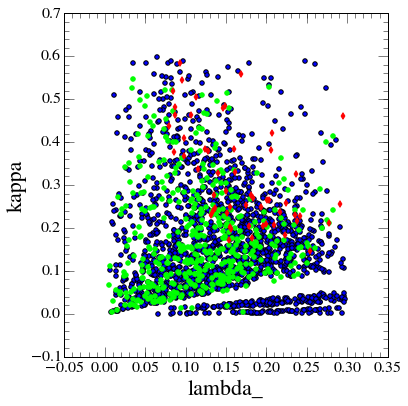

In [1049]:
plot_scatter(df=df[(df.constraints.str.contains('Relic'))&(df.constraints.str.contains('Muon'))], 
             xvar='lambda_', yvar='kappa')
plot_scatter(ax=plt.gca(), df=df[df.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
             xvar='lambda_', yvar='kappa', color='lime', label='Pass')
plot_scatter(ax=plt.gca(), df=df[df.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'].query('not pass_limits_xsec_8_ggf_h1_2a1_4tau'), 
             xvar='lambda_', yvar='kappa', color='red', marker='d', label='Fail')

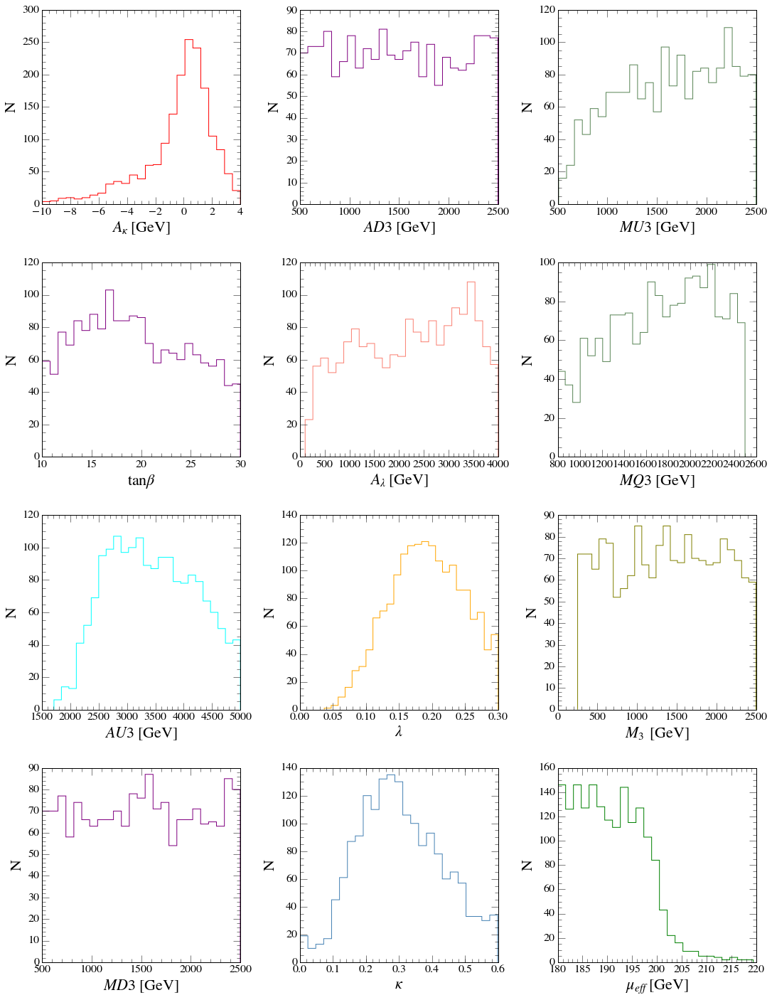

In [1076]:
plot_input_params_hists(df.query('not pass_limits_xsec_8_ggf_h1_2a1_4tau'),
                        ylabel='N', title='',
                        param_dict=nmssm_params_extended,
                        errorbars=False,
                        histtype='step', bins=25)


In [1165]:
from pprint import pprint

In [1466]:
@save_fig
def plot_hist_pass_fail(df, var, ratio=True, title='', **kwargs):
    if ratio:
        fig = generate_fig(size=[8, 10])
        ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=3, rowspan=2)
        plt.subplots_adjust(hspace=0)
    else:
        fig, ax1 = generate_fig_axes()
        
    n, bins, patches = ax1.hist([df.query('pass_limits_xsec_8_ggf_h1_2a1_4tau')[var].values, 
                                df.query('not pass_limits_xsec_8_ggf_h1_2a1_4tau')[var].values],
                               bins=25, #range=nmssm_params_extended[var].range,
                               color=['dodgerblue', 'red'], linewidth=2, 
                               histtype='barstacked', rwidth=1,
                               label=['Survive new limits', 'Excluded by new limits'])
    # hacky styling :(((
    for p in patches[0].patches:
        p.__dict__['_hatch'] = r'\\'

    for p in patches[1].patches:
        p.__dict__['_hatch'] = '///'

    ax1.set_ylabel('N')
    ax1.set_ylim(top=plt.ylim()[1] * 1.25) # hack spacing to get legend in there
    ax1.minorticks_on()
    
    plt.legend(loc='best', frameon=False)    
    plt.suptitle(title)
    
    if not ratio:
        if var in nmssm_params_extended:
            ax1.set_xlabel(nmssm_params_extended[var].label)
        elif 'xlabel' in kwargs:
            ax1.set_xlabel(kwargs['xlabel'])
        else:
            ax1.set_xlabel(var)

    if ratio:
        plt.setp(ax1.get_xticklabels(), visible=False)

        ax2 = plt.subplot2grid((3, 3), (2, 0), colspan=3)
        
        ratios = n[1] / (n[0] + n[1])  # if NOT stacked
        ratios = (n[1] - n[0]) / (n[1])  # if stacked
        centers = [0.5*(bins[i] + bins[i+1]) for i, _ in enumerate(bins[:-1])]
        ax2.plot(centers, ratios, 'o')

        mean_excluded = n[1].sum()/(n[0].sum() + n[1].sum()) # if NOT stacked
        mean_excluded = (n[1].sum()-n[0].sum())/n[1].sum() # if stacked
        ax2.plot([bins[0], bins[-1]], [mean_excluded, mean_excluded], 
                 linewidth=2, linestyle='dashed', label='Total excluded fraction')
        
        ax2.set_ylim(0, min(1, ratios.max() * 1.25))
        ax2.set_ylabel('Fraction of\npoints excluded')
        if var in nmssm_params_extended:
            ax2.set_xlabel(nmssm_params_extended[var].label)
        elif 'xlabel' in kwargs:
            ax2.set_xlabel(kwargs['xlabel'])
        else:
            ax2.set_xlabel(var)

        ax2.grid(which='major')
        
    plt.legend(loc='best', frameon=False, fontsize=16)    

In [1432]:
df_s = df[df.constraints=='b -> c tau nu more than 2 sigma away (as SM)']

Setting backend pdf
Setting backend png


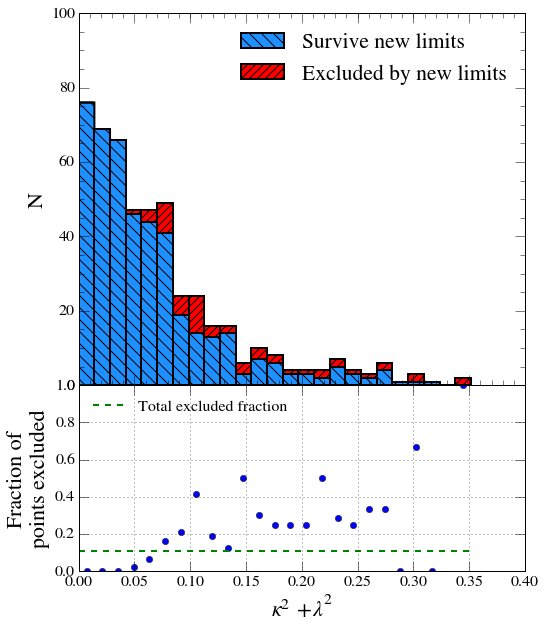

In [1470]:
plot_hist_pass_fail(df_s, 'kap_lam_sq', xlabel=r'$\kappa^2 + \lambda^2$', 
                    filename='Thesis_plots_4/New_Limits/kappa_lambda_sq_hist_passfail.pdf')

Setting backend pdf
Setting backend png


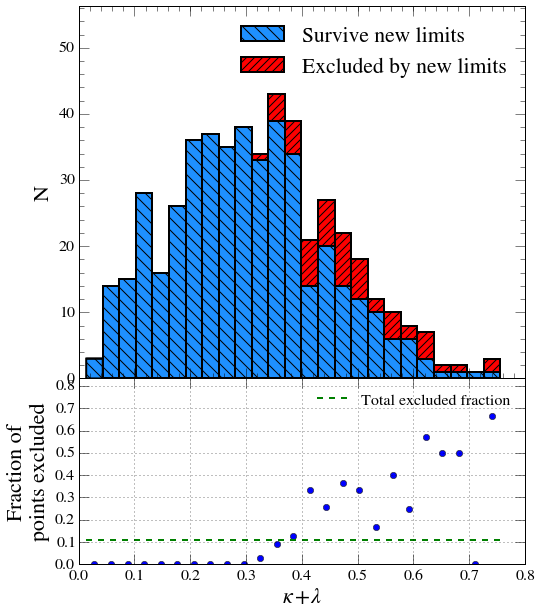

In [1468]:
plot_hist_pass_fail(df_s, 'kap_lam', xlabel=r'$\kappa + \lambda$', 
                    filename='Thesis_plots_4/New_Limits/kappa_lambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


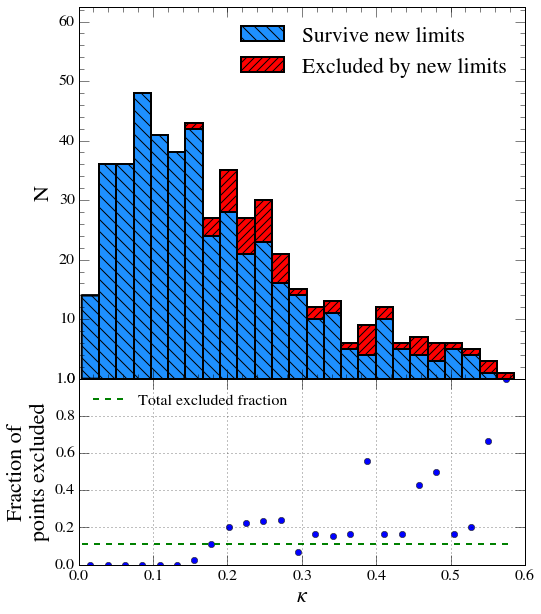

In [1454]:
plot_hist_pass_fail(df_s, 'kappa', filename='Thesis_plots_4/New_Limits/kappa_hist_passfail.pdf')

Setting backend pdf
Setting backend png


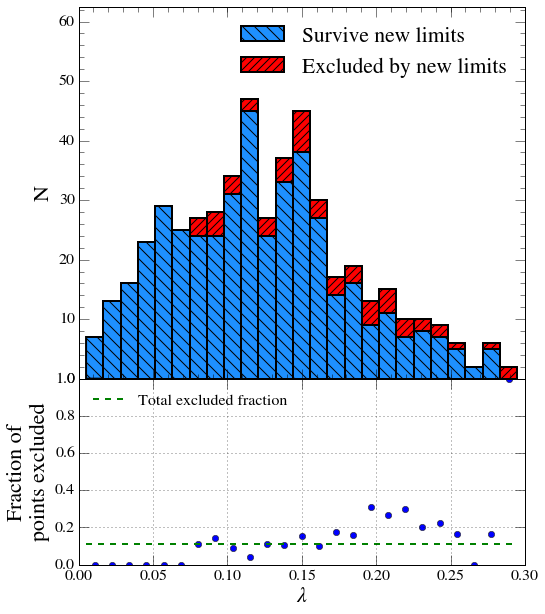

In [1455]:
plot_hist_pass_fail(df_s, 'lambda_', filename='Thesis_plots_4/New_Limits/lambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


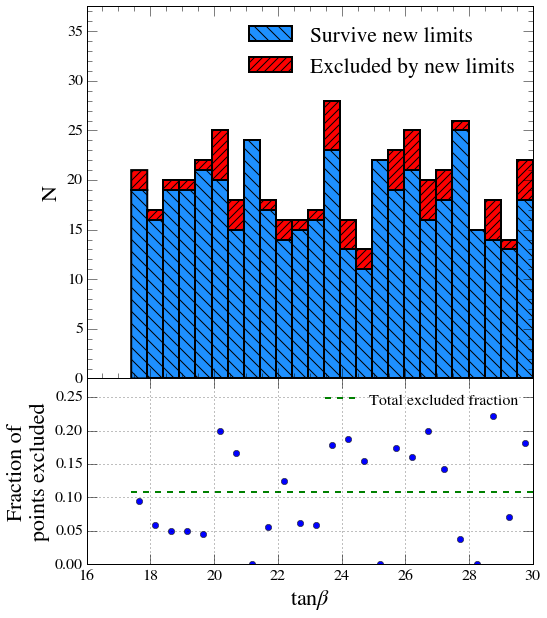

In [1456]:
plot_hist_pass_fail(df_s, 'tgbeta', filename='Thesis_plots_4/New_Limits/tgbeta_hist_passfail.pdf')

Setting backend pdf
Setting backend png


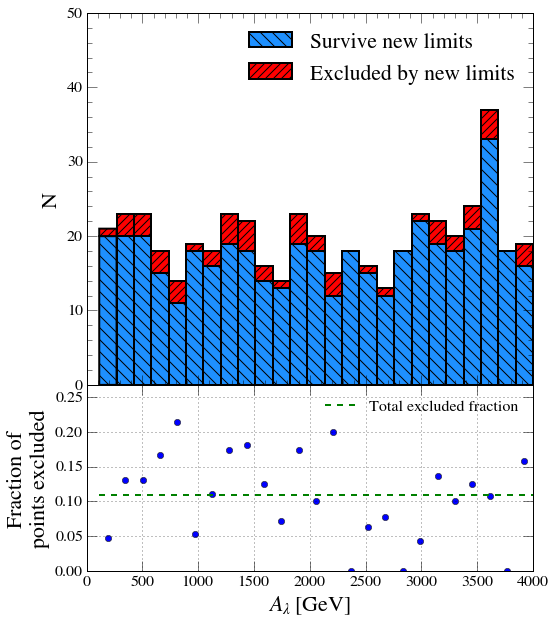

In [1457]:
plot_hist_pass_fail(df_s, 'alambda', filename='Thesis_plots_4/New_Limits/alambda_hist_passfail.pdf')

Setting backend pdf
Setting backend png


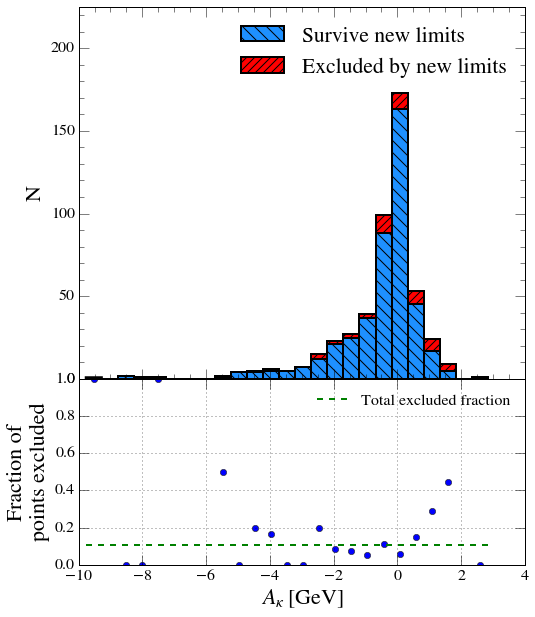

In [1458]:
plot_hist_pass_fail(df_s, 'akappa', filename='Thesis_plots_4/New_Limits/akappa_hist_passfail.pdf')

Setting backend pdf
Setting backend png


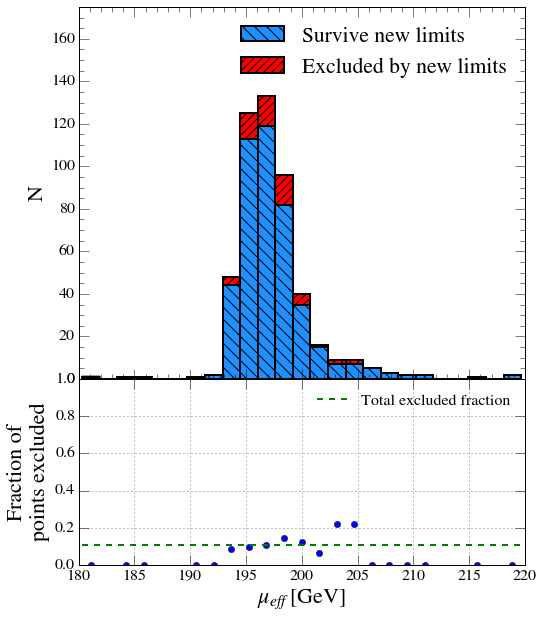

In [1459]:
plot_hist_pass_fail(df_s, 'mueff', filename='Thesis_plots_4/New_Limits/mueff_hist_passfail.pdf')

Setting backend pdf
Setting backend png


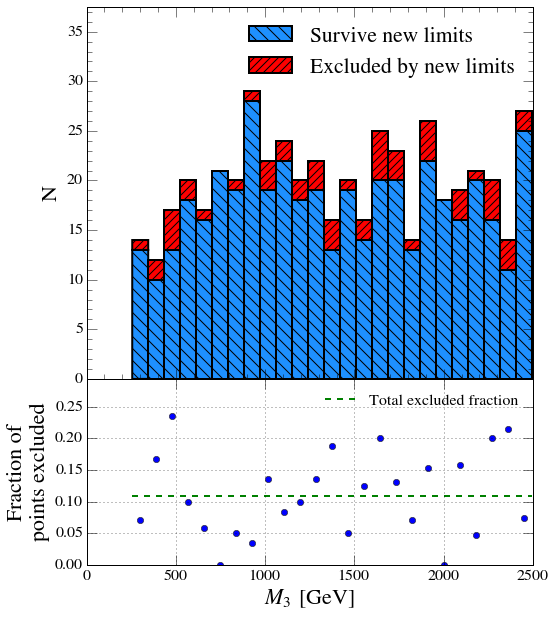

In [1460]:
plot_hist_pass_fail(df_s, 'm3', filename='Thesis_plots_4/New_Limits/m3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


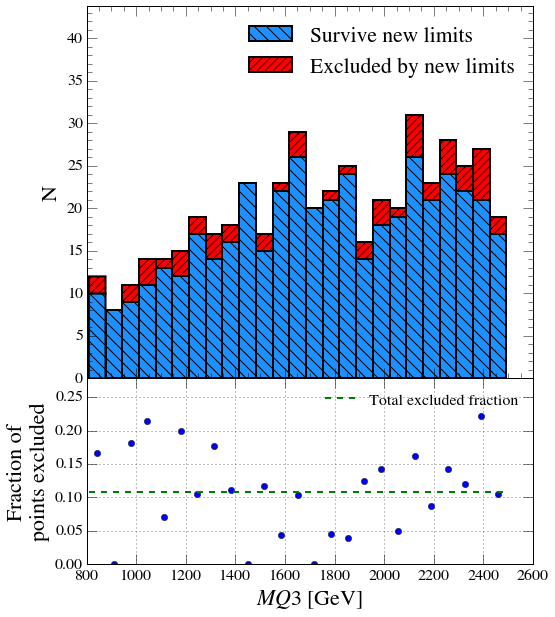

In [1461]:
plot_hist_pass_fail(df_s, 'mq3', filename='Thesis_plots_4/New_Limits/mq3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


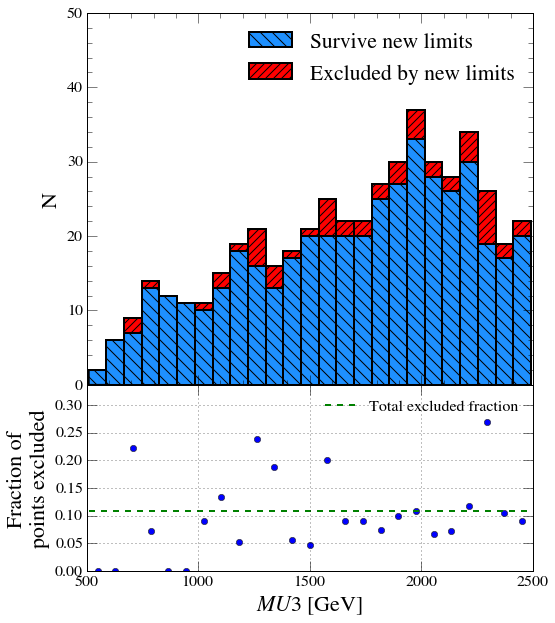

In [1462]:
plot_hist_pass_fail(df_s, 'mu3', filename='Thesis_plots_4/New_Limits/mu3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


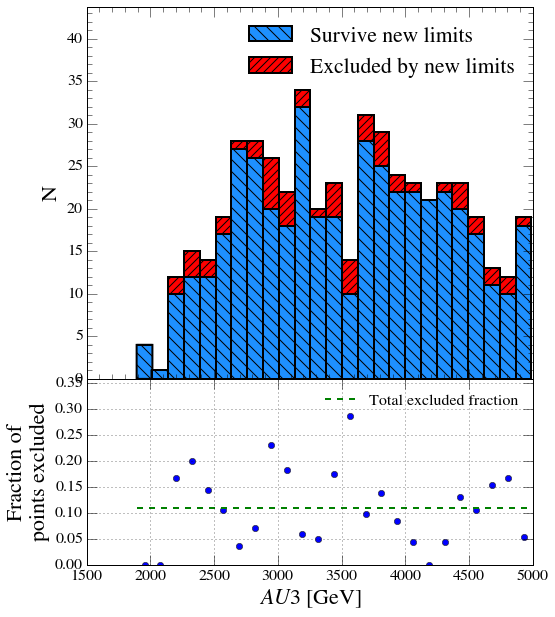

In [1463]:
plot_hist_pass_fail(df_s, 'au3', filename='Thesis_plots_4/New_Limits/au3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


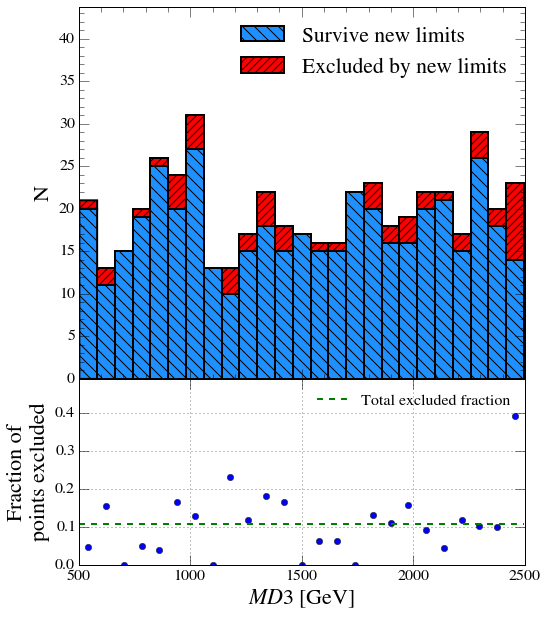

In [1464]:
plot_hist_pass_fail(df_s, 'md3', filename='Thesis_plots_4/New_Limits/md3_hist_passfail.pdf')

Setting backend pdf
Setting backend png


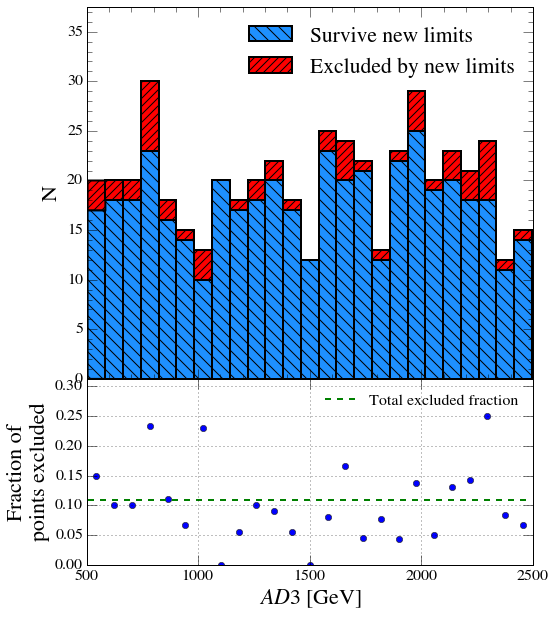

In [1465]:
plot_hist_pass_fail(df_s, 'ad3', filename='Thesis_plots_4/New_Limits/ad3_hist_passfail.pdf')

# Non-Higgs Experimental Constraints

## Relic density, $\Omega h^2$

Setting backend png
Setting backend png


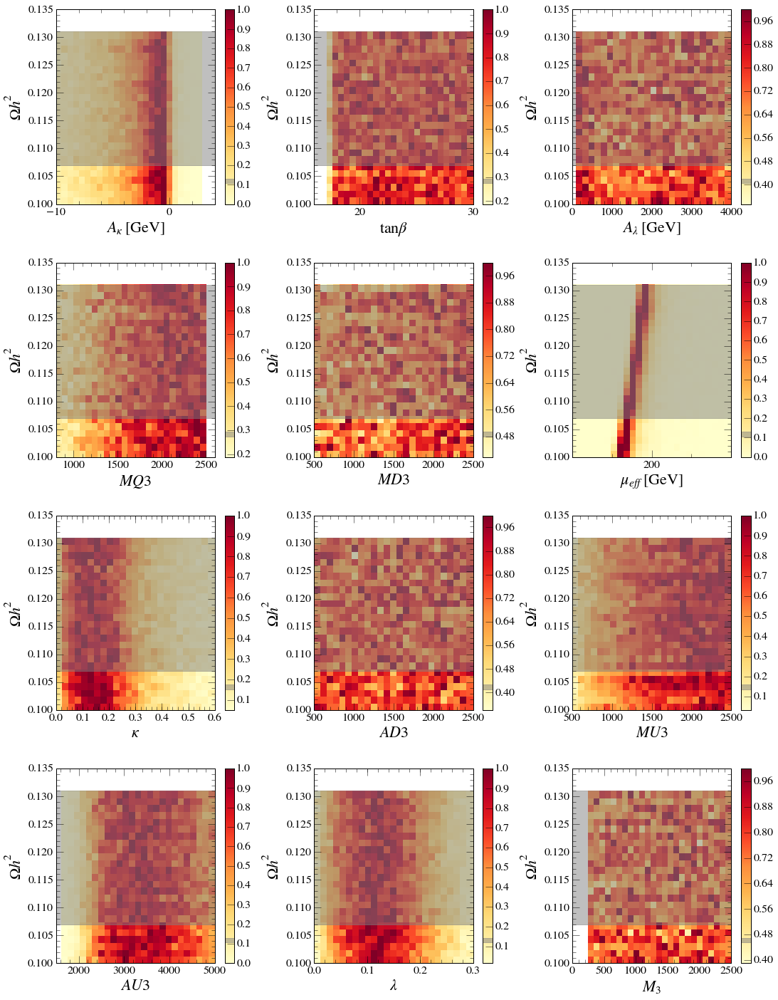

In [629]:
@save_fig
def plot_omega_input_hist2d(df):
    plot_input_params_hist2d(df=df.query('0.1 < omega < 0.14'), 
                             yvar='omega', ylabel=r'$\Omega h^2$', 
                             param_dict=nmssm_params_extended,
                             cmap=plt.get_cmap('YlOrRd'), 
                             norm_axis='y')
                             #, norm=LogNorm(vmin=1E-3))
    for ax in plt.gcf().axes:
        make_highlight_region(ax, OMEGA_LIM, 'Y')
        
plot_omega_input_hist2d(df_pass_all[(df_pass_all.constraints == 'Relic density too small (Planck)|b -> c tau nu more than 2 sigma away (as SM)') | 
                                     (df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)')],
                        filename='Thesis_plots_4/Exp_cons/omega_input_hist2d.png')

Setting backend png
Setting backend png


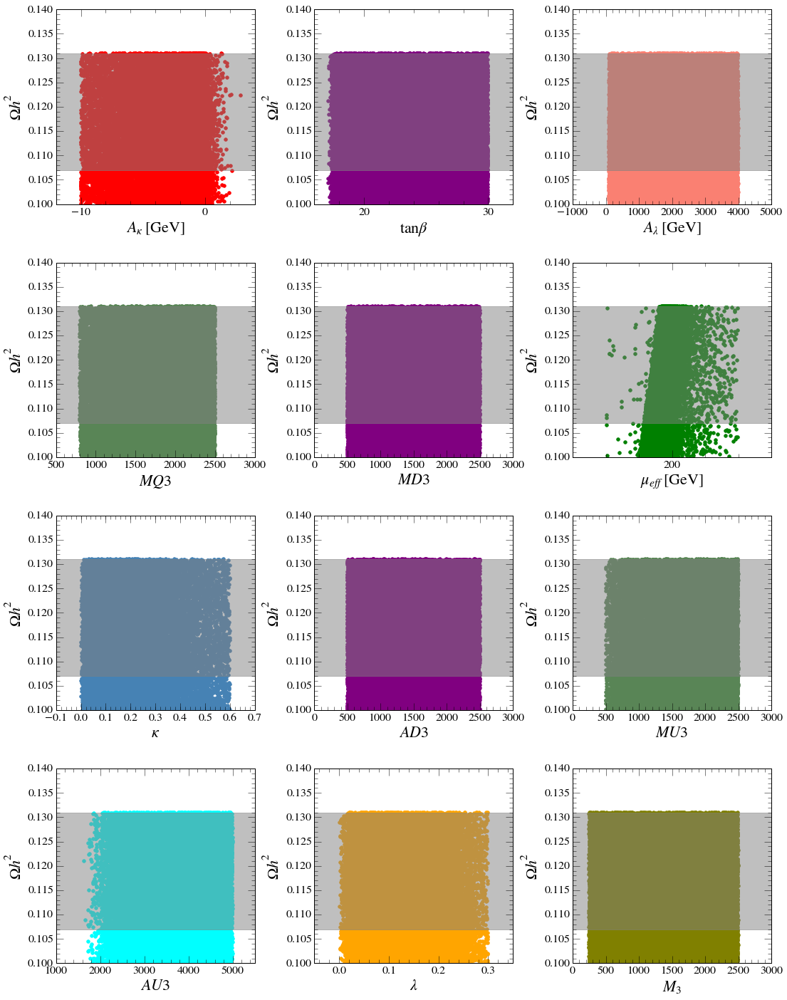

In [630]:
@save_fig
def plot_omega_input_scatter(df):
    plot_input_params_scatters(df=df.query('0.1 < omega < 0.14'), 
                               yvar='omega', ylabel=r'$\Omega h^2$', 
                               yrange=[0.1, 0.14],
                               param_dict=nmssm_params_extended)
    for ax in plt.gcf().axes:
        make_highlight_region(ax, OMEGA_LIM, 'Y')

plot_omega_input_scatter(df_pass_all[(df_pass_all.constraints == 'Relic density too small (Planck)|b -> c tau nu more than 2 sigma away (as SM)') | 
                                     (df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)')], 
                         filename='Thesis_plots_4/Exp_cons/omega_input_scatter.png')

Setting backend png
Setting backend png


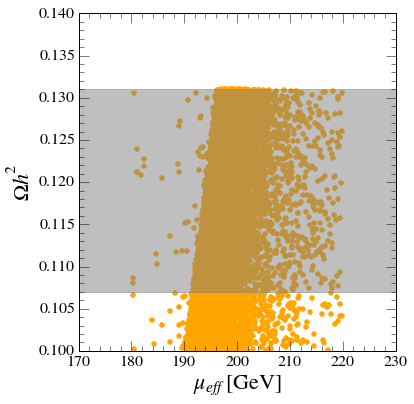

In [631]:
@save_fig
def plot_omega_mueff_scatter(df):
    plot_scatter(df=df.query('0.1 < omega < 0.14'), 
                 xvar='mueff', yvar='omega', 
                 xlabel=MUEFF_STR, ylabel=OMEGA_STR,
                 color='orange')
    plt.ylim(0.1, 0.14)
    make_highlight_region(plt.gca(), OMEGA_LIM, 'Y')
        
plot_omega_mueff_scatter(df_pass_all[(df_pass_all.constraints == 'Relic density too small (Planck)|b -> c tau nu more than 2 sigma away (as SM)') | 
                                     (df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)')],
                         filename='Thesis_plots_4/Exp_cons/omega_mueff_scatter.png')

Setting backend png
Setting backend png


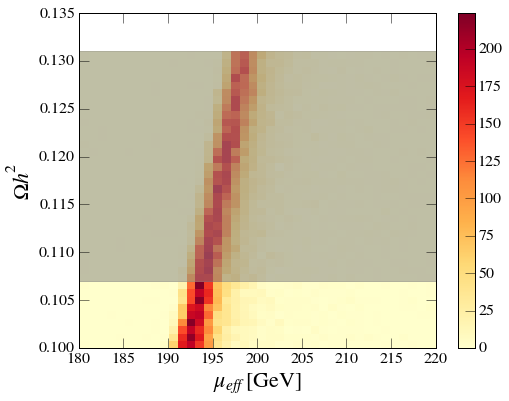

In [632]:
@save_fig
def plot_omega_mueff_hist2d(df):
    plot_histogram2d(df=df.query('0.1 < omega<0.14'), 
                     xvar='mueff', yvar='omega', 
                     xlabel=MUEFF_STR, ylabel=OMEGA_STR,
                     cmap='YlOrRd', bins=[40, 40])
    make_highlight_region(plt.gca(), OMEGA_LIM, 'Y')
        
plot_omega_mueff_hist2d(df_pass_all[(df_pass_all.constraints == 'Relic density too small (Planck)|b -> c tau nu more than 2 sigma away (as SM)') | 
                                     (df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)')],
                        filename='Thesis_plots_4/Exp_cons/omega_mueff_hist2d.png')

## $\Delta a_{\mu}$

Setting backend png
Setting backend png


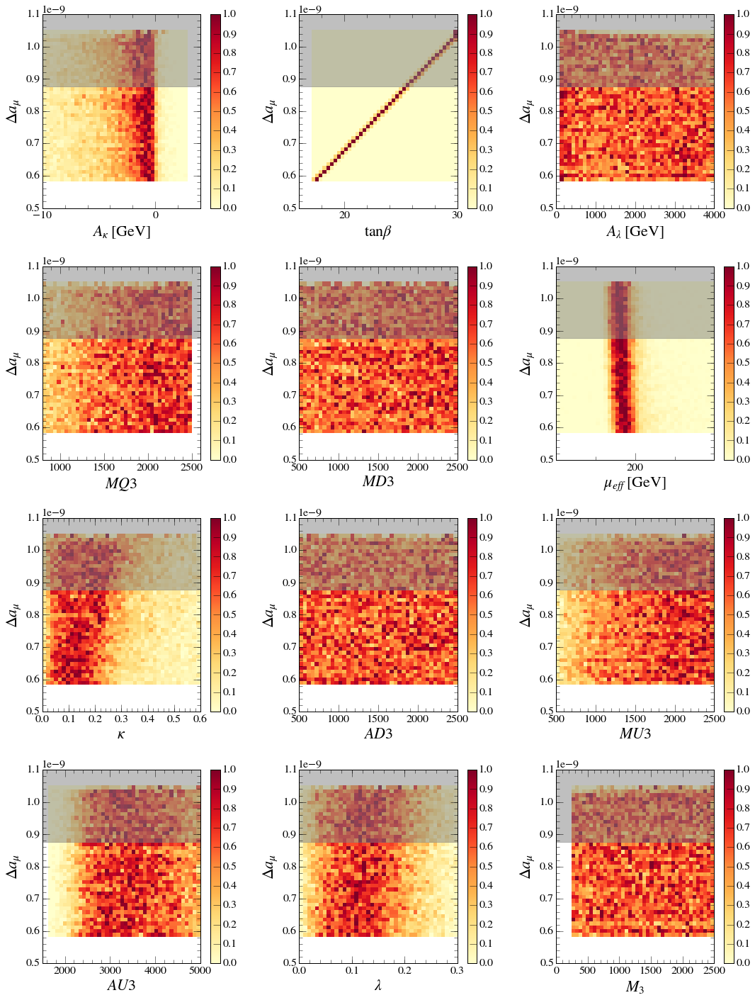

In [560]:
@save_fig
def plot_del_a_mu_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='Del_a_mu',
                             ylabel=DEL_A_MU_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', 
                             norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
    #                          norm=Normalize(vmin=0, vmax=1), 
                             bins=[40,40])
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [8.77E-10, 4.61E-9], 'Y')

plot_del_a_mu_input_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                           filename='Thesis_plots_4/Exp_cons/del_a_mu_input_hist2d.png')

Setting backend png
Setting backend png


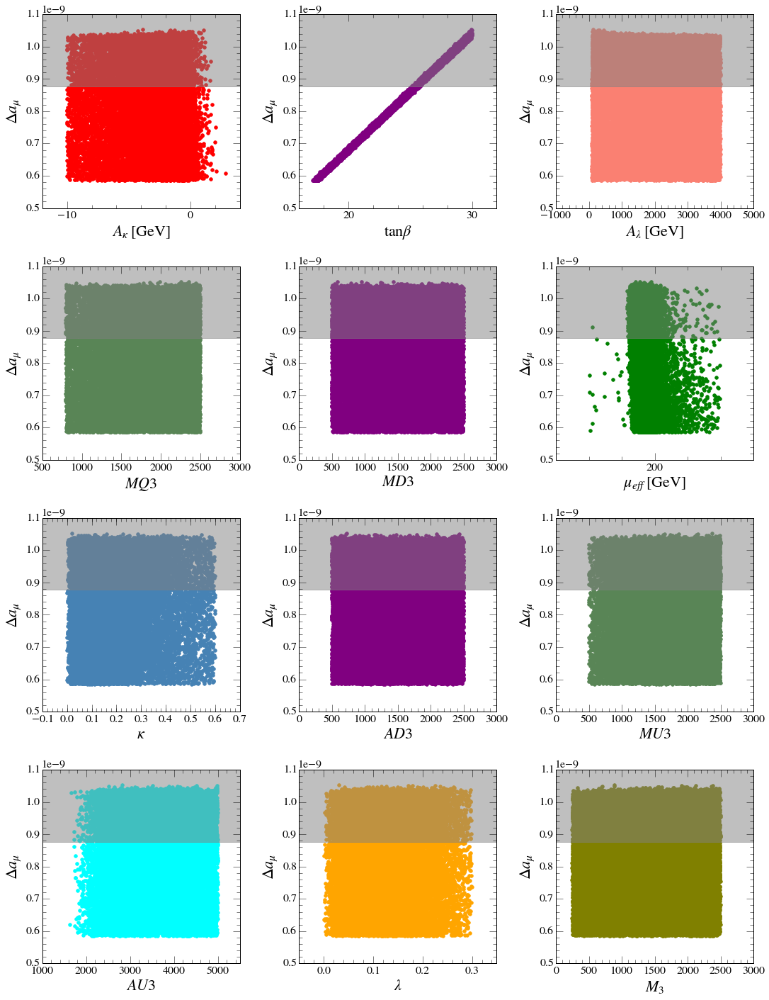

In [553]:
@save_fig
def plot_del_a_mu_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               ylabel=DEL_A_MU_STR,
                               yvar='Del_a_mu', yrange=[0.5E-9, 1.1E-9],
                               param_dict=nmssm_params_extended)
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [8.77E-10, 4.61E-9], 'Y')
        
plot_del_a_mu_input_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                           filename='Thesis_plots_4/Exp_cons/del_a_mu_input_scatter.png')

Setting backend pdf
Setting backend png


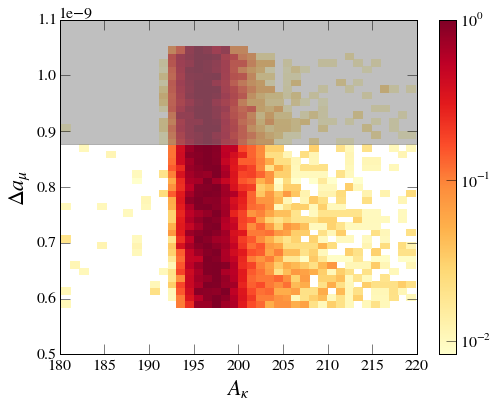

In [579]:
@save_fig
def plot_del_a_mu_kappa_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='mueff', yvar='Del_a_mu', 
    #                      range=[[2, 10], [0, 0.7E-8]], 
                         bins=[40, 40], 
                         norm_axis='y', 
                         cmap=plt.get_cmap('YlOrRd'), 
                         norm=LogNorm(),
                         xlabel=r'$A_{\kappa}$', ylabel=r'$\Delta a_{\mu}$')

    make_highlight_region(plt.gca(), [8.77E-10, 4.61E-9], 'Y')
    
plot_del_a_mu_kappa_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                           filename='Thesis_plots_4/Exp_cons/del_a_mu_kappa_hist2d.pdf')

Setting backend pdf
Setting backend png


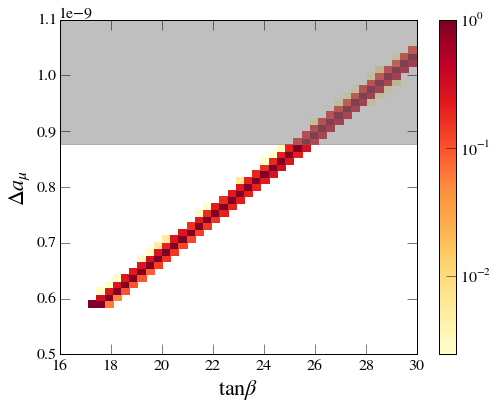

In [554]:
@save_fig
def plot_del_a_mu_tgbeta_hist2d(df):
    _ = plot_histogram2d(df=df, xvar='tgbeta', yvar='Del_a_mu', 
    #                      range=[[2, 10], [0, 0.7E-8]], 
                         bins=[40, 40], 
                         norm_axis='x', 
                         cmap=plt.get_cmap('YlOrRd'), 
                         norm=LogNorm(),
                         xlabel=r'$\tan\beta$', ylabel=r'$\Delta a_{\mu}$')

    make_highlight_region(plt.gca(), [8.77E-10, 4.61E-9], 'Y')
        
plot_del_a_mu_tgbeta_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                            filename='Thesis_plots_4/Exp_cons/del_a_mu_tgbeta_hist2d.pdf')

Setting backend pdf
Setting backend png


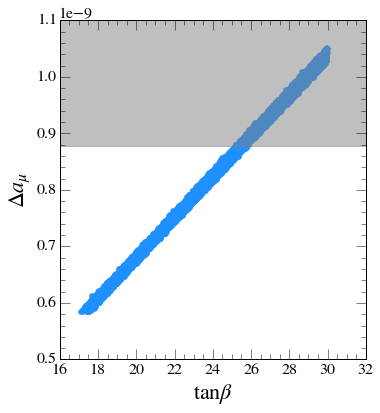

In [558]:
@save_fig
def plot_del_a_mu_tgbeta_scatter(df):
    _ = plot_scatter(df=df, xvar='tgbeta', yvar='Del_a_mu', 
                     xlabel=r'$\tan\beta$', ylabel=r'$\Delta a_{\mu}$',
                     color='dodgerblue')

    plt.ylim(0.5E-9, 1.1E-9)
    make_highlight_region(plt.gca(), [8.77E-10, 4.61E-9], 'Y')
        
plot_del_a_mu_tgbeta_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                             filename='Thesis_plots_4/Exp_cons/del_a_mu_tgbeta_scatter.png')


## $B_S \to \mu\mu$

Setting backend png
Setting backend png


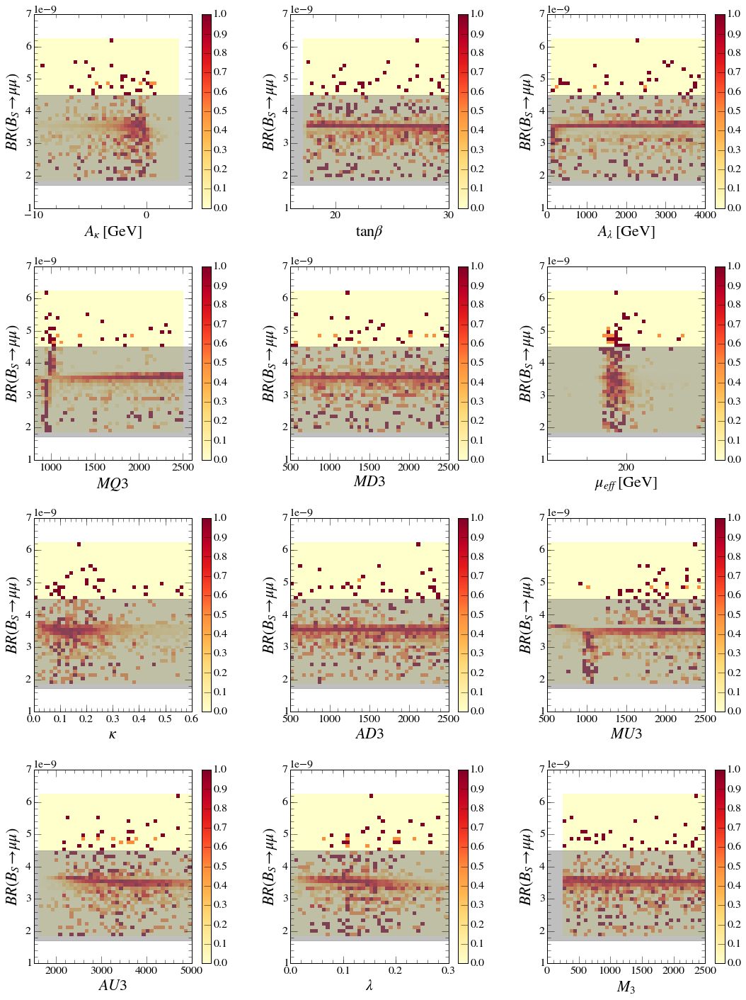

In [559]:
@save_fig
def plot_bsmumu_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='bsmumu',
                             ylabel=BSMUMU_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
    #                          norm=Normalize(vmin=0, vmax=1), 
                             bins=[40,40])
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [1.72E-9, 4.5E-9], 'Y')

plot_bsmumu_input_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                         filename='Thesis_plots_4/Exp_cons/bsmumu_input_hist2d.png')

Setting backend png
Setting backend png


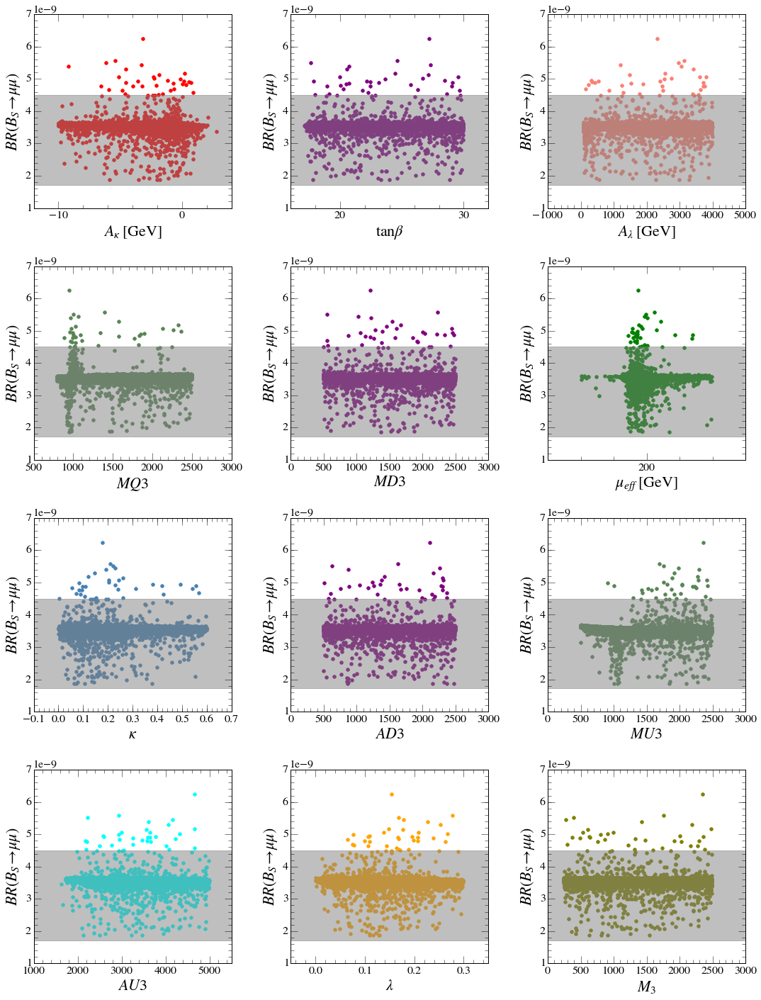

In [566]:
@save_fig
def plot_bsmumu_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               yvar='bsmumu',
                               ylabel=BSMUMU_STR, 
                               yrange=[1E-9, 7E-9],
                               param_dict=nmssm_params_extended)
    
    for ax in plt.gcf().axes:
        make_highlight_region(ax, [1.72E-9, 4.5E-9], 'Y')

plot_bsmumu_input_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                          filename='Thesis_plots_4/Exp_cons/bsmumu_input_scatter.png')

Setting backend png
Setting backend png


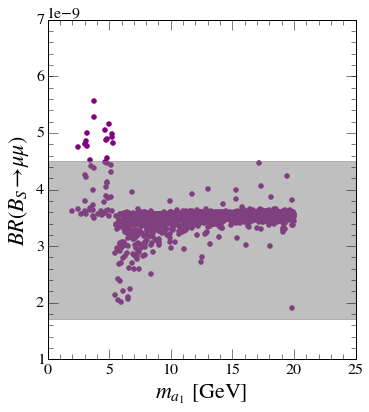

In [573]:
@save_fig
def plot_bsmumu_ma1_scatter(df):
    plot_scatter(df=df.query('ma1<20'),
                 xvar='ma1',
                 yvar='bsmumu',
                 xlabel=M_A1_STR,
                 ylabel=BSMUMU_STR,
                 color='purple')
    plt.ylim([1E-9, 7E-9])

    make_highlight_region(plt.gca(), [1.72E-9, 4.5E-9], 'Y')


plot_bsmumu_ma1_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                        filename='Thesis_plots_4/Exp_cons/bsmumu_ma1_scatter.png')

Setting backend png
Setting backend png


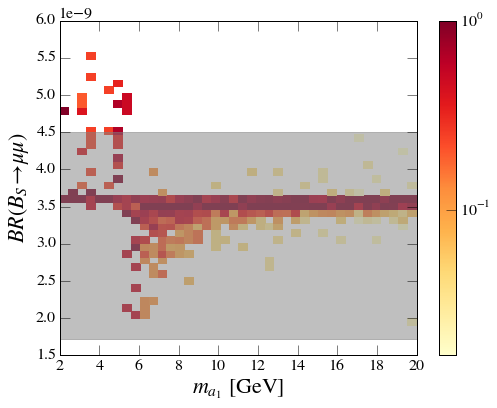

In [583]:
@save_fig
def plot_bsmumu_ma1_hist2d(df):
    plot_histogram2d(df=df.query('ma1<20'),
                     xvar='ma1',
                     yvar='bsmumu',
                     xlabel=M_A1_STR,
                     ylabel=BSMUMU_STR,
                     cmap='YlOrRd',
                     norm_axis='x',
                     bins=[40, 40],
                     norm=LogNorm())
#     plt.ylim([1E-9, 7E-9])

    make_highlight_region(plt.gca(), [1.72E-9, 4.5E-9], 'Y')


plot_bsmumu_ma1_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'],
                        filename='Thesis_plots_4/Exp_cons/bsmumu_ma1_hist2d.png')

## R(D), R(D*)

Setting backend png
Setting backend png


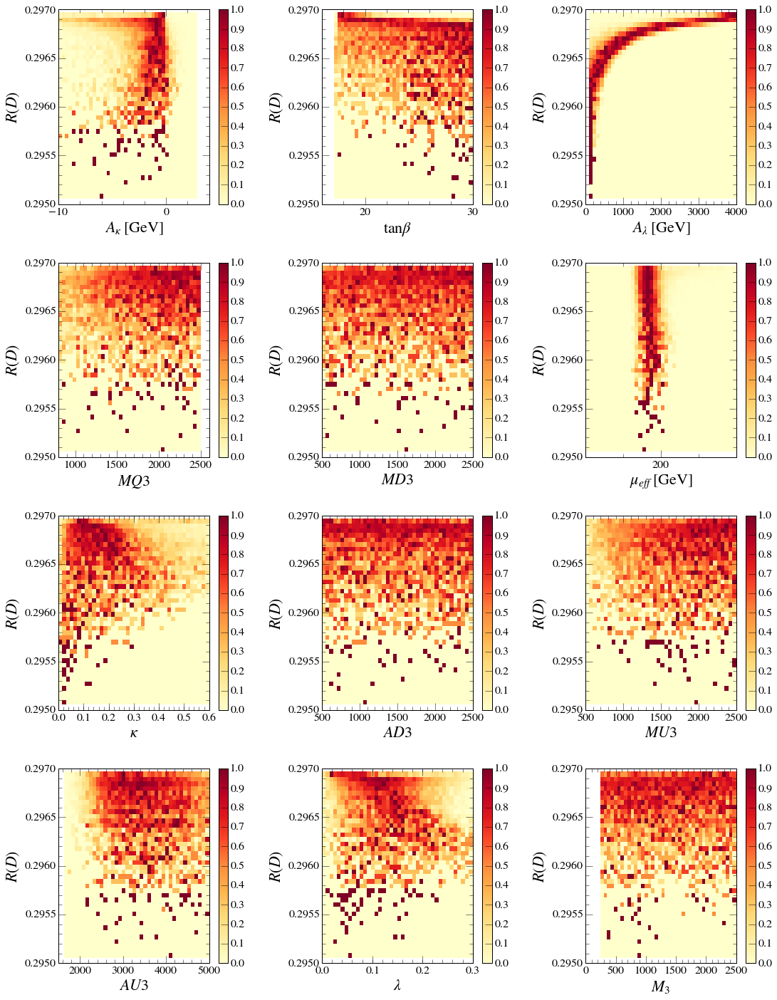

In [603]:
@save_fig
def plot_rd_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='rd',
                             ylabel=RD_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
#                              norm=LogNorm(vmin=1E-2), 
                             bins=[40,40])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RD_LIM, 'Y')

plot_rd_input_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                     filename='Thesis_plots_4/Exp_cons/rd_input_hist2d.png')

Setting backend png
Setting backend png


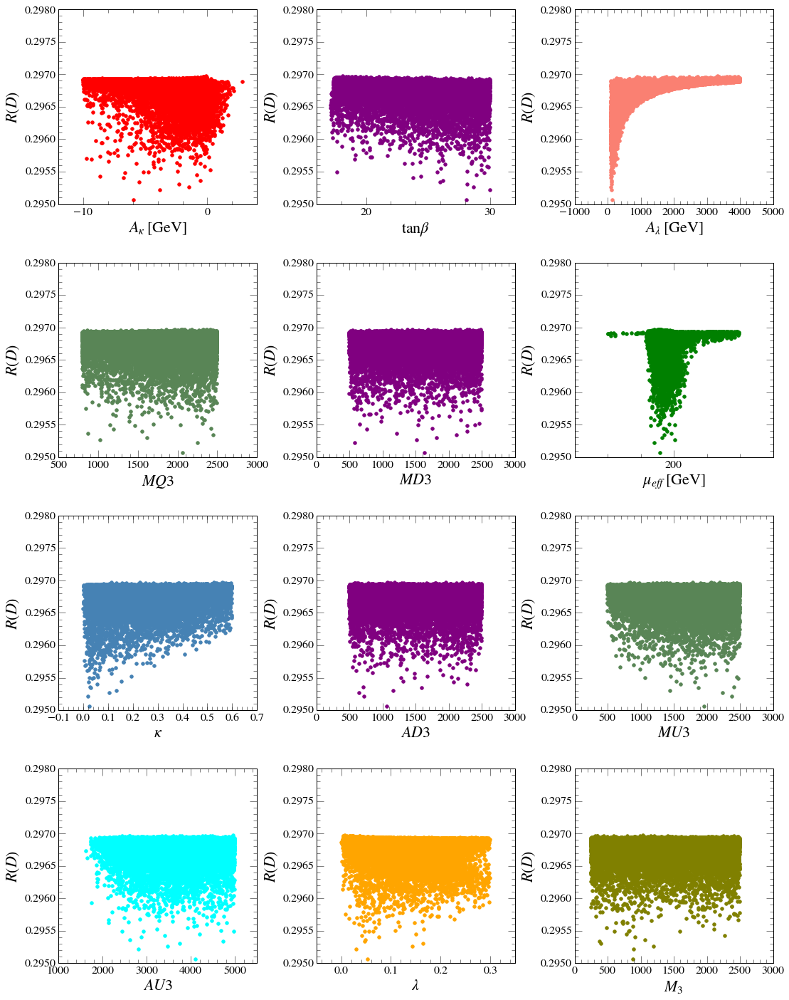

In [595]:
@save_fig
def plot_rd_input_scatter(df):
    plot_input_params_scatters(df=df, 
                               yvar='rd',
                               ylabel=RD_STR, 
                               yrange=[0.295, 0.298],
                               param_dict=nmssm_params_extended)
    
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RD_LIM, 'Y')

plot_rd_input_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                     filename='Thesis_plots_4/Exp_cons/rd_input_scatter.png')

Setting backend png
Setting backend png


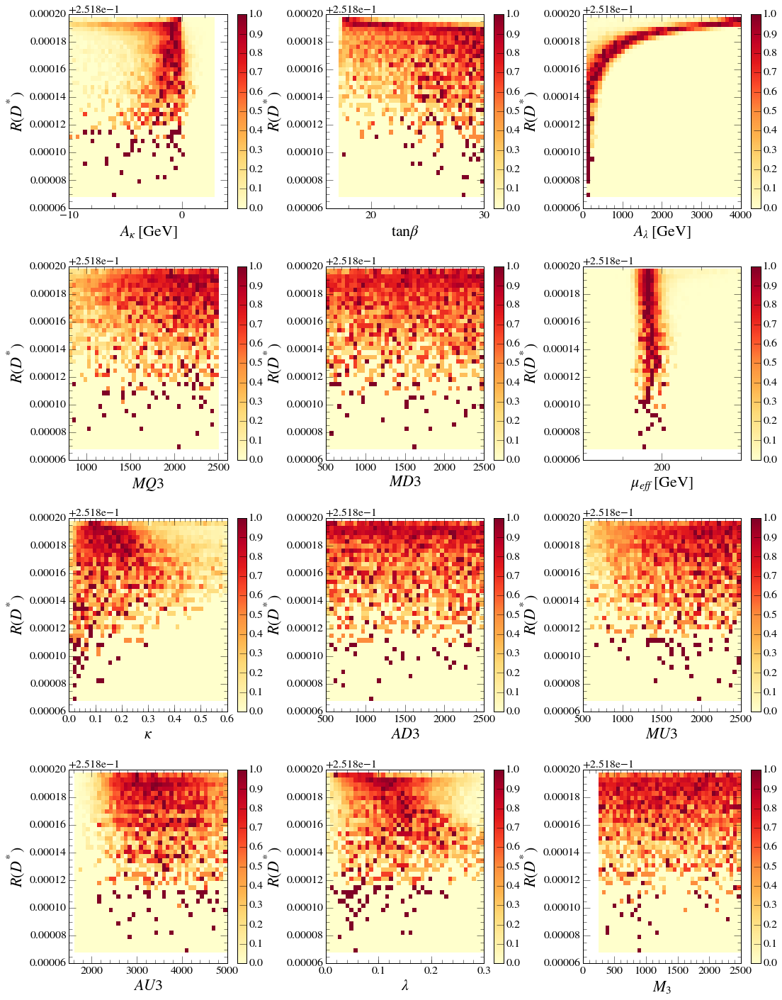

In [596]:
@save_fig
def plot_rds_input_hist2d(df):
    plot_input_params_hist2d(df=df, 
                             yvar='rds',
                             ylabel=RDS_STR, 
                             param_dict=nmssm_params_extended,
                             cmap='YlOrRd', norm_axis='y',
    #                          norm=LogNorm(vmin=1E-3), 
                             bins=[40,40])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RDS_LIM, 'Y')

plot_rds_input_hist2d(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                     filename='Thesis_plots_4/Exp_cons/rds_input_hist2d.png')

Setting backend png
Setting backend png


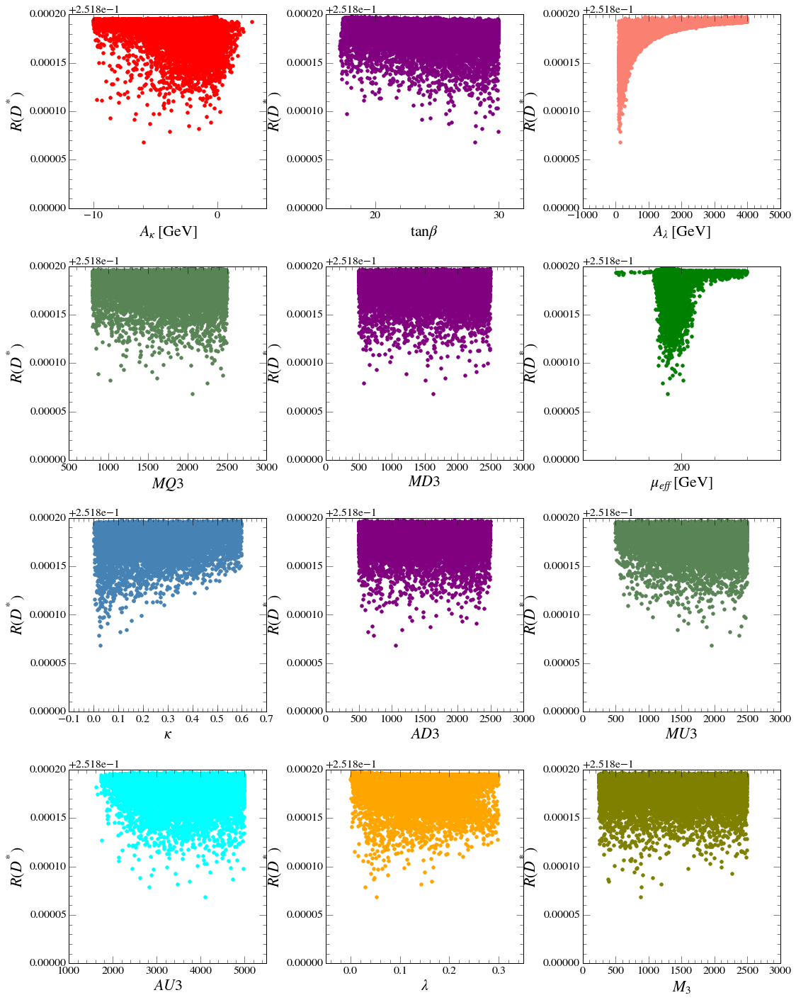

In [600]:
@save_fig
def plot_rds_input_scatter(df):
    plot_input_params_scatters(df=df, 
                              yvar='rds',
                              ylabel=RDS_STR, 
                              param_dict=nmssm_params_extended,
                              yrange=[0.2518, 0.252])
#     for ax in plt.gcf().axes:
#         make_highlight_region(ax, RDS_LIM, 'Y')

plot_rds_input_scatter(df_pass_all[df_pass_all.constraints == 'b -> c tau nu more than 2 sigma away (as SM)'], 
                       filename='Thesis_plots_4/Exp_cons/rds_input_scatter.png')